# DishVision: Computer Vision Multi-Class Image Classifier Project

This end-to-end project showcases the implementation of several deep learning models and computer vision experiments, focused on classifying images of three different food classes using PyTorch. This comprehensive approach covers all critical stages of a machine learning pipeline, including data structuring, preprocessing, data splitting, model selection, model training, evaluation, optimization, prediction, saving, comparison, analysis, and deployment. The project also features a detailed replication of the Vision Transformer (ViT) architecture from a prominent machine learning research paper, highlighting both the potential and challenges of this cutting-edge approach.

Through meticulous experimentation and leveraging the power of transfer learning, the optimal model was achieved, which attains over **96+%** accuracy on the test set. This model, with its high accuracy, fast prediction time and compact size, is ideal for deployment on mobile devices. The use of TensorBoard for visualization and analysis further enhances the project by providing clear insights into model performance. This deployed model can be accessed on Hugging Face [here](https://huggingface.co/spaces/IsraelAzoulay/DishVision).

By following this comprehensive notebook, you will gain insights into advanced deep learning methodologies, practical deployment strategies, and the intricate nuances of advancing computational precision. Each step is meticulously detailed to ensure clarity and facilitate a deeper understanding of modern computer vision techniques.

## Instructions for Running the Notebook
**1. Clone the Repository:** Ensure you have cloned the repository to your local machine or directly open it in Google Colab.

**2. Dataset Preparation:** The datasets used in this notebook have been preprocessed in the 'Structuring_the_Food101_Dataset' notebook, part of this project. These datasets are stored in the 'data' directory of the project's GitHub repository and can be accessed and downloaded directly from the provided links within the notebook.

**3. Dependencies:** Install the necessary libraries by executing the provided setup cells in the notebook.

**4. Execution:** Follow the cells sequentially to load the data, preprocess it, build the models, and evaluate their performance. Detailed explanations and code comments are provided for each step to facilitate understanding and reproducibility.

**5. Helper Functions:** The project includes a file named 'helper_functions.py' stored in the 'helpers' folder in the GitHub repository. This file contains utility functions essential for data visualization, data processing and more, and is imported into this notebook.

### PyTorch Version Checking & Device-Agnostic Code Setup


In [1]:
import torch
from torch import nn

torch.__version__

'2.3.1+cu121'

In [2]:
device = "cuda" if torch.cuda.is_available() else "cpu"
device

'cuda'

### GPU Checking

In [3]:
!nvidia-smi

Sun Jul 28 19:45:51 2024       
+---------------------------------------------------------------------------------------+
| NVIDIA-SMI 535.104.05             Driver Version: 535.104.05   CUDA Version: 12.2     |
|-----------------------------------------+----------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |         Memory-Usage | GPU-Util  Compute M. |
|                                         |                      |               MIG M. |
|=========================================+======================+======================|
|   0  Tesla T4                       Off | 00000000:00:04.0 Off |                    0 |
| N/A   55C    P8              10W /  70W |      3MiB / 15360MiB |      0%      Default |
|                                         |                      |                  N/A |
+-----------------------------------------+----------------------+--

### Get the Data (10% of the dataset)

PyTorch offers a comprehensive suite of built-in datasets and functions for loading various custom datasets across its domain libraries, including ‘TorchVision’, ‘TorchText’, ‘TorchAudio’, and ‘TorchRec’. For this project, we will utilize ‘torchvision.datasets’ alongside a custom ‘Dataset’ class to import images of food.

Specifically, we will employ the ‘food-101’ dataset available in ‘torchvision.datasets’. Best practices dictate starting with a subset of the original dataset to expedite experimentation. Therefore, we will initially work with preprocessed subsets of the original dataset, as detailed in the 'Structuring_the_Food101_Dataset' notebook available in the project's Github repository. This approach facilitates faster experimental iterations and optimizes model development.

The full ‘food-101’ dataset encompasses 101 classes with complete data coverage. However, for the preliminary experiments with 'model_0' and 'model_1', we will focus on a **10%** subset of the dataset, restricted to 3 classes - sushi, pizza, and steak:



In [4]:
import requests
import zipfile
from pathlib import Path


# URL to the dataset in the public GitHub repository
DATASET_URL_10_PERCENT = 'https://github.com/IsraelAzoulay/multi-class-image-classifier-computer-vision/raw/main/data/10_percent_dataset.zip'

# Defining the path to the dataset folder
data_path = Path("data/")
image_path = data_path / "pizza_steak_sushi"

# Verify the existence of the image folder. If it does not exist, proceed to download it
if image_path.is_dir():
    print(f"The {image_path} directory exists.")
else:
    print(f"Did not find the {image_path} directory. Creating one...")
    image_path.mkdir(parents=True, exist_ok=True)

    # Download the dataset
    with open(data_path / "pizza_steak_sushi.zip", "wb") as f:
        request = requests.get(DATASET_URL_10_PERCENT)
        print("Downloading the dataset...")
        f.write(request.content)

    # Unzip the dataset
    with zipfile.ZipFile(data_path / "pizza_steak_sushi.zip", "r") as zip_ref:
        print("Unzipping the dataset...")
        zip_ref.extractall(image_path)

Did not find the data/pizza_steak_sushi directory. Creating one...
Unzipping the dataset...


### Inspect the Data

To efficiently examine the contents of the data directory, we can create a helper function. This function will traverse each subdirectory and count the number of files within, providing a clear overview of the dataset structure:

In [5]:
import os

def walk_through_dir(dir_path):
  """
  This function traverses the 'dir_path' and returns its contents.

  Args:
    dir_path (str or pathlib.Path): target directory

  Returns:
    A print out of:
      The number of subdiretories in the 'dir_path'.
      The number of images (files) in each subdirectory.
      The name of each subdirectory.
  """
  for dirpath, dirnames, filenames in os.walk(dir_path):
    print(f"There are {len(dirnames)} directories and {len(filenames)} images in '{dirpath}'.")

In [6]:
# Display the contnent of the dataset
walk_through_dir(image_path)

There are 2 directories and 0 images in 'data/pizza_steak_sushi'.
There are 3 directories and 0 images in 'data/pizza_steak_sushi/test'.
There are 0 directories and 31 images in 'data/pizza_steak_sushi/test/sushi'.
There are 0 directories and 19 images in 'data/pizza_steak_sushi/test/steak'.
There are 0 directories and 25 images in 'data/pizza_steak_sushi/test/pizza'.
There are 3 directories and 0 images in 'data/pizza_steak_sushi/train'.
There are 0 directories and 72 images in 'data/pizza_steak_sushi/train/sushi'.
There are 0 directories and 75 images in 'data/pizza_steak_sushi/train/steak'.
There are 0 directories and 78 images in 'data/pizza_steak_sushi/train/pizza'.


In [7]:
# Define and display the train and test paths
train_dir = image_path / "train"
test_dir = image_path / "test"
train_dir, test_dir

(PosixPath('data/pizza_steak_sushi/train'),
 PosixPath('data/pizza_steak_sushi/test'))

To enhance our understanding of the data, we can leverage the Python Imaging Library (PIL), an efficient tool for image processing, to visualize images effectively:


Random image path: data/pizza_steak_sushi/test/pizza/714866.jpg
Image class: pizza
Image height: 512
Image width: 512


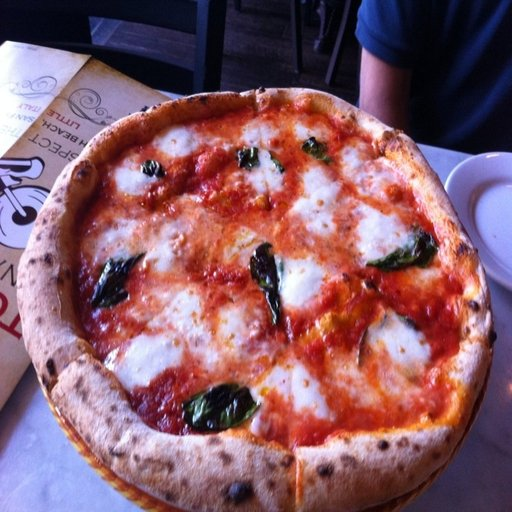

In [9]:
import random
from PIL import Image

# Set the random seed to ensure maximum reproducibility
random.seed(42)

# Retrieve all image paths
image_path_list = list(image_path.glob("*/*/*.jpg"))

# Select a random image path
random_image_path = random.choice(image_path_list)

# Extract the image class from the path name
image_class = random_image_path.parent.stem

# Open the image
img = Image.open(random_image_path)

# Print metadata about the image
print(f"Random image path: {random_image_path}")
print(f"Image class: {image_class}")
print(f"Image height: {img.height}")
print(f"Image width: {img.width}")
img

Additionally, images can be visualized using the 'matplotlib' library:

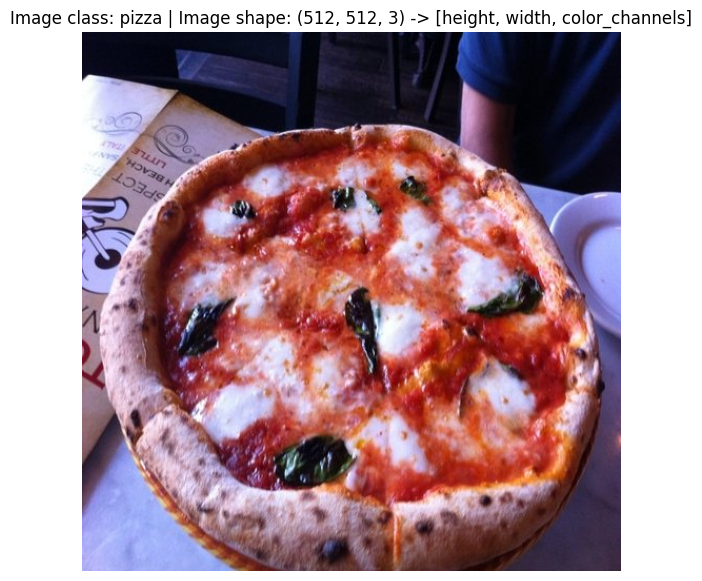

In [10]:
import numpy as np
import matplotlib.pyplot as plt

# Convert the image into an array
img_as_array = np.asarray(img)

# Plot the image using matplotlib
plt.figure(figsize=(10, 7))
plt.imshow(img_as_array)
plt.title(f"Image class: {image_class} | Image shape: {img_as_array.shape} -> [height, width, color_channels]")
plt.axis(False);

## Preprocess the Data

Given that we are addressing a computer vision problem, we will utilize 'torchvision.datasets' for the data loading functions, and 'torchvision.transforms' for the preprocessing of the data:

In [11]:
from torchvision import transforms

# Create a simple transform
simple_transform = transforms.Compose([
    transforms.Resize((64, 64)),
    transforms.ToTensor(),
])

With the transformation defined, let's write a function to test it out on various images:


In [12]:
def plot_transformed_images(image_paths, transform, n=3, seed=42):
    """This function plots a series of random images from 'image_paths'. It will
    open 'n' image paths from 'image_paths', transform them using 'transform',
    and plot them side by side.

    Args:
        image_paths (list): List of target image paths.
        transform (PyTorch Transforms): Transforms to apply to images.
        n (int, optional): Number of images to plot. Defaults to 3.
        seed (int, optional): Random seed for the random generator. Defaults to 42.
    """
    # Set the random seed
    random.seed(seed)
    random_image_paths = random.sample(image_paths, k=n)
    for image_path in random_image_paths:
        with Image.open(image_path) as f:
            fig, ax = plt.subplots(1, 2)
            ax[0].imshow(f)
            ax[0].set_title(f"Original \nSize: {f.size}")
            ax[0].axis("off")

            # Transform and plot image
            transformed_image = transform(f).permute(1, 2, 0)
            ax[1].imshow(transformed_image)
            ax[1].set_title(f"Transformed \nSize: {transformed_image.shape}")
            ax[1].axis("off")

            fig.suptitle(f"Class: {image_path.parent.stem}", fontsize=16)

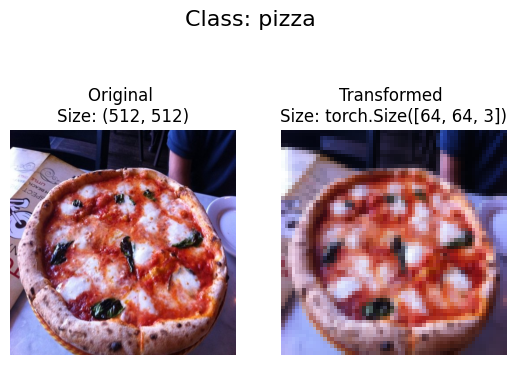

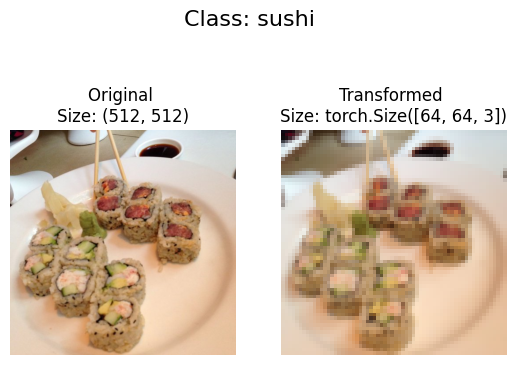

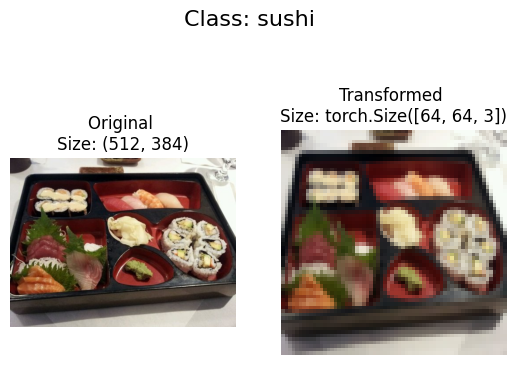

In [13]:
plot_transformed_images(image_path_list, transform=simple_transform, n=3)

#### Standard Method: Loading Image Data via ImageFolder






Now we can convert the image data into a **PyTorch-compatible dataset**. Given that the training and testing data follow a standard image classification structure (as outlined in the 'Get the data' section), we will use 'torchvision.datasets.ImageFolder' to load the training and testing data. Additionally, we will integrate the previously created transform pipeline to apply it to all the images:

In [14]:
from torchvision import datasets

# Load and transform the data
train_data_simple = datasets.ImageFolder(root=train_dir, transform=simple_transform)
test_data_simple = datasets.ImageFolder(root=test_dir, transform=simple_transform)

# Display the data
train_data_simple, test_data_simple

(Dataset ImageFolder
     Number of datapoints: 225
     Root location: data/pizza_steak_sushi/train
     StandardTransform
 Transform: Compose(
                Resize(size=(64, 64), interpolation=bilinear, max_size=None, antialias=True)
                ToTensor()
            ),
 Dataset ImageFolder
     Number of datapoints: 75
     Root location: data/pizza_steak_sushi/test
     StandardTransform
 Transform: Compose(
                Resize(size=(64, 64), interpolation=bilinear, max_size=None, antialias=True)
                ToTensor()
            ))

Let's inspect them by examining the 'classes' and 'class_to_idx' attributes, as well as the lengths of the training and test sets:

In [15]:
# Retrieve class names as a list
class_names = train_data_simple.classes
class_names

['pizza', 'steak', 'sushi']

In [16]:
# Alternatively, retrieve class names as a dictionary
class_dict = train_data_simple.class_to_idx
class_dict

{'pizza': 0, 'steak': 1, 'sushi': 2}

In [17]:
# Verify the lengths
len(train_data_simple), len(test_data_simple)

(225, 75)

We can index the 'train_data' and 'test_data' datasets to access samples and their corresponding target labels. This allows us to retrieve and analyze specific data points within the datasets:

In [18]:
img, label = train_data_simple[0][0], train_data_simple[0][1]
print(f"Image tensor:\n{img}")
print(f"Image shape: {img.shape}")
print(f"Image datatype: {img.dtype}")
print(f"Image label: {label}")
print(f"Label datatype: {type(label)}")

Image tensor:
tensor([[[0.1176, 0.1216, 0.1255,  ..., 0.0980, 0.1020, 0.1137],
         [0.1294, 0.1294, 0.1294,  ..., 0.0980, 0.0980, 0.1059],
         [0.1333, 0.1333, 0.1333,  ..., 0.0941, 0.0980, 0.1020],
         ...,
         [0.1686, 0.1647, 0.1686,  ..., 0.1255, 0.1098, 0.1098],
         [0.1686, 0.1647, 0.1686,  ..., 0.1098, 0.0941, 0.0902],
         [0.1647, 0.1647, 0.1686,  ..., 0.0980, 0.0863, 0.0863]],

        [[0.0588, 0.0588, 0.0588,  ..., 0.0745, 0.0706, 0.0745],
         [0.0627, 0.0627, 0.0627,  ..., 0.0745, 0.0706, 0.0745],
         [0.0706, 0.0706, 0.0706,  ..., 0.0745, 0.0745, 0.0706],
         ...,
         [0.2392, 0.2392, 0.2510,  ..., 0.1373, 0.1333, 0.1255],
         [0.2314, 0.2392, 0.2510,  ..., 0.1255, 0.1176, 0.1098],
         [0.2275, 0.2353, 0.2431,  ..., 0.1137, 0.1059, 0.1020]],

        [[0.0196, 0.0196, 0.0157,  ..., 0.0902, 0.0902, 0.0941],
         [0.0196, 0.0157, 0.0196,  ..., 0.0902, 0.0863, 0.0902],
         [0.0196, 0.0157, 0.0157,  ..., 0.09

To visualize the data, we will plot a single image tensor using 'Matplotlib':

Original shape: torch.Size([3, 64, 64]) -> [color_channels, height, width]
Image permute shape: torch.Size([64, 64, 3]) -> [height, width, color_channels]


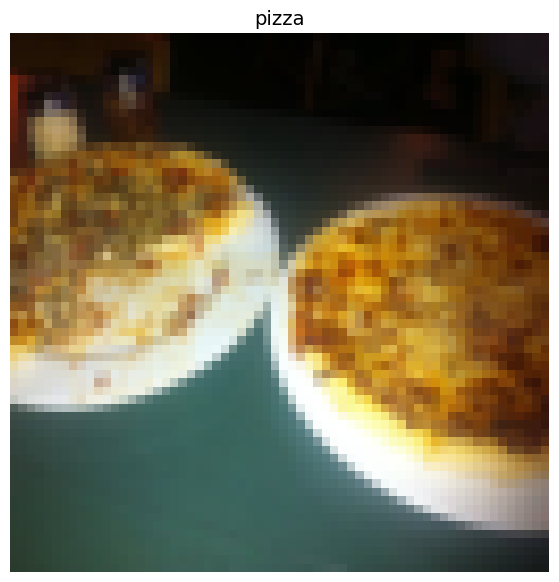

In [19]:
# Rearrange the order of dimensions
img_permute = img.permute(1, 2, 0)
# Print different shapes (before and after permutation)
print(f"Original shape: {img.shape} -> [color_channels, height, width]")
print(f"Image permute shape: {img_permute.shape} -> [height, width, color_channels]")

# Plot the image
plt.figure(figsize=(10, 7))
plt.imshow(img.permute(1, 2, 0))
plt.axis("off")
plt.title(class_names[label], fontsize=14);

We now have the images in the form of **PyTorch Datasets**. To facilitate model training, these datasets need to be converted into DataLoaders using 'torch.utils.data.DataLoader.'

**DataLoaders** make the datasets iterable, allowing the model to efficiently traverse and learn the relationships between features (samples) and labels (targets):

In [20]:
from torch.utils.data import DataLoader

# Configure batch size and number of workers
BATCH_SIZE = 32
NUM_WORKERS = os.cpu_count()
print(f"Creating DataLoaders with batch size {BATCH_SIZE} and {NUM_WORKERS} workers.")

# Create and display the train and test DataLoaders
train_dataloader_simple = DataLoader(train_data_simple,
                                     batch_size=BATCH_SIZE,
                                     shuffle=True,
                                     num_workers=NUM_WORKERS)

test_dataloader_simple = DataLoader(test_data_simple,
                                    batch_size=BATCH_SIZE,
                                    shuffle=False,
                                    num_workers=NUM_WORKERS)

train_dataloader_simple, test_dataloader_simple

Creating DataLoaders with batch size 32 and 2 workers.


(<torch.utils.data.dataloader.DataLoader at 0x79d4182f11e0>,
 <torch.utils.data.dataloader.DataLoader at 0x79d4182f1750>)

With the data now iterable, we can employ these DataLoaders within training and testing loops to train the model. However, prior to model building, it is prudent to inspect the shapes of the data to ensure proper structuring:

In [21]:
img, label = next(iter(train_dataloader_simple))
# Batch size is now set to 1.
print(f"Image shape: {img.shape} -> [batch_size, color_channels, height, width]")
print(f"Label shape: {label.shape}")

Image shape: torch.Size([32, 3, 64, 64]) -> [batch_size, color_channels, height, width]
Label shape: torch.Size([32])


#### Alternative Approach (optional): Image Data Loading with Custom Dataset

In some instances, you may encounter datasets that lack prebuilt functions like 'ImageFolder'. In such cases, it is necessary to develop a custom method to load these datasets. Below is an example of how to achieve this:

In [22]:
import os
import pathlib
import torch
from PIL import Image
from torch.utils.data import Dataset
from torchvision import transforms
from typing import Tuple, Dict, List

In [23]:
# Instance of torchvision.datasets.ImageFolder()
train_data_simple.classes, train_data_simple.class_to_idx

(['pizza', 'steak', 'sushi'], {'pizza': 0, 'steak': 1, 'sushi': 2})

Developing an helper function to extract the class names from the dataset:

In [24]:
# Define the path for the target directory
target_directory = train_dir
print(f"Target directory: {target_directory}")

# Retrieve the class names from the target directory
class_names_found = sorted([entry.name for entry in list(os.scandir(image_path / "train"))])
print(f"Class names found: {class_names_found}")

Target directory: data/pizza_steak_sushi/train
Class names found: ['pizza', 'steak', 'sushi']


In [25]:
from typing import Tuple, Dict, List

def find_classes(directory: str) -> Tuple[List[str], Dict[str, int]]:
    """The function finds the class folder names in the target directory.
    It assumes the target directory follows the standard image classification format.

    Args:
        directory (str): target directory to load classnames from.

    Returns:
        Tuple[List[str], Dict[str, int]]: (list_of_class_names, dict(class_name: idx...))
    """
    # Retrieve the class names by scanning the target directory
    classes = sorted(entry.name for entry in os.scandir(directory) if entry.is_dir())

    # Raise an error if class names not found
    if not classes:
        raise FileNotFoundError(f"Couldn't find any classes in {directory}.")

    # Create a dictionary of index labels
    class_to_idx = {cls_name: i for i, cls_name in enumerate(classes)}

    return classes, class_to_idx

Validating the functionality of the 'find_classes()' function to ensure it accurately retrieves class names:

In [26]:
find_classes(train_dir)

(['pizza', 'steak', 'sushi'], {'pizza': 0, 'steak': 1, 'sushi': 2})

Develop a custom dataset class to replicate the functionality of PyTorch's 'ImageFolder':

In [27]:
from torch.utils.data import Dataset

class ImageFolderCustom(Dataset):
    # Initialize with a targ_dir and transform
    def __init__(self, targ_dir: str, transform=None) -> None:
        # Retrieve all image paths
        self.paths = list(pathlib.Path(targ_dir).glob("*/*.jpg"))
        # Setup the transforms
        self.transform = transform
        # Create classes and class_to_idx attributes
        self.classes, self.class_to_idx = find_classes(targ_dir)

    # Define a function to load images
    def load_image(self, index: int) -> Image.Image:
        "Opens an image via a path and returns it."
        image_path = self.paths[index]
        return Image.open(image_path)

    # Overwrite the '__len__()' method
    def __len__(self) -> int:
        "Returns the total number of samples."
        return len(self.paths)

    # Overwrite the '__getitem__()' method
    def __getitem__(self, index: int) -> Tuple[torch.Tensor, int]:
        "Returns one sample of data, data and label (X, y)."
        img = self.load_image(index)
        class_name  = self.paths[index].parent.name
        class_idx = self.class_to_idx[class_name]

        # Apply transforms if necessary
        if self.transform:
            return self.transform(img), class_idx
        else:
            return img, class_idx

Define and implement image transformations to preprocess the images before training:


In [28]:
# Create a training transform with data augmentation
train_transforms = transforms.Compose([
    transforms.Resize((64, 64)),
    transforms.RandomHorizontalFlip(p=0.5),
    transforms.ToTensor()
])

# Create a testing transform. Only reshaping it since data augmentation isn't needed for the test set.
test_transforms = transforms.Compose([
    transforms.Resize((64, 64)),
    transforms.ToTensor()
])

Convert the training and testing images into Datasets using the custom dataset class:

In [29]:
import torchvision.transforms as transforms

train_data_custom = ImageFolderCustom(targ_dir=train_dir, transform=train_transforms)
test_data_custom = ImageFolderCustom(targ_dir=test_dir, transform=test_transforms)
train_data_custom, test_data_custom

(<__main__.ImageFolderCustom at 0x79d4182f10f0>,
 <__main__.ImageFolderCustom at 0x79d4114ed300>)

In [30]:
len(train_data_custom), len(test_data_custom)

(225, 75)

In [31]:
train_data_custom.classes

['pizza', 'steak', 'sushi']

In [32]:
train_data_custom.class_to_idx

{'pizza': 0, 'steak': 1, 'sushi': 2}

Ensure the custom datasets created are equivalent to those made using the 'torchvision.datasets.ImageFolder' class:


In [33]:
# Verify equality between the custom Dataset and the ImageFolder Dataset
print((len(train_data_custom) == len(train_data_simple)) & (len(test_data_custom) == len(test_data_simple)))
print(train_data_custom.classes == train_data_simple.classes)
print(train_data_custom.class_to_idx == train_data_simple.class_to_idx)

True
True
True


Let's implement a function to display random images from the dataset, supporting both the ImageFolder dataset (Standard Method) and the custom dataset (Alternative Approach):

In [34]:
def display_random_images(dataset: torch.utils.data.dataset.Dataset,
                          classes: List[str] = None,
                          n: int = 10,
                          display_shape: bool = True,
                          seed: int = None):
    # Adjust the display in case that 'n' is too high
    if n > 10:
        n = 10
        display_shape = False
        print(f"For display purposes, 'n' shouldn't be larger than 10. Setting it to 10, and removing shape display.")

    # Set random seed
    if seed:
        random.seed(seed)

    # Retrieve random sample indexes
    random_samples_idx = random.sample(range(len(dataset)), k=n)

    # Define the plot
    plt.figure(figsize=(16, 8))

    # Loop through the samples and display the random samples
    for i, targ_sample in enumerate(random_samples_idx):
        targ_image, targ_label = dataset[targ_sample][0], dataset[targ_sample][1]

        # Modify the image tensor shape for plotting and plot
        targ_image_adjust = targ_image.permute(1, 2, 0)
        plt.subplot(1, n, i+1)
        plt.imshow(targ_image_adjust)
        plt.axis("off")
        if classes:
            title = f"class: {classes[targ_label]}"
            if display_shape:
                title = title + f"\nshape: {targ_image_adjust.shape}"
        plt.title(title)



Validating the image display function with the datasets created using 'torchvision.datasets.ImageFolder':

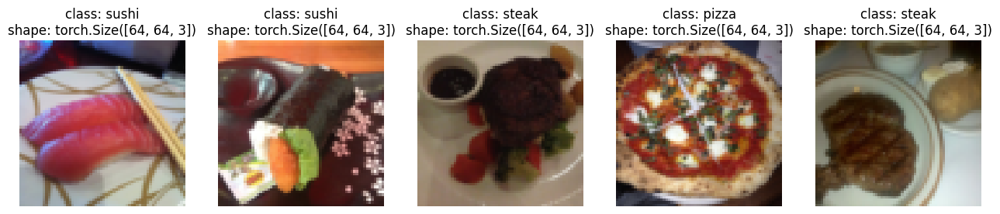

In [36]:
# Display the random images from the ImageFolder
display_random_images(train_data_simple, n=5, classes=class_names, seed=None)

Validating the image display function with the datasets created using the custom dataset class:


For display purposes, 'n' shouldn't be larger than 10. Setting it to 10, and removing shape display.


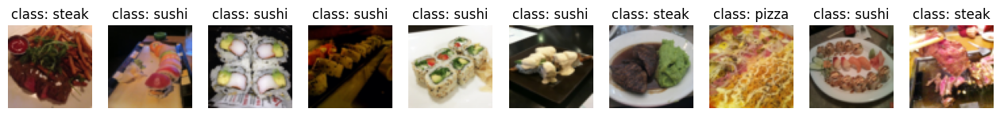

In [37]:
# Display the random images from the ImageFolderCustom
display_random_images(train_data_custom, n=12, classes=class_names, seed=None)

Transform the custom datasets into DataLoaders for efficient batch processing:

In [38]:
# Create and display the train and test DataLoaders
train_dataloader_custom = DataLoader(dataset=train_data_custom,
                                     batch_size=1,
                                     num_workers=0,
                                     shuffle=True)

test_dataloader_custom = DataLoader(dataset=test_data_custom,
                                    batch_size=1,
                                    num_workers=0,
                                    shuffle=False)

train_dataloader_custom, test_dataloader_custom

(<torch.utils.data.dataloader.DataLoader at 0x79d4105581f0>,
 <torch.utils.data.dataloader.DataLoader at 0x79d41053bd30>)

Examine and verify the shapes of samples obtained from the DataLoader to ensure correctness:

In [39]:
# Retrieve the image and label from the custom DataLoader
img_custom, label_custom = next(iter(train_dataloader_custom))
# Batch size is now set to 1.
print(f"Image shape: {img_custom.shape} -> [batch_size, color_channels, height, width]")
print(f"Label shape: {label_custom.shape}")

Image shape: torch.Size([1, 3, 64, 64]) -> [batch_size, color_channels, height, width]
Label shape: torch.Size([1])


## Implementation and Evaluation of 'Model_0' - 'TinyVGG' Architecture Without Data Augmentation

In all subsequent sections of this notebook, we will adhere to the 'Standard Method: Loading Image Data via ImageFolder', and utilize the simple transform initially established during the data preprocessing step.

For the 'model_0' experiment, we will replicate the TinyVGG model architecture **without** data augmentation as demonstrated on the CNN Explainer website. Let's begin by defining the TinyVGG model class:

In [40]:
class TinyVGG(nn.Module):
    def __init__(self, input_shape: int, hidden_units: int, output_shape: int) -> None:
        super().__init__()
        self.conv_block_1 = nn.Sequential(
            nn.Conv2d(in_channels=input_shape,
                      out_channels=hidden_units,
                      kernel_size=3,
                      stride=1,
                      padding=1),
            nn.ReLU(),
            nn.Conv2d(in_channels=hidden_units,
                      out_channels=hidden_units,
                      kernel_size=3,
                      stride=1,
                      padding=1),
            nn.ReLU(),
            nn.MaxPool2d(kernel_size=2,
                         stride=2)
        )
        self.conv_block_2 = nn.Sequential(
            nn.Conv2d(hidden_units, hidden_units, kernel_size=3, padding=1),
            nn.ReLU(),
            nn.Conv2d(hidden_units, hidden_units, kernel_size=3, padding=1),
            nn.ReLU(),
            nn.MaxPool2d(2)
        )
        self.classifier = nn.Sequential(
            nn.Flatten(),
            nn.Linear(in_features=hidden_units*16*16,
                      out_features=output_shape)
        )

    # Implementing the forward pass method
    def forward(self, x: torch.Tensor):
        x = self.conv_block_1(x)
        print(x.shape)
        x = self.conv_block_2(x)
        print(x.shape)
        x = self.classifier(x)
        print(x.shape)
        return x


# Set the random seed
torch.manual_seed(42)

# Create 'model_0' (TinyVGG model)
model_0 = TinyVGG(input_shape=3,
                  hidden_units=10,
                  output_shape=len(train_data_simple.classes)).to(device)

# Display the model
model_0

TinyVGG(
  (conv_block_1): Sequential(
    (0): Conv2d(3, 10, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): ReLU()
    (2): Conv2d(10, 10, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (3): ReLU()
    (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  )
  (conv_block_2): Sequential(
    (0): Conv2d(10, 10, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): ReLU()
    (2): Conv2d(10, 10, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (3): ReLU()
    (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  )
  (classifier): Sequential(
    (0): Flatten(start_dim=1, end_dim=-1)
    (1): Linear(in_features=2560, out_features=3, bias=True)
  )
)

**Explanation on How I Determined the 'in_features' Parameter:**

To accurately set the **'in_features'** parameter for the final layer of the classifier (an 'nn.Linear layer' in our case) and to validate the model's functionality, I followed a systematic approach:

1. **Insertion of Print Statements:**
 - I temporarily added print statements within the forward pass function of the model.
 - These print statements were placed between each line of the function, specifically after each convolutional block and the classifier layer.
 - The purpose of these print statements was to print the shape of the tensor x after it passed through each block and the classifier. This allowed for a clear understanding of how the data dimensions changed through the layers.

2. **Temporary Setting of 'in_features':**

 - I temporarily set the 'in_features' parameter of the final 'nn.Linear layer' to the 'hidden_units' variable. This step ensured that the model could run without errors during the shape inspection process.
 - This adjustment was essential to facilitate the forward pass of the data and allow the inspection of the resulting tensor shapes.

3. **Inspection of Input and Output Shapes:**

 - I passed a batch of training data through the model.
 - By observing the printed shapes from the print statements, I tracked how the input data dimensions transformed through each layer of the model.
 - Specifically, the shape after the last convolutional block provided the necessary information to set the 'in_features' parameter accurately.
 - This final shape, when flattened, determined the exact value for the 'in_features' parameter of the 'nn.Linear layer'.


In [41]:
# Retrieve a batch of images and labels from the DataLoader
img_batch, label_batch = next(iter(train_dataloader_simple))
model_0(img_batch.to(device))

torch.Size([32, 10, 32, 32])
torch.Size([32, 10, 16, 16])
torch.Size([32, 3])


tensor([[0.0578, 0.0634, 0.0351],
        [0.0657, 0.0650, 0.0398],
        [0.0702, 0.0678, 0.0412],
        [0.0687, 0.0646, 0.0417],
        [0.0625, 0.0613, 0.0355],
        [0.0587, 0.0595, 0.0358],
        [0.0634, 0.0637, 0.0376],
        [0.0653, 0.0615, 0.0376],
        [0.0678, 0.0621, 0.0349],
        [0.0620, 0.0599, 0.0371],
        [0.0607, 0.0628, 0.0387],
        [0.0638, 0.0589, 0.0352],
        [0.0658, 0.0611, 0.0369],
        [0.0703, 0.0689, 0.0330],
        [0.0557, 0.0571, 0.0356],
        [0.0632, 0.0642, 0.0388],
        [0.0639, 0.0616, 0.0375],
        [0.0605, 0.0600, 0.0374],
        [0.0623, 0.0627, 0.0368],
        [0.0740, 0.0676, 0.0400],
        [0.0621, 0.0613, 0.0361],
        [0.0632, 0.0599, 0.0366],
        [0.0662, 0.0627, 0.0334],
        [0.0637, 0.0622, 0.0394],
        [0.0670, 0.0666, 0.0363],
        [0.0650, 0.0601, 0.0405],
        [0.0639, 0.0597, 0.0395],
        [0.0733, 0.0687, 0.0412],
        [0.0697, 0.0631, 0.0402],
        [0.062

**1) Resolving 'in_features' Parameter for the Final Classifier Layer:**

When executing the previous code, the output includes print statements from the temporarily added lines in the forward pass function. The final output might resemble: **'torch.size([batch_size, hidden_units, a, b])**.

**2) Error Diagnosis and Resolution:**

If an error such as **'RuntimeError: mat1 and mat2 shapes cannot be multiplied ({batch_size}, {a}, {hidden_units}, {input_shape})'** occurs, it indicates an incorrect setting for the 'in_features' parameter of the final classifier layer. This error arises because matrix multiplication requires matching **inner** dimensions, i.e., (a, **b**) * (**b**, c).

In this situation:

1. Error Analysis:

 - The classifier’s final output print statement is missing due to the error halting data flow.
 - The last visible output is from the second convolutional block, representing the input to the classifier layer **before** passing through the 'nn.Flatten' layer.

2. Determining 'in_features':

 - Inspect the final visible output tensor’s shape, which should be [batch_size, hidden_units, a, b].
 - The correct 'in_features' value is derived from flattening this tensor: **hidden_units * a * b**.

**3) Updating the Model:**

With the correct 'in_features' value determined:

1. Updating the Classifier Layer:
 - I have set up the 'in_features' parameter of the last 'nn.Linear layer' to **hidden_units * a * b**.
2. Cleaning Up:
 - Commented the temporary print statements from the forward pass function.
3. Proceeding with Training:
 - Resumed training the model with the updated configuration.


Let's now leverage 'torchinfo' to obtain a comprehensive model's summary:

In [42]:
# Ensure 'torchinfo' is installed. If it is already available, proceed to import it.
try:
    import torchinfo
except:
    !pip install torchinfo
    import torchinfo

# Perform a test run using an example input size.
from torchinfo import summary

summary(model_0, input_size=[1, 3, 64, 64])

torch.Size([1, 10, 32, 32])
torch.Size([1, 10, 16, 16])
torch.Size([1, 3])


Layer (type:depth-idx)                   Output Shape              Param #
TinyVGG                                  [1, 3]                    --
├─Sequential: 1-1                        [1, 10, 32, 32]           --
│    └─Conv2d: 2-1                       [1, 10, 64, 64]           280
│    └─ReLU: 2-2                         [1, 10, 64, 64]           --
│    └─Conv2d: 2-3                       [1, 10, 64, 64]           910
│    └─ReLU: 2-4                         [1, 10, 64, 64]           --
│    └─MaxPool2d: 2-5                    [1, 10, 32, 32]           --
├─Sequential: 1-2                        [1, 10, 16, 16]           --
│    └─Conv2d: 2-6                       [1, 10, 32, 32]           910
│    └─ReLU: 2-7                         [1, 10, 32, 32]           --
│    └─Conv2d: 2-8                       [1, 10, 32, 32]           910
│    └─ReLU: 2-9                         [1, 10, 32, 32]           --
│    └─MaxPool2d: 2-10                   [1, 10, 16, 16]           --
├─Sequentia

With the data and model prepared, we can now proceed to create the training and testing loops essential for model evaluation:

In [43]:
def train_step(model: torch.nn.Module,
               dataloader: torch.utils.data.DataLoader,
               loss_fn: torch.nn.Module,
               optimizer: torch.optim.Optimizer):
    # Set the model in train mode
    model.train()

    # Define the train loss and train accuracy values
    train_loss, train_acc = 0, 0

    # Loop through the data loader data batches
    for batch, (X, y) in enumerate(dataloader):
        # Set the data to the target device
        X, y = X.to(device), y.to(device)

        # Apply the forward pass
        y_pred = model(X)

        # Calculate and accumulate the loss
        loss = loss_fn(y_pred, y)
        train_loss += loss.item()

        # Apply the optimizer zero grad
        optimizer.zero_grad()

        # Apply the loss backward
        loss.backward()

        # Apply the optimizer step
        optimizer.step()

        # Calculate and accumulate accuracy metric across all batches
        y_pred_class = torch.argmax(torch.softmax(y_pred, dim=1), dim=1)
        train_acc += (y_pred_class == y).sum().item()/len(y_pred)

    # Modify the metrics to get average loss and accuracy per batch
    train_loss = train_loss / len(dataloader)
    train_acc = train_acc / len(dataloader)

    return train_loss, train_acc

**Note:** After inputting data (in this case, images) into the model, the output is **'logits**, which are not directly interpretable. The 'softmax' activation function, used for multi-class classification, converts these logits into **prediction probabilities**. The 'argmax()' function then converts these probabilities into **prediction labels**, making the results understandable.

In [44]:
def test_step(model: torch.nn.Module,
              dataloader: torch.utils.data.DataLoader,
              loss_fn: torch.nn.Module):
    # Set the model in eval mode
    model.eval()

    # Define the test loss and test accuracy values
    test_loss, test_acc = 0, 0

    # Activate the inference context manager
    with torch.inference_mode():
        # Loop through the DataLoader batches
        for batch, (X, y) in enumerate(dataloader):
            # Send the data to the target device
            X, y = X.to(device), y.to(device)

            # Apply the forward pass
            test_pred_logits = model(X)

            # Calculate and accumulate the loss
            loss = loss_fn(test_pred_logits, y)
            test_loss += loss.item()

            # Calculate and accumulate the accuracy
            test_pred_labels = test_pred_logits.argmax(dim=1)
            test_acc += ((test_pred_labels == y).sum().item()/len(test_pred_labels))

    # Modify the metrics to get the average loss and accuracy per batch
    test_loss = test_loss / len(dataloader)
    test_acc = test_acc / len(dataloader)

    return test_loss, test_acc

**Note:** During the testing phase, the model is evaluated on the **test** dataloader. Therefore, steps such as 'optimizer.zero_grad()', 'loss.backward()', and 'optimizer.step()' are not required.

We will create a 'train()' function to integrate both 'train_step()' and 'test_step()' for streamlined execution:

In [45]:
from tqdm.auto import tqdm

def train(model: torch.nn.Module,
          train_dataloader: torch.utils.data.DataLoader,
          test_dataloader: torch.utils.data.DataLoader,
          optimizer: torch.optim.Optimizer,
          loss_fn: torch.nn.Module = nn.CrossEntropyLoss(),
          epochs: int = 5):
    # Define empty results dictionary
    results = {"train_loss": [],
                "train_acc": [],
                "test_loss": [],
                "test_acc": []
    }

    # Loop through the training and testing steps for some epochs
    for epoch in tqdm(range(epochs)):
        train_loss, train_acc = train_step(model=model,
                                           dataloader=train_dataloader,
                                           loss_fn=loss_fn,
                                           optimizer=optimizer)
        test_loss, test_acc = test_step(model=model,
                                        dataloader=test_dataloader,
                                        loss_fn=loss_fn)
        # Print statements
        print(
            f"Epoch: {epoch+1} | "
            f"train_loss: {train_loss:.4f} | "
            f"train_acc: {train_acc:.4f} | "
            f"test_loss: {test_loss:.4f} | "
            f"test_acc: {test_acc:.4f}"
        )

        # Update the results dictionary accordingly
        results["train_loss"].append(train_loss)
        results["train_acc"].append(train_acc)
        results["test_loss"].append(test_loss)
        results["test_acc"].append(test_acc)

    return results

Let's proceed to train and evaluate 'model_0':

In [46]:
from timeit import default_timer as timer

# Set the random seeds
torch.manual_seed(42)
torch.cuda.manual_seed(42)

# Define the number of epochs
NUM_EPOCHS = 5

# Recreate an instance of the TinyVGG model
model_0 = TinyVGG(input_shape=3,
                  hidden_units=10,
                  output_shape=len(train_data_simple.classes)).to(device)

# Define the loss function
loss_fn = nn.CrossEntropyLoss()
# Define the optimizer
optimizer = torch.optim.Adam(params=model_0.parameters(), lr=0.001)

# Begin the timer
start_time = timer()

# Train the 'model_0' (TinyVGG)
model_0_results = train(model=model_0,
                        train_dataloader=train_dataloader_simple,
                        test_dataloader=test_dataloader_simple,
                        optimizer=optimizer,
                        loss_fn=loss_fn,
                        epochs=NUM_EPOCHS)

# End the timer, and print the training time
end_time = timer()
print(f"Total training time: {end_time-start_time:.3f} seconds")

  0%|          | 0/5 [00:00<?, ?it/s]

torch.Size([32, 10, 32, 32])
torch.Size([32, 10, 16, 16])
torch.Size([32, 3])
torch.Size([32, 10, 32, 32])
torch.Size([32, 10, 16, 16])
torch.Size([32, 3])
torch.Size([32, 10, 32, 32])
torch.Size([32, 10, 16, 16])
torch.Size([32, 3])
torch.Size([32, 10, 32, 32])
torch.Size([32, 10, 16, 16])
torch.Size([32, 3])
torch.Size([32, 10, 32, 32])
torch.Size([32, 10, 16, 16])
torch.Size([32, 3])
torch.Size([32, 10, 32, 32])
torch.Size([32, 10, 16, 16])
torch.Size([32, 3])
torch.Size([32, 10, 32, 32])
torch.Size([32, 10, 16, 16])
torch.Size([32, 3])
torch.Size([1, 10, 32, 32])
torch.Size([1, 10, 16, 16])
torch.Size([1, 3])
torch.Size([32, 10, 32, 32])
torch.Size([32, 10, 16, 16])
torch.Size([32, 3])
torch.Size([32, 10, 32, 32])
torch.Size([32, 10, 16, 16])
torch.Size([32, 3])
torch.Size([11, 10, 32, 32])
torch.Size([11, 10, 16, 16])
torch.Size([11, 3])
Epoch: 1 | train_loss: 1.1078 | train_acc: 0.2578 | test_loss: 1.1362 | test_acc: 0.2604
torch.Size([32, 10, 32, 32])
torch.Size([32, 10, 16, 16]

The initial evaluation indicates suboptimal performance of 'model_0'. To further analyze, we will plot the model's loss curves over time, providing a visual representation of the model’s performance. Prior to this, let's review the keys in 'model_0_results':

In [47]:
# Display the model_0's keys
model_0_results.keys()

dict_keys(['train_loss', 'train_acc', 'test_loss', 'test_acc'])

Let's extract each of these keys and generate plots to visualize performance metrics:



In [48]:
def plot_loss_curves(results: Dict[str, List[float]]):
    """The function plots the training curves of a results dictionary.

    Args:
        results (dict): dictionary containing list of values, e.g.
            {"train_loss": [...],
             "train_acc": [...],
             "test_loss": [...],
             "test_acc": [...]}
    """
    # Retrieve the loss values of the results dictionary
    loss = results['train_loss']
    test_loss = results['test_loss']

    # Retrieve the accuracy values of the results dictionary
    accuracy = results['train_acc']
    test_accuracy = results['test_acc']

    # Find out the number of epochs there was
    epochs = range(len(results['train_loss']))

    # Define the plot
    plt.figure(figsize=(15, 7))
    # Plot the loss
    plt.subplot(1, 2, 1)
    plt.plot(epochs, loss, label='train_loss')
    plt.plot(epochs, test_loss, label='test_loss')
    plt.title('Loss')
    plt.xlabel('Epochs')
    plt.legend()
    # Plot the accuracy
    plt.subplot(1, 2, 2)
    plt.plot(epochs, accuracy, label='train_accuracy')
    plt.plot(epochs, test_accuracy, label='test_accuracy')
    plt.title('Accuracy')
    plt.xlabel('Epochs')
    plt.legend();

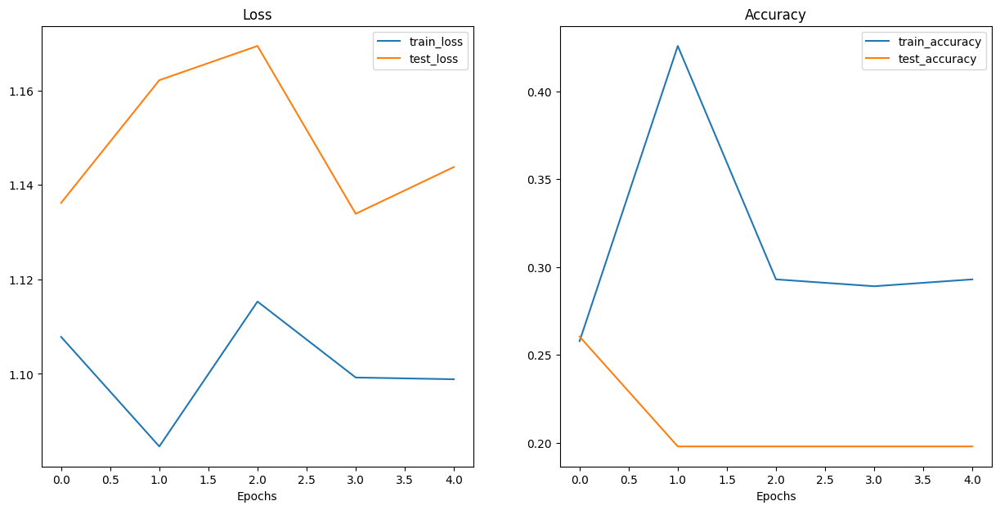

In [49]:
plot_loss_curves(model_0_results)

As shown above, the initial plots suggest inconsistent results. Let's experiment with an alternative model to potentially improve performance.



## Implementation and Evaluation of 'Model_1' - 'TinyVGG' Architecture With Data Augmentation


For the 'model_1' experiment, we will employ **data augmentation** to enhance dataset diversity and potentially improve model performance. Initially, we will create a new ‘transform’ that includes the 'transforms.TrivialAugmentWide()' method, along with resizing and tensor conversion. The testing transform will **exclude** data augmentation, as it is solely for evaluation purposes and doesn't require added diversity:


In [50]:
# Create a training transform with data augmentation
train_transform_trivial_augment = transforms.Compose([
    transforms.Resize((64, 64)),
    transforms.TrivialAugmentWide(num_magnitude_bins=31),
    transforms.ToTensor()
])

# Create a testing transform. Only reshaping it since data augmentation isn't needed for the test set.
test_transform = transforms.Compose([
    transforms.Resize((64, 64)),
    transforms.ToTensor()
])

In [51]:
# Load and transform the data
train_data_augmented = datasets.ImageFolder(train_dir, transform=train_transform_trivial_augment)
test_data_simple = datasets.ImageFolder(test_dir, transform=test_transform)

# Display the data
train_data_augmented, test_data_simple

(Dataset ImageFolder
     Number of datapoints: 225
     Root location: data/pizza_steak_sushi/train
     StandardTransform
 Transform: Compose(
                Resize(size=(64, 64), interpolation=bilinear, max_size=None, antialias=True)
                TrivialAugmentWide(num_magnitude_bins=31, interpolation=InterpolationMode.NEAREST, fill=None)
                ToTensor()
            ),
 Dataset ImageFolder
     Number of datapoints: 75
     Root location: data/pizza_steak_sushi/test
     StandardTransform
 Transform: Compose(
                Resize(size=(64, 64), interpolation=bilinear, max_size=None, antialias=True)
                ToTensor()
            ))

In [52]:
# Configure batch size and number of workers
BATCH_SIZE = 32
NUM_WORKERS = os.cpu_count()

# Set the random seed
torch.manual_seed(42)

# Create and display the train and test DataLoaders
train_dataloader_augmented = DataLoader(train_data_augmented,
                                        batch_size=BATCH_SIZE,
                                        shuffle=True,
                                        num_workers=NUM_WORKERS)

test_dataloader_simple = DataLoader(test_data_simple,
                                    batch_size=BATCH_SIZE,
                                    shuffle=False,
                                    num_workers=NUM_WORKERS)

train_dataloader_augmented, test_dataloader_simple

(<torch.utils.data.dataloader.DataLoader at 0x79d3f80bfdc0>,
 <torch.utils.data.dataloader.DataLoader at 0x79d3f80bc760>)

Utilizing the created DataLoaders, we will implement a training and testing loop to train the model. Let's construct and train 'model_1' using the previously defined TinyVGG class:



In [53]:
# Set the random seed
torch.manual_seed(42)

# Create 'model_1'
model_1 = TinyVGG(
    input_shape=3,
    hidden_units=10,
    output_shape=len(train_data_augmented.classes)).to(device)

# Display 'model_1'
model_1

TinyVGG(
  (conv_block_1): Sequential(
    (0): Conv2d(3, 10, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): ReLU()
    (2): Conv2d(10, 10, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (3): ReLU()
    (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  )
  (conv_block_2): Sequential(
    (0): Conv2d(10, 10, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): ReLU()
    (2): Conv2d(10, 10, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (3): ReLU()
    (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  )
  (classifier): Sequential(
    (0): Flatten(start_dim=1, end_dim=-1)
    (1): Linear(in_features=2560, out_features=3, bias=True)
  )
)

In [54]:
# Obtain and display the model's summary
summary(model_1, input_size=[1, 3, 64, 64]) # Perform a test pass to verify the model with an example input size.

torch.Size([1, 10, 32, 32])
torch.Size([1, 10, 16, 16])
torch.Size([1, 3])


Layer (type:depth-idx)                   Output Shape              Param #
TinyVGG                                  [1, 3]                    --
├─Sequential: 1-1                        [1, 10, 32, 32]           --
│    └─Conv2d: 2-1                       [1, 10, 64, 64]           280
│    └─ReLU: 2-2                         [1, 10, 64, 64]           --
│    └─Conv2d: 2-3                       [1, 10, 64, 64]           910
│    └─ReLU: 2-4                         [1, 10, 64, 64]           --
│    └─MaxPool2d: 2-5                    [1, 10, 32, 32]           --
├─Sequential: 1-2                        [1, 10, 16, 16]           --
│    └─Conv2d: 2-6                       [1, 10, 32, 32]           910
│    └─ReLU: 2-7                         [1, 10, 32, 32]           --
│    └─Conv2d: 2-8                       [1, 10, 32, 32]           910
│    └─ReLU: 2-9                         [1, 10, 32, 32]           --
│    └─MaxPool2d: 2-10                   [1, 10, 16, 16]           --
├─Sequentia

We can process with training the model:

In [55]:
 # Set random seeds
torch.manual_seed(42)
torch.cuda.manual_seed(42)

# Define the number of epochs
NUM_EPOCHS = 5

# Define the loss function
loss_fn = nn.CrossEntropyLoss()
# Define the optimizer
optimizer = torch.optim.Adam(params=model_1.parameters(), lr=0.001)

# Begin the timer
start_time = timer()

# Train 'model_1'
model_1_results = train(model=model_1,
                        train_dataloader=train_dataloader_augmented,
                        test_dataloader=test_dataloader_simple,
                        optimizer=optimizer,
                        loss_fn=loss_fn,
                        epochs=NUM_EPOCHS)

# End the timer and print the training time
end_time = timer()
print(f"Total training time: {end_time-start_time:.3f} seconds")

  0%|          | 0/5 [00:00<?, ?it/s]

torch.Size([32, 10, 32, 32])
torch.Size([32, 10, 16, 16])
torch.Size([32, 3])
torch.Size([32, 10, 32, 32])
torch.Size([32, 10, 16, 16])
torch.Size([32, 3])
torch.Size([32, 10, 32, 32])
torch.Size([32, 10, 16, 16])
torch.Size([32, 3])
torch.Size([32, 10, 32, 32])
torch.Size([32, 10, 16, 16])
torch.Size([32, 3])
torch.Size([32, 10, 32, 32])
torch.Size([32, 10, 16, 16])
torch.Size([32, 3])
torch.Size([32, 10, 32, 32])
torch.Size([32, 10, 16, 16])
torch.Size([32, 3])
torch.Size([32, 10, 32, 32])
torch.Size([32, 10, 16, 16])
torch.Size([32, 3])
torch.Size([1, 10, 32, 32])
torch.Size([1, 10, 16, 16])
torch.Size([1, 3])
torch.Size([32, 10, 32, 32])
torch.Size([32, 10, 16, 16])
torch.Size([32, 3])
torch.Size([32, 10, 32, 32])
torch.Size([32, 10, 16, 16])
torch.Size([32, 3])
torch.Size([11, 10, 32, 32])
torch.Size([11, 10, 16, 16])
torch.Size([11, 3])
Epoch: 1 | train_loss: 1.1076 | train_acc: 0.2500 | test_loss: 1.1062 | test_acc: 0.2604
torch.Size([32, 10, 32, 32])
torch.Size([32, 10, 16, 16]

The model's performance appears suboptimal. Let's review the loss curves for further insights:

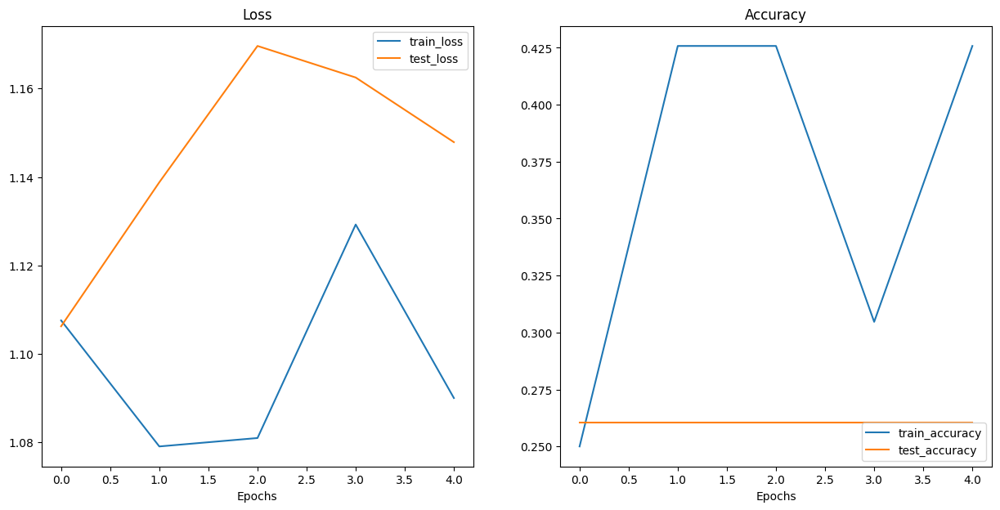

In [56]:
plot_loss_curves(model_1_results)

The loss curves indicate that the model isn't learning effectively.


## Comparative Results Analysis: 'Model_0' vs. 'Model_1'

To compare the results of 'model_0' and 'model_1', we will convert their respective results into pandas DataFrames. This conversion will enable us to plot and visualize the loss curves for both models effectively:



In [57]:
import pandas as pd

model_0_df = pd.DataFrame(model_0_results)
model_1_df = pd.DataFrame(model_1_results)
model_0_df

,train_loss,train_acc,test_loss,test_acc
0,1.107836,0.257812,1.136207,0.260417
1,1.084643,0.425781,1.162172,0.197917
2,1.115315,0.292969,1.169423,0.197917
3,1.099233,0.289062,1.133897,0.197917
4,1.098865,0.292969,1.143793,0.197917


With the data now in DataFrame format, we can plot the loss curves for 'model_0' and 'model_1' to conduct a side-by-side comparison:





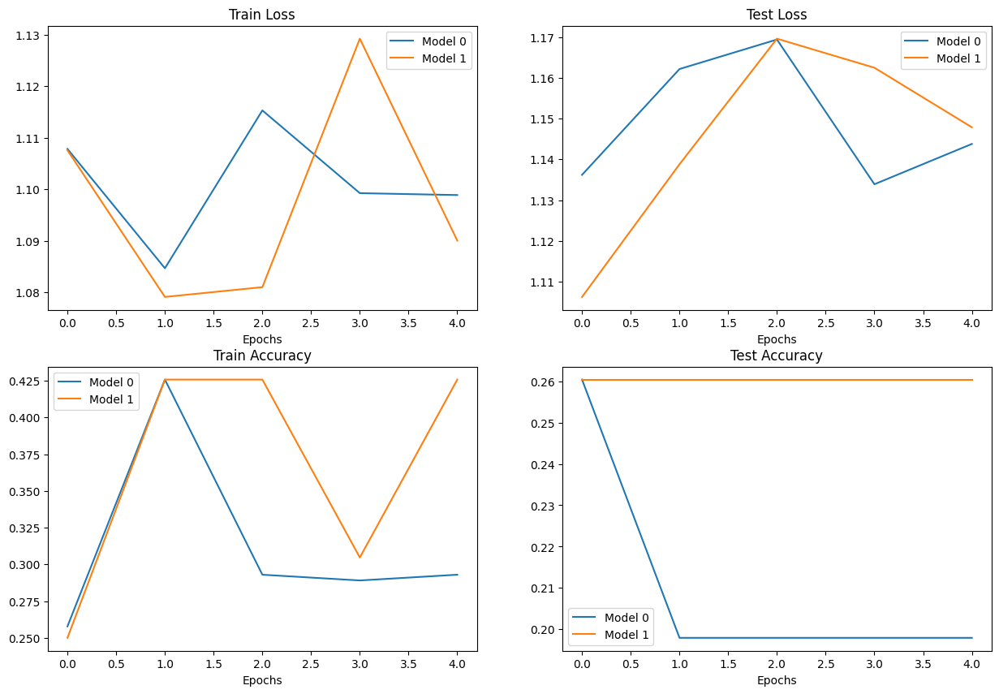

In [58]:
# Define the plot
plt.figure(figsize=(15, 10))

# Retrieve the number of epochs
epochs = range(len(model_0_df))

# Plotting the train loss
plt.subplot(2, 2, 1)
plt.plot(epochs, model_0_df["train_loss"], label="Model 0")
plt.plot(epochs, model_1_df["train_loss"], label="Model 1")
plt.title("Train Loss")
plt.xlabel("Epochs")
plt.legend()

# Plotting the test loss
plt.subplot(2, 2, 2)
plt.plot(epochs, model_0_df["test_loss"], label="Model 0")
plt.plot(epochs, model_1_df["test_loss"], label="Model 1")
plt.title("Test Loss")
plt.xlabel("Epochs")
plt.legend()

# Plotting the train accuracy
plt.subplot(2, 2, 3)
plt.plot(epochs, model_0_df["train_acc"], label="Model 0")
plt.plot(epochs, model_1_df["train_acc"], label="Model 1")
plt.title("Train Accuracy")
plt.xlabel("Epochs")
plt.legend()

# Plotting the test accuracy
plt.subplot(2, 2, 4)
plt.plot(epochs, model_0_df["test_acc"], label="Model 0")
plt.plot(epochs, model_1_df["test_acc"], label="Model 1")
plt.title("Test Accuracy")
plt.xlabel("Epochs")
plt.legend();

Upon reviewing the plotted loss curves, we observe that both models exhibit poor and erratic performance, characterized by sharp fluctuations in the metrics.



## Custom Image Prediction


 **Note:** To utilize the model for predicting on a custom image, we need to load and **preprocess the image to match the data type and format the model was trained on.** Specifically, this involves converting the custom image into a tensor and ensuring it has the correct data type before passing it to the model.

Let's begin by downloading a custom image and creating a transformation pipeline to resize it to the dimensions used during model training:


In [59]:
import requests

# Define the custom image path
custom_image_path = data_path / "custom_pizza_picture.jpg"

CUSTOM_IMAGE_URL = 'https://github.com/IsraelAzoulay/multi-class-image-classifier-computer-vision/raw/main/data/custom_pizza_picture.jpg'

# Download the image only if it doesn't already exist
if not custom_image_path.is_file():
    with open(custom_image_path, "wb") as f:
        request = requests.get(CUSTOM_IMAGE_URL)
        print(f"Downloading {custom_image_path}...")
        f.write(request.content)
else:
    print(f"The {custom_image_path} already exists. Skipping download.")

In [60]:
# Create the transform pipleine
custom_image_transform = transforms.Compose([
    transforms.Resize((64, 64)),])

Let's define a function named 'pred_and_plot_image()' to make a prediction on a target image and plot the image along with its prediction. This function will streamline the process of inference and visualization, providing a clear and concise output:

In [61]:
import torchvision

def pred_and_plot_image(model: torch.nn.Module,
                        image_path: str,
                        class_names: List[str] = None,
                        transform=None,
                        device: torch.device = device):
    """The function makes a prediction on a target image, and plots the image
    with its prediction."""
    # Read the image and convert the tensor values to float32
    target_image = torchvision.io.read_image(str(image_path)).type(torch.float32)

    # Normalise
    target_image = target_image / 255.

    # Apply the transform if necessary
    if transform:
        target_image = transform(target_image)

    # Set the model on the target device
    model.to(device)

    # Set the model to evaluation mode
    model.eval()
    # Activate the inference mode
    with torch.inference_mode():
        # Add an extra dimension to the image
        target_image = target_image.unsqueeze(dim=0)
        target_image_pred = model(target_image.to(device))

    # Convert the logits (the model output) to prediction probabilities
    target_image_pred_probs = torch.softmax(target_image_pred, dim=1)

    # Convert the prediction probabilities to prediction labels
    target_image_pred_label = torch.argmax(target_image_pred_probs, dim=1)

    # Plot the image
    plt.imshow(target_image.squeeze().permute(1, 2, 0))
    if class_names:
        title = f"Pred: {class_names[target_image_pred_label.cpu()]} | Prob: {target_image_pred_probs.max().cpu():.3f}"
    else:
        title = f"Pred: {target_image_pred_label} | Prob: {target_image_pred_probs.max().cpu():.3f}"
    plt.title(title)
    plt.axis(False);

torch.Size([1, 10, 32, 32])
torch.Size([1, 10, 16, 16])
torch.Size([1, 3])


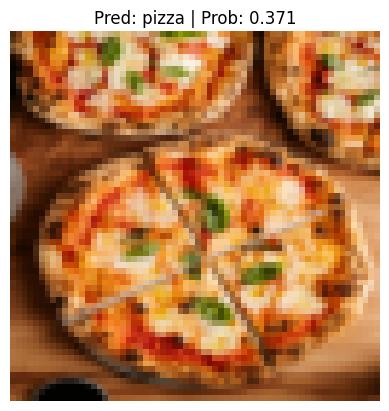

In [62]:
# Pred and plot on the custom image
pred_and_plot_image(model=model_1,
                    image_path=custom_image_path,
                    class_names=class_names,
                    transform=custom_image_transform,
                    device=device)

The model successfully made an accurate prediction, but its seems like it got it just by guessing. Thus, in the following sections let's proceed with additional modeling experiments using 'Transfer Learning Feature Extraction' and varying amounts of data to further enhance model performance.

Note that the image appears pixelated due to resizing it to [64, 64] using the 'custom_image_transform' transformation.



## Modularizing Python Scripts

After extensive code development for data preprocessing, model creation and training (including two models - 'model_0' and 'model_1'), it is essential to streamline the workflow. We will refactor critical code snippets (such as data loading with 'ImageFolder', creating transformations, and setting up train/test DataLoaders) into **modular Python scripts.** These scripts will be stored in a new directory named 'going_modular'. This approach allows us to reuse these components in future experiments without rewriting the code.

Let's first create the 'going_modular' directory, then convert the dataset and DataLoader creation code into a function named 'create_dataloaders()' and save it in a 'data_setup.p'y script file:

In [63]:
!mkdir -p going_modular
!touch going_modular/__init__.py

In [64]:
%%writefile going_modular/data_setup.py
"""
This file contains all the needed functionality for creating DataLoaders for
image classification data.
"""
import os
from torchvision import datasets, transforms
from torch.utils.data import DataLoader


NUM_WORKERS = os.cpu_count()

def create_dataloaders(
    train_dir: str,
    test_dir: str,
    transform: transforms.Compose,
    batch_size: int,
    num_workers: int=NUM_WORKERS
):
  """The function creates training and testing DataLoaders. It takes-in a training
  directory and testing directory path, turns them into Datasets and then into
  DataLoaders.

  Args:
    train_dir: Path to training directory.
    test_dir: Path to testing directory.
    transform: torchvision transforms to perform on training and testing data.
    batch_size: Number of samples per batch in each of the DataLoaders.
    num_workers: An integer for number of workers per DataLoader.

  Returns:
    A tuple of (train_dataloader, test_dataloader, class_names), where 'class_names'
    is a list of the target classes.
  """
  # Load and transform the data
  train_data = datasets.ImageFolder(train_dir, transform=transform)
  test_data = datasets.ImageFolder(test_dir, transform=transform)

  # Retrieve class names
  class_names = train_data.classes

  # Create the train and test DataLoaders
  train_dataloader = DataLoader(
      train_data,
      batch_size=batch_size,
      shuffle=True,
      num_workers=num_workers,
      pin_memory=True,
  )
  test_dataloader = DataLoader(
      test_data,
      batch_size=batch_size,
      shuffle=False,
      num_workers=num_workers,
      pin_memory=True,
  )

  return train_dataloader, test_dataloader, class_names

Writing going_modular/data_setup.py


Placing the TinyVGG() model class into a script file named 'model_builder.py':

In [65]:
%%writefile going_modular/model_builder.py
"""
This file contains the model code to instantiate a TinyVGG model.
"""
import torch
from torch import nn


class TinyVGG(nn.Module):
  """This class creates the TinyVGG architecture. It replicates the TinyVGG
  architecture from the CNN explainer website in PyTorch.

  Args:
    input_shape: An integer indicating number of input channels.
    hidden_units: An integer indicating number of hidden units between layers.
    output_shape: An integer indicating number of output units.
  """
  def __init__(self, input_shape: int, hidden_units: int, output_shape: int) -> None:
      super().__init__()
      self.conv_block_1 = nn.Sequential(
          nn.Conv2d(in_channels=input_shape,
                    out_channels=hidden_units,
                    kernel_size=3,
                    stride=1,
                    padding=0),
          nn.ReLU(),
          nn.Conv2d(in_channels=hidden_units,
                    out_channels=hidden_units,
                    kernel_size=3,
                    stride=1,
                    padding=0),
          nn.ReLU(),
          nn.MaxPool2d(kernel_size=2,
                        stride=2)
      )
      self.conv_block_2 = nn.Sequential(
          nn.Conv2d(hidden_units, hidden_units, kernel_size=3, padding=0),
          nn.ReLU(),
          nn.Conv2d(hidden_units, hidden_units, kernel_size=3, padding=0),
          nn.ReLU(),
          nn.MaxPool2d(2)
      )
      self.classifier = nn.Sequential(
          nn.Flatten(),
          nn.Linear(in_features=hidden_units*13*13,
                    out_features=output_shape)
      )

    # Overwrite the forward pass function
  def forward(self, x: torch.Tensor):
      x = self.conv_block_1(x)
      x = self.conv_block_2(x)
      x = self.classifier(x)
      return x
      # Could use the following command instaed, in order to leverage the benefits of operator fusion
      # return self.classifier(self.conv_block_2(self.conv_block_1(x)))


Writing going_modular/model_builder.py


Defining 'train_step()', 'test_step()' and a 'train()' function to combine them. Storing these functions in a script named 'engine.py':

In [66]:
%%writefile going_modular/engine.py
"""
This file contains all the functions for training and testing a model.
"""
import torch
from tqdm.auto import tqdm
from typing import Dict, List, Tuple


def train_step(model: torch.nn.Module,
               dataloader: torch.utils.data.DataLoader,
               loss_fn: torch.nn.Module,
               optimizer: torch.optim.Optimizer,
               device: torch.device) -> Tuple[float, float]:
  """The function trains a model for a single epoch. It sets a target model to
  training mode, and then runs through all of the required training steps (forward
  pass, loss calculation, optimizer step).

  Args:
    model: A PyTorch model to be trained.
    dataloader: A DataLoader instance for the model to be trained on.
    loss_fn: A PyTorch loss function to minimize.
    optimizer: A PyTorch optimizer to help minimize the loss function.
    device: A target device to compute on (e.g. "cuda" or "cpu").

  Returns:
    A tuple of training loss and training accuracy metrics.
    In the form (train_loss, train_accuracy).
  """
  # Set the model to traininig mode
  model.train()

  # Define the train loss and train accuracy values
  train_loss, train_acc = 0, 0

  # Loop through the data loader data batches
  for batch, (X, y) in enumerate(dataloader):
      # Sets the data to the target device
      X, y = X.to(device), y.to(device)

      # Apply the forward pass
      y_pred = model(X)

      # Calculate and accumulate the loss
      loss = loss_fn(y_pred, y)
      train_loss += loss.item()

      # Apply the optimizer zero grad
      optimizer.zero_grad()

      # Apply the loss backward
      loss.backward()

      # Apply the optimizer step
      optimizer.step()

      # Calculate and accumulate the accuracy metric across all batches
      y_pred_class = torch.argmax(torch.softmax(y_pred, dim=1), dim=1)
      train_acc += (y_pred_class == y).sum().item()/len(y_pred)

  # Modify the metrics to get the average loss and accuracy per batch
  train_loss = train_loss / len(dataloader)
  train_acc = train_acc / len(dataloader)

  return train_loss, train_acc


def test_step(model: torch.nn.Module,
              dataloader: torch.utils.data.DataLoader,
              loss_fn: torch.nn.Module,
              device: torch.device) -> Tuple[float, float]:
  """The function tests a model for a single epoch. It sets a target model to
  "eval" mode, and then performs a forward pass on a testing dataset.

  Args:
    model: A PyTorch model to be tested.
    dataloader: A DataLoader instance for the model to be tested on.
    loss_fn: A PyTorch loss function to calculate loss on the test data.
    device: A target device to compute on (e.g. "cuda" or "cpu").

  Returns:
    A tuple of testing loss and testing accuracy metrics.
    In the form (test_loss, test_accuracy).
  """
  # Set the model to eval mode
  model.eval()

  # Define the test loss and test accuracy values
  test_loss, test_acc = 0, 0

  # Activate the inference context manager
  with torch.inference_mode():
      # Loop through the DataLoader batches
      for batch, (X, y) in enumerate(dataloader):
          # Set the data to the target device
          X, y = X.to(device), y.to(device)

          # Apply the forward pass
          test_pred_logits = model(X)

          # Calculate and accumulate the loss
          loss = loss_fn(test_pred_logits, y)
          test_loss += loss.item()

          # Calculate and accumulate the accuracy
          test_pred_labels = test_pred_logits.argmax(dim=1)
          test_acc += ((test_pred_labels == y).sum().item()/len(test_pred_labels))

  # Mofiy the metrics to get the average loss and accuracy per batch
  test_loss = test_loss / len(dataloader)
  test_acc = test_acc / len(dataloader)

  return test_loss, test_acc


def train(model: torch.nn.Module,
          train_dataloader: torch.utils.data.DataLoader,
          test_dataloader: torch.utils.data.DataLoader,
          optimizer: torch.optim.Optimizer,
          loss_fn: torch.nn.Module,
          epochs: int,
          device: torch.device) -> Dict[str, List]:
  """This function trains and tests a model. It passes a target models through
  the train_step() and test_step() functions for a number of epochs, training and
  testing the model in the same epoch loop. It calculates, prints and stores
  the evaluation metrics throughout.

  Args:
    model: A PyTorch model to be trained and tested.
    train_dataloader: A DataLoader instance for the model to be trained on.
    test_dataloader: A DataLoader instance for the model to be tested on.
    optimizer: A PyTorch optimizer to help minimize the loss function.
    loss_fn: A PyTorch loss function to calculate loss on both datasets.
    epochs: An integer indicating how many epochs to train for.
    device: A target device to compute on (e.g. "cuda" or "cpu").

  Returns:
    A dictionary of training and testing loss as well as training and
    testing accuracy metrics. Each metric has a value in a list for
    each epoch.
    In the form: {train_loss: [...],
                  train_acc: [...],
                  test_loss: [...],
                  test_acc: [...]}
  """
  # Define an empty results dictionary
  results = {"train_loss": [],
      "train_acc": [],
      "test_loss": [],
      "test_acc": []
  }

  # Loop through the training and testing steps for a number of epochs
  for epoch in tqdm(range(epochs)):
      train_loss, train_acc = train_step(model=model,
                                          dataloader=train_dataloader,
                                          loss_fn=loss_fn,
                                          optimizer=optimizer,
                                          device=device)
      test_loss, test_acc = test_step(model=model,
                                      dataloader=test_dataloader,
                                      loss_fn=loss_fn,
                                      device=device)

      # Print statements
      print(
          f"Epoch: {epoch+1} | "
          f"train_loss: {train_loss:.4f} | "
          f"train_acc: {train_acc:.4f} | "
          f"test_loss: {test_loss:.4f} | "
          f"test_acc: {test_acc:.4f}"
      )

      # Update the results dictionary accordingly
      results["train_loss"].append(train_loss)
      results["train_acc"].append(train_acc)
      results["test_loss"].append(test_loss)
      results["test_acc"].append(test_acc)

  return results

Writing going_modular/engine.py


Create a function 'save_model()' for saving models to a directory, and save it in a 'utils.py' script file:

In [67]:
%%writefile going_modular/utils.py
"""
This file contains all the various utility functions for a model training and saving.
"""
import torch
from pathlib import Path


def save_model(model: torch.nn.Module,
               target_dir: str,
               model_name: str):
  """This function saves a model to a target directory.

  Args:
    model: A target PyTorch model to save.
    target_dir: A directory for saving the model to.
    model_name: A filename for the saved model. Should include either ".pth",
    or ".pt" as the file extension.
  """
  # Create the target directory
  target_dir_path = Path(target_dir)
  target_dir_path.mkdir(parents=True,
                        exist_ok=True)

  # Create the model's save path
  assert model_name.endswith(".pth") or model_name.endswith(".pt"), "model_name should end with '.pt' or '.pth'"
  model_save_path = target_dir_path / model_name

  # Save the model's state_dict()
  print(f"[INFO] Saving model to: {model_save_path}")
  torch.save(obj=model.state_dict(), f=model_save_path)

Writing going_modular/utils.py


Combine all the modular scripts into a single script named 'train.py'. This script will integrate all functions and classes, enabling seamless model training:

(By organizing the code into these modular scripts, we can run the training process efficiently with a single command line entry 'python going_modular/train.py', or directly from a notebook using '!python going_modular/train.py').

In [68]:
%%writefile going_modular/train.py
"""
This file trains a image classification model on device agnostic code.
"""
import os
import torch
from . import data_setup, engine, model_builder, utils
from torchvision import transforms


# Define the hyperparameters
NUM_EPOCHS = 5
BATCH_SIZE = 32
HIDDEN_UNITS = 10
LEARNING_RATE = 0.001

# Define the directories
train_dir = "data/pizza_steak_sushi/train"
test_dir = "data/pizza_steak_sushi/test"

# Define the target device
device = "cuda" if torch.cuda.is_available() else "cpu"

# Create the transform pipeline
data_transform = transforms.Compose([
  transforms.Resize((64, 64)),
  transforms.ToTensor()
])

# Create the train and test DataLoaders
train_dataloader, test_dataloader, class_names = data_setup.create_dataloaders(
    train_dir=train_dir,
    test_dir=test_dir,
    transform=data_transform,
    batch_size=BATCH_SIZE
)

# Create the model and set it on the device
model = model_builder.TinyVGG(
    input_shape=3,
    hidden_units=HIDDEN_UNITS,
    output_shape=len(class_names)
).to(device)

# Define the loss function
loss_fn = torch.nn.CrossEntropyLoss()
# Define the optimizer
optimizer = torch.optim.Adam(model.parameters(),
                             lr=LEARNING_RATE)

# Begin the training process
engine.train(model=model,
             train_dataloader=train_dataloader,
             test_dataloader=test_dataloader,
             loss_fn=loss_fn,
             optimizer=optimizer,
             epochs=NUM_EPOCHS,
             device=device)

# Save the model
utils.save_model(model=model,
                 target_dir="models",
                 model_name="going_modular_script_mode_tinyvgg_model.pth")

Writing going_modular/train.py


## Transfer Learning: Extracting Features Using Torchvision Pretrained Models

In this experiment, we will continue using the **same subset of the dataset**. However, we will employ Transfer Learning Feature Extraction for modeling by leveraging the 'PyTorch domain libraries', specifically 'torchvision.models' for computer vision applications.

Although it is unnecessary to re-download and set up the train and test directories since we are using the same dataset subset, we will reconfigure them for practice purposes:

In [70]:
from going_modular import data_setup, model_builder, engine, utils, train

In [71]:
# Define and display the directories paths
train_dir = image_path / "train"
test_dir = image_path / "test"
train_dir, test_dir

(PosixPath('data/pizza_steak_sushi/train'),
 PosixPath('data/pizza_steak_sushi/test'))

**Pretrained Model Considerations:**

When utilizing a pretrained model, it is crucial to ensure that the **input dataset is prepared similarly to the original training data used for the model.** This preparation can be achieved through manual or automatic transforms.

1. Manual Transforms:

 - Advantages: Flexibility to define and set transforms, including data augmentation steps.
 - Considerations: While easy to create, they may be more complex than necessary in some situations.

2. Automatic Transforms:

 - Advantages: Simplicity and consistency, particularly with 'torchvision v0.13+' which allows using the same data transformations as the pretrained model via weights.transforms().
 - Considerations: Limited customization options.

For this experiement, despite opting for automatic transforms, we will first create and practice with manual transforms using the previously developed modular scripts:


In [72]:
# Creating a "manual" transforms pipeline
manual_transforms = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406],
                         std=[0.229, 0.224, 0.225])
])

In [73]:
# Create and dispaly the training and testing DataLoaders besides to the list of class names
train_dataloader, test_dataloader, class_names = data_setup.create_dataloaders(train_dir=train_dir,
                                                                               test_dir=test_dir,
                                                                               transform=manual_transforms,
                                                                               batch_size=32)
train_dataloader, test_dataloader, class_names

(<torch.utils.data.dataloader.DataLoader at 0x79d39a08a200>,
 ['pizza', 'steak', 'sushi'])

### Pretrained Model Procurement, Tracking and Training

We opted to utilize the 'EfficientNet_B0' pretrained model for its robust performance in various image classification tasks. Following this, let's implement an automated transformation pipeline:

In [74]:
# Get and dispaly the pretrained 'efficientnet_b0' model's weights
weights = torchvision.models.EfficientNet_B0_Weights.DEFAULT
weights

EfficientNet_B0_Weights.IMAGENET1K_V1

In [75]:
# Get and display the pretrained model's transforms
auto_transforms = weights.transforms()
auto_transforms

ImageClassification(
    crop_size=[224]
    resize_size=[256]
    mean=[0.485, 0.456, 0.406]
    std=[0.229, 0.224, 0.225]
    interpolation=InterpolationMode.BICUBIC
)

**Note:** The process for creating the DataLoader remains consistent with the previous implementation for the manual transformation.

In [76]:
# Create and dispaly the training and testing DataLoaders besides to the list of class names
train_dataloader, test_dataloader, class_names = data_setup.create_dataloaders(train_dir=train_dir,
                                                                               test_dir=test_dir,
                                                                               transform=auto_transforms,
                                                                               batch_size=32)
train_dataloader, test_dataloader, class_names

(<torch.utils.data.dataloader.DataLoader at 0x79d399f676d0>,
 ['pizza', 'steak', 'sushi'])

In [77]:
# Set up the pretrained model
model = torchvision.models.efficientnet_b0(weights=weights).to(device)

Downloading: "https://download.pytorch.org/models/efficientnet_b0_rwightman-7f5810bc.pth" to /root/.cache/torch/hub/checkpoints/efficientnet_b0_rwightman-7f5810bc.pth
100%|██████████| 20.5M/20.5M [00:00<00:00, 67.5MB/s]


In [78]:
# Dispaly the summary of the pretrained model (by using 'torchinfo')
summary(model=model,
        input_size=(32, 3, 224, 224),
        col_names=["input_size", "output_size", "num_params", "trainable"],
        col_width=20,
        row_settings=["var_names"])

Layer (type (var_name))                                      Input Shape          Output Shape         Param #              Trainable
EfficientNet (EfficientNet)                                  [32, 3, 224, 224]    [32, 1000]           --                   True
├─Sequential (features)                                      [32, 3, 224, 224]    [32, 1280, 7, 7]     --                   True
│    └─Conv2dNormActivation (0)                              [32, 3, 224, 224]    [32, 32, 112, 112]   --                   True
│    │    └─Conv2d (0)                                       [32, 3, 224, 224]    [32, 32, 112, 112]   864                  True
│    │    └─BatchNorm2d (1)                                  [32, 32, 112, 112]   [32, 32, 112, 112]   64                   True
│    │    └─SiLU (2)                                         [32, 32, 112, 112]   [32, 32, 112, 112]   --                   --
│    └─Sequential (1)                                        [32, 32, 112, 112]   [32, 16, 112

The summary output provides a detailed overview of the input and output shape transformations as the image data progresses through the model. Additionally, it highlights the extensive total parameters (pretrained weights) that enhance pattern recognition in the data.

In [79]:
# Freeze all the layers in the "features" section of the base model (pretrained model)
for param in model.features.parameters():
    param.requires_grad = False

**Explanation of 'Freezing' Layers:**

Freezing layers means maintaining their existing state during training. For instance, if a model contains pretrained layers, freezing them ensures that the patterns in these layers remain **unchanged** throughout training. This approach preserves the pretrained weights and patterns acquired from 'ImageNet', serving as a backbone while only the output layers are updated.

**Note:** To ensure reproducibility, we will frequently set the random seed. Hence, let's encapsulate this functionality in a 'set_seeds()' function to streamline the process for PyTorch operations:



In [80]:
def set_seeds(seed: int=42):
    """This function sets the random seeds for torch operations.

    Args:
        seed (int, optional): Random seed to set. Defaults to 42.
    """
    # Setting the seed for the general torch operations
    torch.manual_seed(seed)
    # Setting the seed for CUDA torch operations, which are the ones that happen on the GPU
    torch.cuda.manual_seed(seed)

In [81]:
# Set the random seeds
set_seeds()

# Retrieve the length of the class names
output_shape = len(class_names)

# Update the classifier layer, and set it to the target device
model.classifier = torch.nn.Sequential(
    torch.nn.Dropout(p=0.2, inplace=True),
    torch.nn.Linear(in_features=1280,
                    out_features=output_shape,
                    bias=True)).to(device)

In [82]:
# Dispaly the summary of the pretrained model in order to view the updates made
summary(model,
        input_size=(32, 3, 224, 224),
        verbose=0,
        col_names=["input_size", "output_size", "num_params", "trainable"],
        col_width=20,
        row_settings=["var_names"])

Layer (type (var_name))                                      Input Shape          Output Shape         Param #              Trainable
EfficientNet (EfficientNet)                                  [32, 3, 224, 224]    [32, 3]              --                   Partial
├─Sequential (features)                                      [32, 3, 224, 224]    [32, 1280, 7, 7]     --                   False
│    └─Conv2dNormActivation (0)                              [32, 3, 224, 224]    [32, 32, 112, 112]   --                   False
│    │    └─Conv2d (0)                                       [32, 3, 224, 224]    [32, 32, 112, 112]   (864)                False
│    │    └─BatchNorm2d (1)                                  [32, 32, 112, 112]   [32, 32, 112, 112]   (64)                 False
│    │    └─SiLU (2)                                         [32, 32, 112, 112]   [32, 32, 112, 112]   --                   --
│    └─Sequential (1)                                        [32, 32, 112, 112]   [32, 

Before initiating the training process, let's define the loss function and the optimizer:

In [83]:
# Define the loss function
loss_fn = nn.CrossEntropyLoss()
# Define the optimizer
optimizer = torch.optim.Adam(model.parameters(), lr=0.001)

**Explanation of Tracking Modeling Experiments with TensorBoard:**

Previously, we tracked the modeling experiments using multiple Python dictionaries, which quickly become unmanageable with more than a few experiments. To streamline this process, we can utilize PyTorch's 'torch.utils.tensorboard.SummaryWriter' class to document various aspects of the model's training progress.

TensorBoard is part of the TensorFlow deep learning library, offering an excellent visualization tool for different parts of your model. To begin tracking our experiments, we should create a default **'SummaryWriter'** instance before initiating model training.

We can integrate the 'SummaryWriter' into the existing training function, 'train()', located in 'engine.py'. By modifying this function, we can log the model's training and test loss and accuracy values using 'writer.add_scalars(main_tag, tag_scalar_dict)' where:

 - 'main_tag' (string): The name for the scalars being tracked (e.g., "Accuracy").
 - 'tag_scalar_dict' (dict): A dictionary of the values being tracked (e.g., {"train_loss": 0.567}).

The 'add_scalars' method is aptly named as it logs scalar values, such as loss and accuracy. The SummaryWriter class also provides various methods to track different aspects of the model or data, like 'add_graph()' which logs the computation graph of the model.








In [84]:
from torch.utils.tensorboard import SummaryWriter

# Creating a writer with its default settings
writer = SummaryWriter()

Let's now import the existing ‘train()’ function from the ‘engine.py’ script (which was previously modularized), and update the function according to the guidelines explained earlier:

In [85]:
from typing import Dict, List
from going_modular.engine import train_step, test_step


def train(model: torch.nn.Module,
          train_dataloader: torch.utils.data.DataLoader,
          test_dataloader: torch.utils.data.DataLoader,
          optimizer: torch.optim.Optimizer,
          loss_fn: torch.nn.Module,
          epochs: int,
          device: torch.device) -> Dict[str, List]:
    """This function trains and tests a model. It passes a target models through
    the train_step() and test_step() functions for a number of epochs, training
    and testing the model in the same epoch loop. It calculates, prints and stores
    the evaluation metrics throughout.

    Args:
      model: A model to be trained and tested.
      train_dataloader: A DataLoader instance for the model to be trained on.
      test_dataloader: A DataLoader instance for the model to be tested on.
      optimizer: An optimizer to help minimize the loss function.
      loss_fn: A loss function to calculate loss on both datasets.
      epochs: An integer indicating how many epochs to train for.
      device: A target device to compute on (e.g. "cuda" or "cpu").

    Returns:
      A dictionary of training and testing loss as well as training and
      testing accuracy metrics. Each metric has a value in a list for
      each epoch.
      In the form: {train_loss: [...],
                train_acc: [...],
                test_loss: [...],
                test_acc: [...]}
    """
    # Define an empty results dictionary
    results = {"train_loss": [],
               "train_acc": [],
               "test_loss": [],
               "test_acc": []
    }

    # Loop through the training and testing steps for some epochs
    for epoch in tqdm(range(epochs)):
        train_loss, train_acc = train_step(model=model,
                                           dataloader=train_dataloader,
                                           loss_fn=loss_fn,
                                           optimizer=optimizer,
                                           device=device)
        test_loss, test_acc = test_step(model=model,
                                        dataloader=test_dataloader,
                                        loss_fn=loss_fn,
                                        device=device)

        # Print statements
        print(
          f"Epoch: {epoch+1} | "
          f"train_loss: {train_loss:.4f} | "
          f"train_acc: {train_acc:.4f} | "
          f"test_loss: {test_loss:.4f} | "
          f"test_acc: {test_acc:.4f}"
        )

        # Updating the results dictionary accordingly
        results["train_loss"].append(train_loss)
        results["train_acc"].append(train_acc)
        results["test_loss"].append(test_loss)
        results["test_acc"].append(test_acc)

        # Adding the loss results to the SummaryWriter (for tracking the modeling experiemtns)
        writer.add_scalars(main_tag="Loss",
                           tag_scalar_dict={"train_loss": train_loss,
                                            "test_loss": test_loss},
                           global_step=epoch)

        # Adding the accuracy results to the SummaryWriter (for tracking the modeling experiemtns)
        writer.add_scalars(main_tag="Accuracy",
                           tag_scalar_dict={"train_acc": train_acc,
                                            "test_acc": test_acc},
                           global_step=epoch)

        # Tracking the model's architecture
        writer.add_graph(model=model,
                         # Passing-in an example input, and setting it to the device
                         input_to_model=torch.randn(32, 3, 224, 224).to(device))

    # Closing the writer
    writer.close()

    return results

In [86]:
# Set the random seeds
set_seeds()

# Train the model with the updated 'train()' function
results = train(model=model,
                train_dataloader=train_dataloader,
                test_dataloader=test_dataloader,
                optimizer=optimizer,
                loss_fn=loss_fn,
                epochs=5,
                device=device)

  0%|          | 0/5 [00:00<?, ?it/s]

/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()
/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()


Epoch: 1 | train_loss: 1.0924 | train_acc: 0.3984 | test_loss: 0.9133 | test_acc: 0.5398
Epoch: 2 | train_loss: 0.8975 | train_acc: 0.6562 | test_loss: 0.7837 | test_acc: 0.8561
Epoch: 3 | train_loss: 0.8038 | train_acc: 0.7461 | test_loss: 0.6723 | test_acc: 0.8864
Epoch: 4 | train_loss: 0.6770 | train_acc: 0.8516 | test_loss: 0.6699 | test_acc: 0.8049
Epoch: 5 | train_loss: 0.7065 | train_acc: 0.7188 | test_loss: 0.6746 | test_acc: 0.7737


In [87]:
# Display the model's results
results

{'train_loss': [1.0924270078539848,
  0.8974936828017235,
  0.8037795424461365,
  0.6769560724496841,
  0.7065097987651825],
 'train_acc': [0.3984375, 0.65625, 0.74609375, 0.8515625, 0.71875],
 'test_loss': [0.9132681290308634,
  0.7837486465771993,
  0.672318716843923,
  0.6698532303174337,
  0.6746145089467367],
 'test_acc': [0.5397727272727273,
  0.8560606060606061,
  0.8863636363636364,
  0.8049242424242425,
  0.7736742424242425]}

### Visualizing Model Experiments Using TensorBoard


In [88]:
# View the model's experiemtns on TensorBoard
%load_ext tensorboard
%tensorboard --logdir runs

<IPython.core.display.Javascript object>

The SummaryWriter() class facilitates the logging of various metrics and information to a specified directory, as indicated by the 'log_dir' parameter.

To ensure clarity and organization, particularly when managing multiple experiments, let's implement a helper function that generates a unique directory for each experiment. This approach ensures that each experiment's logs are maintained in an isolated and orderly manner:


In [89]:
def create_writer(experiment_name: str,
                  model_name: str,
                  extra: str=None) -> torch.utils.tensorboard.writer.SummaryWriter():
    """This function creates a 'SummaryWriter()' instance, saving to a specific 'log_dir'.
    'log_dir' is a combination of 'runs/timestamp/experiment_name/model_name/extra',
    where 'timestamp' is the current date in the YYYY-MM-DD format.

    Args:
        experiment_name (str): Name of experiment.
        model_name (str): Name of model.
        extra (str, optional): Anything extra to add to the directory. Defaults to None.

    Returns:
        torch.utils.tensorboard.writer.SummaryWriter(): Instance of a writer saving to 'log_dir'.
    """
    from datetime import datetime
    import os

    # Retrieve the timestamp of the current date
    timestamp = datetime.now().strftime("%Y-%m-%d")

    if extra:
        # Define the log directory path
        log_dir = os.path.join("runs", timestamp, experiment_name, model_name, extra)
    else:
        log_dir = os.path.join("runs", timestamp, experiment_name, model_name)

    print(f"Created SummaryWriter. Saving to: {log_dir}...")

    return SummaryWriter(log_dir=log_dir)

In [90]:
# Create an example writer for testing out the 'create_write()' function we just created
example_writer = create_writer(experiment_name="data_10_percent",
                               model_name="effnetb0",
                               extra="5_epochs")

Created SummaryWriter. Saving to: runs/2024-07-28/data_10_percent/effnetb0/5_epochs...


To enhance the tracking capabilities of the model training experiments, let's update the 'train()' function within the 'engine.py' script. This revision will incorporate a summary writer step, enabling us to monitor multiple modeling experiments simultaneously rather than limiting the scope to a single experiment:

In [91]:
def train(model: torch.nn.Module,
          train_dataloader: torch.utils.data.DataLoader,
          test_dataloader: torch.utils.data.DataLoader,
          optimizer: torch.optim.Optimizer,
          loss_fn: torch.nn.Module,
          epochs: int,
          device: torch.device,
          writer: torch.utils.tensorboard.writer.SummaryWriter
          ) -> Dict[str, List]:
    """This function trains and tests a model. It passes a target models through
    the train_step() and test_step() functions for a number of epochs, training
    and testing the model in the same epoch loop. It calculates, prints and stores
    the evaluation metrics throughout. It stores the metrics to sa pecified writer
    'log_dir' if present.

    Args:
      model: A model to be trained and tested.
      train_dataloader: A DataLoader instance for the model to be trained on.
      test_dataloader: A DataLoader instance for the model to be tested on.
      optimizer: An optimizer to help minimize the loss function.
      loss_fn: A loss function to calculate loss on both datasets.
      epochs: An integer indicating how many epochs to train for.
      device: A target device to compute on (e.g. "cuda" or "cpu").
      writer: A SummaryWriter() instance to log model results to.

    Returns:
      A dictionary of training and testing loss as well as training and
      testing accuracy metrics. Each metric has a value in a list for
      each epoch.
      In the form: {train_loss: [...],
                train_acc: [...],
                test_loss: [...],
                test_acc: [...]}
    """
    # Define an empty results dictionary
    results = {"train_loss": [],
               "train_acc": [],
               "test_loss": [],
               "test_acc": []
    }

    # Loop through the training and testing steps for some epochs
    for epoch in tqdm(range(epochs)):
        train_loss, train_acc = train_step(model=model,
                                          dataloader=train_dataloader,
                                          loss_fn=loss_fn,
                                          optimizer=optimizer,
                                          device=device)
        test_loss, test_acc = test_step(model=model,
                                        dataloader=test_dataloader,
                                        loss_fn=loss_fn,
                                        device=device)

        # Print statements
        print(
          f"Epoch: {epoch+1} | "
          f"train_loss: {train_loss:.4f} | "
          f"train_acc: {train_acc:.4f} | "
          f"test_loss: {test_loss:.4f} | "
          f"test_acc: {test_acc:.4f}"
        )

        # Updating the results dictionary accordingly
        results["train_loss"].append(train_loss)
        results["train_acc"].append(train_acc)
        results["test_loss"].append(test_loss)
        results["test_acc"].append(test_acc)

        # Checking out if there's a writer. If so, logging to it
        if writer:
            writer.add_scalars(main_tag="Loss",
                               tag_scalar_dict={"train_loss": train_loss,
                                                "test_loss": test_loss},
                               global_step=epoch)
            writer.add_scalars(main_tag="Accuracy",
                               tag_scalar_dict={"train_acc": train_acc,
                                                "test_acc": test_acc},
                               global_step=epoch)

            # Closing the writer
            writer.close()
        else:
            pass

    return results

### Additional Transfer Learning Feature Extraction Modeling Experiments

**Modeling Experiments:**

To advance the modeling experiments, we will initiate several hyperparameter variations to explore different outcomes. Each hyperparameter serves as the basis for a distinct experiment:
- Adjust the number of epochs.
- Modify the number of layers or hidden units.
- Vary the dataset size.
- Change the learning rate.
- Apply different data augmentation techniques.
- Select an alternative model architecture.

We will experiment with the following combinations:
- Varying dataset sizes: 10% vs. 20% of the total data.
- Different model architectures: 'torchvision.models.efficientnet_b0' vs. 'torchvision.models.efficientnet_b2'.
- Different training durations: 5 epochs vs. 10 epochs.

For these experiments, we require two versions of the training set:
1. A training set comprising **10%** of the data.
2. A training set comprising **20%** of the data.

**Note:** All experiments will maintain consistency by using the **same testing dataset** derived from the **10%** data split.



#### Get the Data (10% and 20% of the dataset)

Let's start downloading the necessary datasets by first implementing a 'download_data()' function for downloading a zipped dataset from a source and unzipping it to a destination. Although we have already downloaded the 10% training data subset, we will redownload it to ensure completeness and consistency:

In [92]:
def download_data(source: str,
                  destination: str,
                  remove_source: bool = True) -> Path:
    """This function downloads a zipped dataset from source and unzips to destination.

    Args:
        source (str): A link to a zipped file containing data.
        destination (str): A target directory to unzip data to.
        remove_source (bool): Whether to remove the source after downloading and extracting.

    Returns:
        'pathlib.Path' to downloaded data.
    """
    # Defining the path to the dataset folder
    data_path = Path("data/")
    image_path = data_path / destination

    # Verify the existence of the image folder. If it does not exist, proceed to download it
    if image_path.is_dir():
        print(f"The {image_path} directory exists. Skipping download.")
    else:
        print(f"Did not find {image_path} directory. Creating one...")
        image_path.mkdir(parents=True, exist_ok=True)

        # Download the dataset
        target_file = Path(source).name
        with open(data_path / target_file, "wb") as f:
            request = requests.get(source)
            print(f"Downloading {target_file} from {source}...")
            f.write(request.content)

        # Unzip the dataset
        with zipfile.ZipFile(data_path / target_file, "r") as zip_ref:
            print(f"Unzipping {target_file} dataset...")
            zip_ref.extractall(image_path)

        # Remove the '.zip' file
        if remove_source:
            os.remove(data_path / target_file)

    return image_path

In [93]:
# Downloading the 10% training data
data_10_percent_path = download_data(source="https://github.com/IsraelAzoulay/multi-class-image-classifier-computer-vision/raw/main/data/10_percent_dataset.zip",
                                     destination="pizza_steak_sushi")
# Downloading the 20% training data
data_20_percent_path = download_data(source="https://github.com/IsraelAzoulay/multi-class-image-classifier-computer-vision/raw/main/data/20_percent_dataset.zip",
                                     destination="pizza_steak_sushi_20_percent")

The data/pizza_steak_sushi directory exists. Skipping download.
Did not find data/pizza_steak_sushi_20_percent directory. Creating one...
Unzipping 20_percent_dataset.zip dataset...


In [94]:
# Define the 10% and 20% training directory paths
train_dir_10_percent = data_10_percent_path / "train"
train_dir_20_percent = data_20_percent_path / "train"

# Define the testing directory paths
test_dir = data_10_percent_path / "test"

# Display the directories
print(f"Training directory 10%: {train_dir_10_percent}")
print(f"Training directory 20%: {train_dir_20_percent}")
print(f"Testing directory: {test_dir}")

Training directory 10%: data/pizza_steak_sushi/train
Training directory 20%: data/pizza_steak_sushi_20_percent/train
Testing directory: data/pizza_steak_sushi/test


#### Preprocess the Data

We will now establish a consistent series of transformations to prepare the data images for the models. To maintain uniformity, let's manually create a transformation and apply it consistently across all datasets:

In [95]:
# Create the transform to normalize data distribution
normalize = transforms.Normalize(mean=[0.485, 0.456, 0.406],
                                 std=[0.229, 0.224, 0.225])

In [96]:
# Create the transforms complete pipeline (with the normalize transform created above integrated in it)
simple_transform = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
    normalize
])

In [97]:
# Define the bacth size hyper-parameter
BATCH_SIZE = 32

# Create the 10% training and test DataLoaders
train_dataloader_10_percent, test_dataloader, class_names = data_setup.create_dataloaders(train_dir=train_dir_10_percent,
                                                                                          test_dir=test_dir,
                                                                                          transform=simple_transform,
                                                                                          batch_size=BATCH_SIZE)

# Create the 20% training and test data DataLoders
train_dataloader_20_percent, test_dataloader, class_names = data_setup.create_dataloaders(train_dir=train_dir_20_percent,
                                                                                          test_dir=test_dir,
                                                                                          transform=simple_transform,
                                                                                          batch_size=BATCH_SIZE)

# Display the number of samples/batches per dataloader
print(f"Number of batches of size {BATCH_SIZE} in 10% training data: {len(train_dataloader_10_percent)}")
print(f"Number of batches of size {BATCH_SIZE} in 20% training data: {len(train_dataloader_20_percent)}")
print(f"Number of batches of size {BATCH_SIZE} in testing data: {len(train_dataloader_10_percent)} (all experiments will use the same test set.)")
print(f"Number of classes: {len(class_names)}, class names: {class_names}")

Number of batches of size 32 in 10% training data: 8
Number of batches of size 32 in 20% training data: 15
Number of batches of size 32 in testing data: 8 (all experiments will use the same test set.)
Number of classes: 3, class names: ['pizza', 'steak', 'sushi']


#### Pretrained Model Procurement, Tracking and Training

**Building Feature Extractor Models:**

We'll create 2 feature extractor models leveraging pretrained EfficientNet backbones with custom classifier heads:
1. EfficientNet-B0 ('torchvision.models.efficientnet_b0()')
2. EfficientNet-B2 ('torchvision.models.efficientnet_b2()')

For both models, the base layers (feature layers) will remain frozen while we update the classifier heads (output layers) to align with our specific problem requirements.

- **EfficientNet-B0:**

 - Earlier we saw that the 'in_features' parameter for the classifier head is 1280, meaning the backbone converts the input image into a feature vector of this size.

- **EfficientNet-B2:**

 - EfficientNet-B2 has different layers and parameters, necessitating adjustments to match its structure.

**Inspecting Model Shapes:**

Before adapting a model, it is crucial to inspect the input and output shapes. This helps ensure that the input data is prepared correctly and the model’s output shape is accurate. The 'torchinfo.summary()' function is instrumental in this process.

**We'll Apply the Following Steps to Determine the Shapes for EfficientNet-B2:**
1. Instantiate EfficientNet-B2: 'torchvision.models.efficientnet_b2(pretrained=True)'.
2. Use 'torchinfo.summary(') with 'input_size=(32, 3, 224, 224)' to explore input and output shapes. Here, '(32, 3, 224, 224)' represents '(batch_size, color_channels, height, width)', simulating a batch of data.
3. Verify the 'in_features' of the classifier by inspecting the 'state_dict()' and printing the length of the weight matrix. Alternatively, visually inspect the output of 'effnetb2.classifier'.


In [98]:
# Get the pretrained 'efficientnet_b2' model's weights
effnetb2_weights = torchvision.models.EfficientNet_B2_Weights.DEFAULT
# Create an instance of the pretrained 'efficientnet_b2' model
effnetb2 = torchvision.models.efficientnet_b2(weights=effnetb2_weights)

Downloading: "https://download.pytorch.org/models/efficientnet_b2_rwightman-c35c1473.pth" to /root/.cache/torch/hub/checkpoints/efficientnet_b2_rwightman-c35c1473.pth
100%|██████████| 35.2M/35.2M [00:00<00:00, 102MB/s] 


In [99]:
# Dispaly the summary of the pretrained 'efficientnet_b2' model
summary(model=effnetb2,
        input_size=(32, 3, 224, 224),
        col_names=["input_size", "output_size", "num_params", "trainable"],
        col_width=20,
        row_settings=["var_names"])

Layer (type (var_name))                                      Input Shape          Output Shape         Param #              Trainable
EfficientNet (EfficientNet)                                  [32, 3, 224, 224]    [32, 1000]           --                   True
├─Sequential (features)                                      [32, 3, 224, 224]    [32, 1408, 7, 7]     --                   True
│    └─Conv2dNormActivation (0)                              [32, 3, 224, 224]    [32, 32, 112, 112]   --                   True
│    │    └─Conv2d (0)                                       [32, 3, 224, 224]    [32, 32, 112, 112]   864                  True
│    │    └─BatchNorm2d (1)                                  [32, 32, 112, 112]   [32, 32, 112, 112]   64                   True
│    │    └─SiLU (2)                                         [32, 32, 112, 112]   [32, 32, 112, 112]   --                   --
│    └─Sequential (1)                                        [32, 32, 112, 112]   [32, 16, 112

In [100]:
# Retrieve and display the number of 'in_features' of the 'EfficientNetB2' classifier layer
print(f"Number of in_features to final layer of EfficientNetB2: {len(effnetb2.classifier.state_dict()['1.weight'][0])}")

Number of in_features to final layer of EfficientNetB2: 1408


With the required number of 'in_features' determined for the EfficientNetB2 model, let's create two functions - one to set up the EfficientNetB0 feature extractor and another to set up the EfficientNetB2 feature extractor:

In [101]:
# Retrieve the number of 'out_features'
OUT_FEATURES = len(class_names)


def create_effnetb0():
    # Get the pretrained 'efficientnet_b0' model's weights
    weights = torchvision.models.EfficientNet_B0_Weights.DEFAULT
    # Create an instance of the pretrained 'efficientnet_b0' model, and set it to the device
    model = torchvision.models.efficientnet_b0(weights=weights).to(device)

    # Freeze the base model layers (for 'Feature Extraction')
    for param in model.features.parameters():
        param.requires_grad = False

    # Set the random seeds
    set_seeds()

    # Update the classifier head to suit to our problem, and set it to the device
    model.classifier = nn.Sequential(
        nn.Dropout(p=0.2),
        nn.Linear(in_features=1280, out_features=OUT_FEATURES)
    ).to(device)

    # Name the model
    model.name = "effnetb0"
    print(f"Created new {model.name} model.")

    return model

In [102]:
def create_effnetb2():
    # Get the pretrained 'efficientnet_b2' model's weights
    weights = torchvision.models.EfficientNet_B2_Weights.DEFAULT
    # Create an instance of the pretrained 'efficientnet_b0' model, and set it to the device
    model = torchvision.models.efficientnet_b2(weights=weights).to(device)

    # Freeze the base model layers (for 'Feature Extraction')
    for param in model.features.parameters():
        param.requires_grad = False

    # Set the random seeds
    set_seeds()

    # Update the classifier head to suit to our problem, and set it to the device
    model.classifier = nn.Sequential(
        nn.Dropout(p=0.3),
        nn.Linear(in_features=1408, out_features=OUT_FEATURES)
    ).to(device)

    # Name the model
    model.name = "effnetb2"
    print(f"Created new {model.name} model.")

    return model

Let's test these functions by creating instances of EfficientNetB0 and EfficientNetB2 and examining their summaries:

In [103]:
effnetb0 = create_effnetb0()

# Dispaly the summary of the effnetb0 model
summary(model=effnetb0,
        input_size=(32, 3, 224, 224),
        col_names=["input_size", "output_size", "num_params", "trainable"],
        col_width=20,
        row_settings=["var_names"])

Created new effnetb0 model.


Layer (type (var_name))                                      Input Shape          Output Shape         Param #              Trainable
EfficientNet (EfficientNet)                                  [32, 3, 224, 224]    [32, 3]              --                   Partial
├─Sequential (features)                                      [32, 3, 224, 224]    [32, 1280, 7, 7]     --                   False
│    └─Conv2dNormActivation (0)                              [32, 3, 224, 224]    [32, 32, 112, 112]   --                   False
│    │    └─Conv2d (0)                                       [32, 3, 224, 224]    [32, 32, 112, 112]   (864)                False
│    │    └─BatchNorm2d (1)                                  [32, 32, 112, 112]   [32, 32, 112, 112]   (64)                 False
│    │    └─SiLU (2)                                         [32, 32, 112, 112]   [32, 32, 112, 112]   --                   --
│    └─Sequential (1)                                        [32, 32, 112, 112]   [32, 

In [104]:
effnetb2 = create_effnetb2()

# Dispaly the summary of the effnetb2 model
summary(model=effnetb2,
        input_size=(32, 3, 224, 224),
        col_names=["input_size", "output_size", "num_params", "trainable"],
        col_width=20,
        row_settings=["var_names"])

Created new effnetb2 model.


Layer (type (var_name))                                      Input Shape          Output Shape         Param #              Trainable
EfficientNet (EfficientNet)                                  [32, 3, 224, 224]    [32, 3]              --                   Partial
├─Sequential (features)                                      [32, 3, 224, 224]    [32, 1408, 7, 7]     --                   False
│    └─Conv2dNormActivation (0)                              [32, 3, 224, 224]    [32, 32, 112, 112]   --                   False
│    │    └─Conv2d (0)                                       [32, 3, 224, 224]    [32, 32, 112, 112]   (864)                False
│    │    └─BatchNorm2d (1)                                  [32, 32, 112, 112]   [32, 32, 112, 112]   (64)                 False
│    │    └─SiLU (2)                                         [32, 32, 112, 112]   [32, 32, 112, 112]   --                   --
│    └─Sequential (1)                                        [32, 32, 112, 112]   [32, 

With the data and models prepared, we can now conduct a series of experiments:

In [105]:
# Define the epochs list
num_epochs = [5, 10]

# Define the models list
models = ["effnetb0", "effnetb2"]

# Create trainng dataloaders dictionary for various dataloaders
train_dataloaders = {"data_10_percent": train_dataloader_10_percent,
                     "data_20_percent": train_dataloader_20_percent}

Let's iterate through various options and combinations, saving the model at the end of each experiment. This will allow us to reload the best performing model later for making predictions:


In [106]:
%%time
from going_modular.utils import save_model


# Set the random seeds
set_seeds(seed=42)

# Define the initial experiment number and set it to 0, in order to keep track of the experiment number
experiment_number = 0

# Loop through each DataLoader
for dataloader_name, train_dataloader in train_dataloaders.items():
    # Then, loop through each number of epochs
    for epochs in num_epochs:
        # Lastly, loop through each model name ,and create a new model based on the name
        for model_name in models:
            # Print statements
            experiment_number += 1
            print(f"Experiment number: {experiment_number}")
            print(f"Model: {model_name}")
            print(f"DataLoader: {dataloader_name}")
            print(f"Number of epochs: {epochs}")

            # Selecting the model
            if model_name == "effnetb0":
                model = create_effnetb0()
            else:
                model = create_effnetb2()

            # Define a new loss function for every model
            loss_fn = nn.CrossEntropyLoss()
            # Define a new optimizer for every model
            optimizer = torch.optim.Adam(params=model.parameters(), lr=0.001)

            # Train the target model with the target dataloaders, and track the experiments
            train(model=model,
                  train_dataloader=train_dataloader,
                  test_dataloader=test_dataloader,
                  optimizer=optimizer,
                  loss_fn=loss_fn,
                  epochs=epochs,
                  device=device,
                  writer=create_writer(experiment_name=dataloader_name,
                                       model_name=model_name,
                                       extra=f"{epochs}_epochs"))

            # Saving the model to a file
            save_filepath = f"{model_name}_{dataloader_name}_{epochs}_epochs.pth"
            save_model(model=model,
                       target_dir="models",
                       model_name=save_filepath)
            print("-"*50 + "\n")

Experiment number: 1
Model: effnetb0
DataLoader: data_10_percent
Number of epochs: 5
Created new effnetb0 model.
Created SummaryWriter. Saving to: runs/2024-07-28/data_10_percent/effnetb0/5_epochs...


  0%|          | 0/5 [00:00<?, ?it/s]

/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()
/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()


Epoch: 1 | train_loss: 1.0528 | train_acc: 0.4961 | test_loss: 0.9220 | test_acc: 0.4678
Epoch: 2 | train_loss: 0.8747 | train_acc: 0.6992 | test_loss: 0.8139 | test_acc: 0.6203
Epoch: 3 | train_loss: 0.8100 | train_acc: 0.6445 | test_loss: 0.7176 | test_acc: 0.8258
Epoch: 4 | train_loss: 0.7098 | train_acc: 0.7578 | test_loss: 0.5898 | test_acc: 0.8864
Epoch: 5 | train_loss: 0.5980 | train_acc: 0.9141 | test_loss: 0.5677 | test_acc: 0.8864
[INFO] Saving model to: models/effnetb0_data_10_percent_5_epochs.pth
--------------------------------------------------

Experiment number: 2
Model: effnetb2
DataLoader: data_10_percent
Number of epochs: 5
Created new effnetb2 model.
Created SummaryWriter. Saving to: runs/2024-07-28/data_10_percent/effnetb2/5_epochs...


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 1 | train_loss: 1.0928 | train_acc: 0.3711 | test_loss: 0.9557 | test_acc: 0.6610
Epoch: 2 | train_loss: 0.9248 | train_acc: 0.6445 | test_loss: 0.8711 | test_acc: 0.8144
Epoch: 3 | train_loss: 0.8086 | train_acc: 0.7656 | test_loss: 0.7511 | test_acc: 0.9176
Epoch: 4 | train_loss: 0.7191 | train_acc: 0.8867 | test_loss: 0.7150 | test_acc: 0.9081
Epoch: 5 | train_loss: 0.6850 | train_acc: 0.7695 | test_loss: 0.7076 | test_acc: 0.8873
[INFO] Saving model to: models/effnetb2_data_10_percent_5_epochs.pth
--------------------------------------------------

Experiment number: 3
Model: effnetb0
DataLoader: data_10_percent
Number of epochs: 10
Created new effnetb0 model.
Created SummaryWriter. Saving to: runs/2024-07-28/data_10_percent/effnetb0/10_epochs...


  0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 1 | train_loss: 1.0528 | train_acc: 0.4961 | test_loss: 0.9220 | test_acc: 0.4678
Epoch: 2 | train_loss: 0.8747 | train_acc: 0.6992 | test_loss: 0.8139 | test_acc: 0.6203
Epoch: 3 | train_loss: 0.8100 | train_acc: 0.6445 | test_loss: 0.7176 | test_acc: 0.8258
Epoch: 4 | train_loss: 0.7098 | train_acc: 0.7578 | test_loss: 0.5898 | test_acc: 0.8864
Epoch: 5 | train_loss: 0.5980 | train_acc: 0.9141 | test_loss: 0.5677 | test_acc: 0.8864
Epoch: 6 | train_loss: 0.5612 | train_acc: 0.8984 | test_loss: 0.5950 | test_acc: 0.8864
Epoch: 7 | train_loss: 0.5574 | train_acc: 0.7930 | test_loss: 0.5567 | test_acc: 0.8864
Epoch: 8 | train_loss: 0.4702 | train_acc: 0.9492 | test_loss: 0.5177 | test_acc: 0.8759
Epoch: 9 | train_loss: 0.5729 | train_acc: 0.7773 | test_loss: 0.5095 | test_acc: 0.8873
Epoch: 10 | train_loss: 0.4795 | train_acc: 0.8242 | test_loss: 0.4640 | test_acc: 0.9072
[INFO] Saving model to: models/effnetb0_data_10_percent_10_epochs.pth
---------------------------------------

  0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 1 | train_loss: 1.0928 | train_acc: 0.3711 | test_loss: 0.9557 | test_acc: 0.6610
Epoch: 2 | train_loss: 0.9248 | train_acc: 0.6445 | test_loss: 0.8711 | test_acc: 0.8144
Epoch: 3 | train_loss: 0.8086 | train_acc: 0.7656 | test_loss: 0.7511 | test_acc: 0.9176
Epoch: 4 | train_loss: 0.7191 | train_acc: 0.8867 | test_loss: 0.7150 | test_acc: 0.9081
Epoch: 5 | train_loss: 0.6850 | train_acc: 0.7695 | test_loss: 0.7076 | test_acc: 0.8873
Epoch: 6 | train_loss: 0.6111 | train_acc: 0.7812 | test_loss: 0.6325 | test_acc: 0.9280
Epoch: 7 | train_loss: 0.6126 | train_acc: 0.8008 | test_loss: 0.6404 | test_acc: 0.8769
Epoch: 8 | train_loss: 0.5202 | train_acc: 0.9336 | test_loss: 0.6200 | test_acc: 0.8977
Epoch: 9 | train_loss: 0.5426 | train_acc: 0.8008 | test_loss: 0.6227 | test_acc: 0.8466
Epoch: 10 | train_loss: 0.4909 | train_acc: 0.8125 | test_loss: 0.5871 | test_acc: 0.8873
[INFO] Saving model to: models/effnetb2_data_10_percent_10_epochs.pth
---------------------------------------

  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 1 | train_loss: 0.9576 | train_acc: 0.6188 | test_loss: 0.6544 | test_acc: 0.8655
Epoch: 2 | train_loss: 0.6881 | train_acc: 0.8438 | test_loss: 0.5798 | test_acc: 0.9176
Epoch: 3 | train_loss: 0.5798 | train_acc: 0.8625 | test_loss: 0.4575 | test_acc: 0.9176
Epoch: 4 | train_loss: 0.4930 | train_acc: 0.8646 | test_loss: 0.4458 | test_acc: 0.9176
Epoch: 5 | train_loss: 0.4886 | train_acc: 0.8500 | test_loss: 0.3908 | test_acc: 0.9176
[INFO] Saving model to: models/effnetb0_data_20_percent_5_epochs.pth
--------------------------------------------------

Experiment number: 6
Model: effnetb2
DataLoader: data_20_percent
Number of epochs: 5
Created new effnetb2 model.
Created SummaryWriter. Saving to: runs/2024-07-28/data_20_percent/effnetb2/5_epochs...


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 1 | train_loss: 0.9830 | train_acc: 0.5521 | test_loss: 0.7768 | test_acc: 0.8153
Epoch: 2 | train_loss: 0.7299 | train_acc: 0.7604 | test_loss: 0.6673 | test_acc: 0.8873
Epoch: 3 | train_loss: 0.6023 | train_acc: 0.8458 | test_loss: 0.5622 | test_acc: 0.9280
Epoch: 4 | train_loss: 0.5436 | train_acc: 0.8354 | test_loss: 0.5678 | test_acc: 0.9186
Epoch: 5 | train_loss: 0.4404 | train_acc: 0.9042 | test_loss: 0.4462 | test_acc: 0.9489
[INFO] Saving model to: models/effnetb2_data_20_percent_5_epochs.pth
--------------------------------------------------

Experiment number: 7
Model: effnetb0
DataLoader: data_20_percent
Number of epochs: 10
Created new effnetb0 model.
Created SummaryWriter. Saving to: runs/2024-07-28/data_20_percent/effnetb0/10_epochs...


  0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 1 | train_loss: 0.9576 | train_acc: 0.6188 | test_loss: 0.6544 | test_acc: 0.8655
Epoch: 2 | train_loss: 0.6881 | train_acc: 0.8438 | test_loss: 0.5798 | test_acc: 0.9176
Epoch: 3 | train_loss: 0.5798 | train_acc: 0.8625 | test_loss: 0.4575 | test_acc: 0.9176
Epoch: 4 | train_loss: 0.4930 | train_acc: 0.8646 | test_loss: 0.4458 | test_acc: 0.9176
Epoch: 5 | train_loss: 0.4886 | train_acc: 0.8500 | test_loss: 0.3908 | test_acc: 0.9176
Epoch: 6 | train_loss: 0.3705 | train_acc: 0.8854 | test_loss: 0.3568 | test_acc: 0.9072
Epoch: 7 | train_loss: 0.3551 | train_acc: 0.9250 | test_loss: 0.3186 | test_acc: 0.9072
Epoch: 8 | train_loss: 0.3745 | train_acc: 0.8938 | test_loss: 0.3349 | test_acc: 0.8873
Epoch: 9 | train_loss: 0.2972 | train_acc: 0.9396 | test_loss: 0.3093 | test_acc: 0.9280
Epoch: 10 | train_loss: 0.3620 | train_acc: 0.8479 | test_loss: 0.2780 | test_acc: 0.9072
[INFO] Saving model to: models/effnetb0_data_20_percent_10_epochs.pth
---------------------------------------

  0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 1 | train_loss: 0.9830 | train_acc: 0.5521 | test_loss: 0.7768 | test_acc: 0.8153
Epoch: 2 | train_loss: 0.7299 | train_acc: 0.7604 | test_loss: 0.6673 | test_acc: 0.8873
Epoch: 3 | train_loss: 0.6023 | train_acc: 0.8458 | test_loss: 0.5622 | test_acc: 0.9280
Epoch: 4 | train_loss: 0.5436 | train_acc: 0.8354 | test_loss: 0.5678 | test_acc: 0.9186
Epoch: 5 | train_loss: 0.4404 | train_acc: 0.9042 | test_loss: 0.4462 | test_acc: 0.9489
Epoch: 6 | train_loss: 0.3889 | train_acc: 0.9104 | test_loss: 0.4555 | test_acc: 0.8977
Epoch: 7 | train_loss: 0.3483 | train_acc: 0.9271 | test_loss: 0.4227 | test_acc: 0.9384
Epoch: 8 | train_loss: 0.3862 | train_acc: 0.8771 | test_loss: 0.4344 | test_acc: 0.9280
Epoch: 9 | train_loss: 0.3309 | train_acc: 0.8979 | test_loss: 0.4241 | test_acc: 0.9384
Epoch: 10 | train_loss: 0.3383 | train_acc: 0.8896 | test_loss: 0.3907 | test_acc: 0.9384
[INFO] Saving model to: models/effnetb2_data_20_percent_10_epochs.pth
---------------------------------------

#### Visualizing Model Experiments Using TensorBoard

In [107]:
%load_ext tensorboard
%tensorboard --logdir runs

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


Reusing TensorBoard on port 6006 (pid 4073), started 0:04:42 ago. (Use '!kill 4073' to kill it.)

<IPython.core.display.Javascript object>

**Note:** To upload and **publicly** host the TensorBoard experiment results on 'tensorboard.dev', uncomment and execute the following cell. This service is free and allows for easy sharing and visualization of the experiment data.

In [106]:
# !tensorboard dev upload --logdir runs \
#     --name "Models Experiment Tracking: Mini Computer Vision Project Models Experiments" \
#     --description "Comparing results of different model size, training data amount and training time."

### Research Paper Replication: Machine Learning and Deep Learning with the Computer Vision Transformer (ViT)

**1. Objective:**

In this section, we will replicate the methodology outlined in the research paper available at https://arxiv.org/abs/2010.11929. The paper introduces the Vision Transformer (ViT) architecture, which we will adapt for our multi-class image classification project to achieve an improved model performance. We'll use the **10%** dataset.

**2. Approach:**

Our primary focus will be on implementing the ViT-Base model, the smallest Vision Transformer model described in 'Table 1' of the paper. We will consider scaling up to more complex models if necessary.

**3. Preparation:**

To streamline our workflow, we will consolidate all previously created helper functions into a separate file. Specifically, functions such as 'set_seeds()', 'download_data()' and 'plot_loss_curves()' will be transferred to a file named 'helper_functions.py'. This modular approach enhances code organization and reusability.

**4. Integration:**

We will then import 'helper_functions.py' and all other relevant Python scripts into the notebook to ensure completeness and facilitate seamless integration.


#### Get the Data (10% of the dataset)

In [108]:
# Check if the helper_functions.py exists, and download it if it doesn't
try:
    from helper_functions import download_data, set_seeds, plot_loss_curves
except ModuleNotFoundError:
    # Get the helper_functions script from the GitHub repository
    print("Couldn't find the 'helper_functions.py' script. Downloading it from the project's GitHub repository.")
    !git clone https://github.com/IsraelAzoulay/multi-class-image-classifier-computer-vision
    !mv multi-class-image-classifier-computer-vision/helpers/helper_functions.py .
    !rm -rf multi-class-image-classifier-computer-vision  # Clean up the cloned repository

Couldn't find the 'helper_functions.py' script. Downloading it from the project's GitHub repository.
Cloning into 'multi-class-image-classifier-computer-vision'...
remote: Enumerating objects: 97, done.
remote: Counting objects: 100% (86/86), done.
remote: Compressing objects: 100% (75/75), done.
remote: Total 97 (delta 22), reused 34 (delta 4), pack-reused 11
Receiving objects: 100% (97/97), 37.20 MiB | 21.71 MiB/s, done.
Resolving deltas: 100% (23/23), done.


In [109]:
# Downloading the 10% dataset
image_path = download_data(source="https://github.com/IsraelAzoulay/multi-class-image-classifier-computer-vision/raw/main/data/10_percent_dataset.zip",
                           destination="pizza_steak_sushi")
image_path

The data/pizza_steak_sushi directory exists. Skipping download.


PosixPath('data/pizza_steak_sushi')

In [110]:
# Define the train and test directory paths
train_dir = image_path / "train"
test_dir = image_path / "test"

#### Preprocess the Data

To initiate the data processing, we need to convert the raw data into DataLoaders, and this can be achieved using the 'create_dataloaders()' function located in the 'data_setup.py' script. However, before proceeding, we have to define a transform to prepare the data (images).

According to Table 3 of the ViT paper, the **training resolution is specified as 224x224 pixels**. Additionally, the paper mentions a **batch size of 4096**. However, given our computational constraints on Google Colab, where we are utilizing a single GPU, a batch size of 4096 is impractical. Therefore, we will commence with a more manageable **batch size of 32**.

**Note:** We employ the 'pin_memory=True' parameter in the 'create_dataloaders()' function to enhance computation speed. This parameter minimizes the unnecessary transfer of data between CPU and GPU memory by 'pinning' previously encountered examples. Although the advantages of 'pin_memory=True' are more pronounced with larger datasets, it is prudent to experiment with this setting to evaluate its impact on performance, as its efficacy can vary depending on the specific context and dataset size.

In [111]:
# Define the image size hyper-parameter
IMG_SIZE = 224

# Create a 'manual' transform pipeline
manual_transforms = transforms.Compose([
    transforms.Resize((IMG_SIZE, IMG_SIZE)),
    transforms.ToTensor(),
])
print(f"Manually created transforms: {manual_transforms}")

Manually created transforms: Compose(
    Resize(size=(224, 224), interpolation=bilinear, max_size=None, antialias=True)
    ToTensor()
)


In [112]:
# Define the batch size
BATCH_SIZE = 32

# Create and display the train and test Dataloaders, besides to retrieving the class names
train_dataloader, test_dataloader, class_names = data_setup.create_dataloaders(
    train_dir=train_dir,
    test_dir=test_dir,
    transform=manual_transforms,
    batch_size=BATCH_SIZE)

train_dataloader, test_dataloader, class_names

(<torch.utils.data.dataloader.DataLoader at 0x79d31e034c70>,
 ['pizza', 'steak', 'sushi'])

Let's review a single image along with its corresponding label:

In [113]:
# Retrieve a batch of images
image_batch, label_batch = next(iter(train_dataloader))

# Retrieve a single image from the batch
image, label = image_batch[0], label_batch[0]

# Dispaly the batch shapes
image.shape, label

(torch.Size([3, 224, 224]), tensor(2))

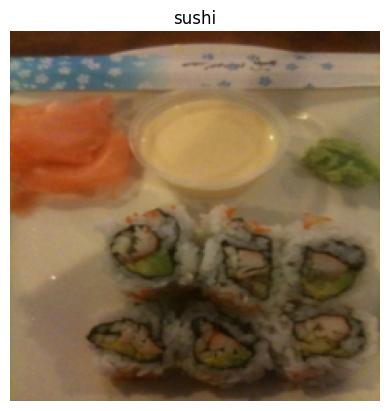

In [114]:
# Plot the image
plt.imshow(image.permute(1, 2, 0))
plt.title(class_names[label])
plt.axis(False);

#### Equation 1 Implementation: Data Patch Splitting, and Developing Class, Position and Patch Embeddings

Begin with the **patch embedding** process, selecting a patch size 'P' of 16x16. This choice aligns with the optimal configuration used in the ViT-Base model, as indicated by the "ViT-B/16" column in Table 5 of the ViT paper:

In [115]:
# Deifne the hyper-parameters values
height = 224
width = 224
color_channels = 3
patch_size = 16

# Calculating the 'N' (number of patches)
number_of_patches = int((height * width) / patch_size**2)

# Print metadata
print(f"Number of patches (N) with image height (H={height}), width (W={width}) and patch size (P={patch_size}): {number_of_patches}")

Number of patches (N) with image height (H=224), width (W=224) and patch size (P=16): 196


We will **manually** calculate the input and output shapes of the patch embedding layer as described in the opening paragraph of Section 3.1 of the referenced paper (which explains Equation 1 in detail):

In [116]:
# Define the input shape
embedding_layer_input_shape = (height, width, color_channels)

# Define the output shape
embedding_layer_output_shape = (number_of_patches, patch_size**2 * color_channels)

# Display the input and output shapes
print(f"Input shape (single 2D image): {embedding_layer_input_shape}")
print(f"Output shape (single 2D image flattened into patches): {embedding_layer_output_shape}")

Input shape (single 2D image): (224, 224, 3)
Output shape (single 2D image flattened into patches): (196, 768)


Having determined the ideal input and output shapes for the patch embedding layer, we can proceed to construct it. First, let’s visualize the transformation of an image into patches (we will decompose the overall architecture into smaller components, focusing on the inputs and outputs of individual layers):

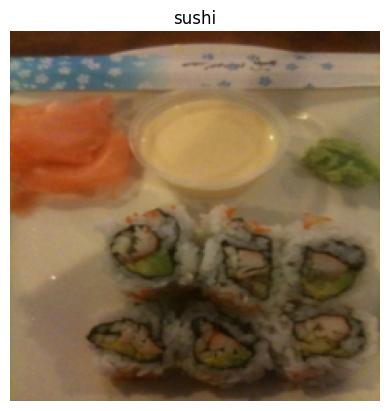

In [117]:
# View a single image
plt.imshow(image.permute(1, 2, 0))
plt.title(class_names[label])
plt.axis(False);

Let’s now visualize the **top row** of the image composed of patched pixels:



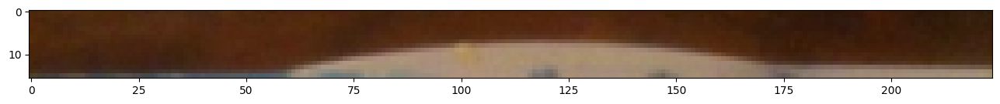

In [118]:
# Change image shape to be compatible with matplotlib (color_channels, height, width) -> (height, width, color_channels)
image_permuted = image.permute(1, 2, 0)

# Define the patch size, and plot the top row of patched pixels
patch_size = 16
plt.figure(figsize=(patch_size, patch_size))
plt.imshow(image_permuted[:patch_size, :, :]);

Having visualized the **top row**, let's proceed to convert it into patches:

Number of patches per row: 14.0
Patch size: 16 pixels x 16 pixels


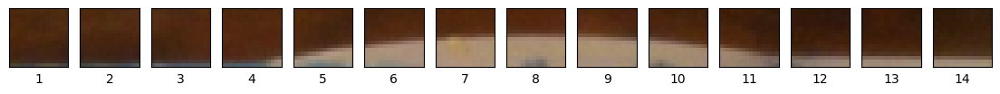

In [119]:
# Define the hyperparameters
img_size = 224
patch_size = 16
num_patches = img_size/patch_size

# Making sure the 'img_size' and 'patch_size' are compatible
assert img_size % patch_size == 0, "Image size must be divisible by patch size"
print(f"Number of patches per row: {num_patches}\nPatch size: {patch_size} pixels x {patch_size} pixels")

# Create subplots, one column for each patch
fig, axs = plt.subplots(nrows=1,
                        ncols=img_size // patch_size,
                        figsize=(num_patches, num_patches),
                        sharex=True,
                        sharey=True)

# Loop through the number of patches in the top row
for i, patch in enumerate(range(0, img_size, patch_size)):
    axs[i].imshow(image_permuted[:patch_size, patch:patch+patch_size, :]);
    axs[i].set_xlabel(i+1)
    axs[i].set_xticks([])
    axs[i].set_yticks([])

Finally, let's configure the code to plot the **entire image** as patches (not just the top row):

Number of patches per row: 14.0        
Number of patches per column: 14.0        
Total patches: 196.0        
Patch size: 16 pixels x 16 pixels


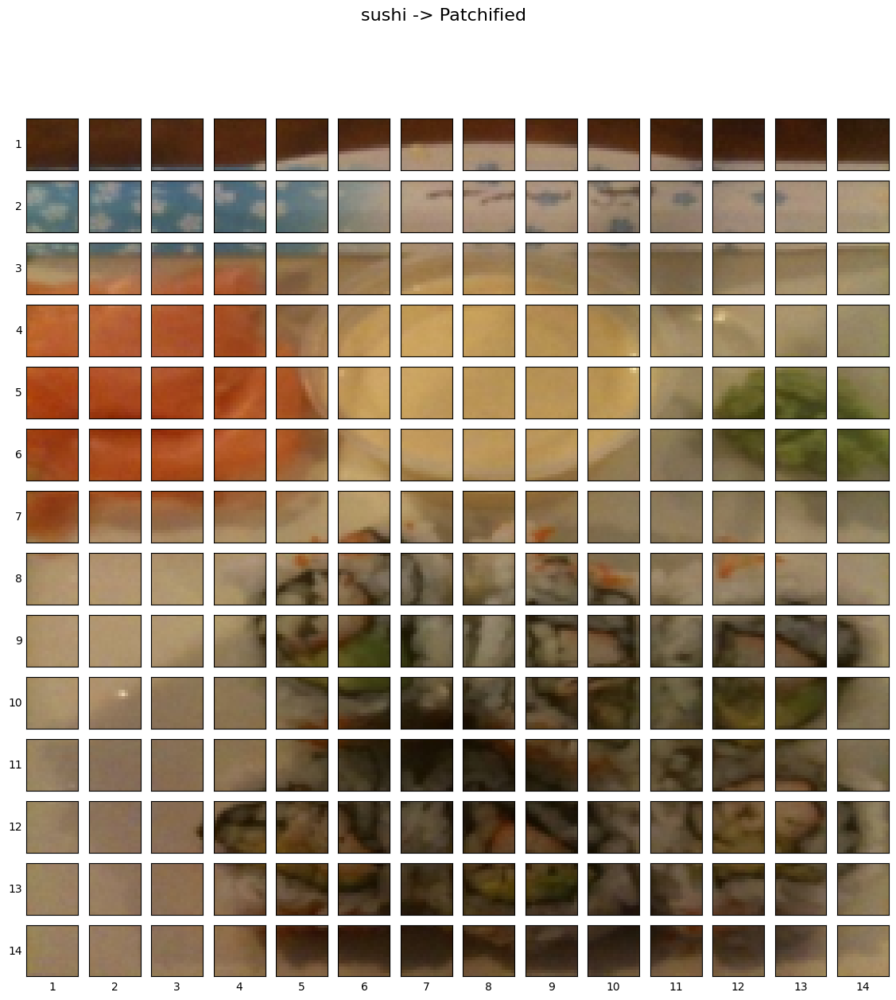

In [120]:
# Define the hyperparameters
img_size = 224
patch_size = 16
num_patches = img_size/patch_size

# Making sure the 'img_size' and 'patch_size' are compatible
assert img_size % patch_size == 0, "Image size must be divisible by patch size"
print(f"Number of patches per row: {num_patches}\
        \nNumber of patches per column: {num_patches}\
        \nTotal patches: {num_patches*num_patches}\
        \nPatch size: {patch_size} pixels x {patch_size} pixels")

# Create subplots, one column for each patch
fig, axs = plt.subplots(nrows=img_size // patch_size,
                        ncols=img_size // patch_size,
                        figsize=(num_patches, num_patches),
                        sharex=True,
                        sharey=True)

# Loop through the height
for i, patch_height in enumerate(range(0, img_size, patch_size)):
    # Then, loop through the width
    for j, patch_width in enumerate(range(0, img_size, patch_size)):
        # Plot the permuted image patch
        axs[i, j].imshow(image_permuted[patch_height:patch_height+patch_size,
                                        patch_width:patch_width+patch_size,
                                        :])

        # Set up the label information
        axs[i, j].set_ylabel(i+1,
                             rotation="horizontal",
                             horizontalalignment="right",
                             verticalalignment="center")
        axs[i, j].set_xlabel(j+1)
        axs[i, j].set_xticks([])
        axs[i, j].set_yticks([])
        axs[i, j].label_outer()

fig.suptitle(f"{class_names[label]} -> Patchified", fontsize=16)
plt.show()

In order understand the process of converting images into patches and embedding them using PyTorch, we need to delve into the patch embedding layers. This process is essential for the functioning of Vision Transformers (ViTs).

We began by visualizing a single image divided into patches, which involved looping through the height and width dimensions of the image to plot individual patches. This operation closely resembles the convolutional operation performed by 'nn.Conv2d()', and indeed, the authors of the ViT paper indicate in section 3.1 that patch embedding can be achieved using a convolutional neural network (CNN).

**For patch embedding, the ideal input and output shapes are as follows:**
- Input: The image starts as a 2D array with dimensions 𝐻 × 𝑊 × 𝐶 (Height x Width x Channels).
- Output: The image is converted into a 1D sequence of flattened 2D patches with dimensions 𝑁 × (𝑃^2 × 𝐶) (Number of patches x Patch size squared x Channels).

**For an image of size 224x224 and a patch size of 16:**
- Input (2D image): (224, 224, 3) → (Height, Width, Channels)
- Output (flattened 2D patches): (196, 768) → (Number of patches, Embedding dimension)

**To achieve this transformation, we use:**
- 'torch.nn.Conv2d(' to convert the image into patches of CNN feature maps.
- 'torch.nn.Flatten()' to flatten the spatial dimensions of the feature map.

Let's begin with the implementation of the 'torch.nn.Conv2d()' layer to turn the image into patches:



In [121]:
# Define the patch size
patch_size=16

# Create the Conv2d layer
conv2d = nn.Conv2d(in_channels=3,
                   out_channels=768,
                   kernel_size=patch_size,
                   stride=patch_size,
                   padding=0)

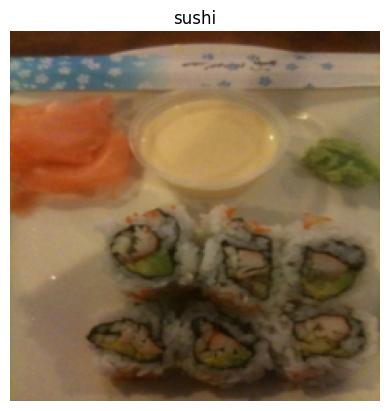

In [122]:
# View a single image
plt.imshow(image.permute(1, 2, 0))
plt.title(class_names[label])
plt.axis(False);

In [123]:
# Checking out what happens when passing a single image through the Conv2d layer
image_out_of_conv = conv2d(image.unsqueeze(0)) # Adding a single batch dimension for the batch dimension, going from '(height, width, color_channels)' to '(batch, height, width, color_channels)', needed for the Conv2d layer.
# Display its shape
print(image_out_of_conv.shape)

torch.Size([1, 768, 14, 14])


To calculate the number of patches '𝑁' needed, the ViT paper (section 3.1) mentions: "As a special case, the patches can have a spatial size of 1×1."

To flatten the spatial dimensions of the feature map, we can utilize 'torch.nn.Flatten()'. However, it is essential to flatten **only** the "spatial dimensions of the feature map" (and not the entire tensor), specifically the 'feature_map_heigh't and 'feature_map_width' dimensions of the 'image_out_of_conv':


In [124]:
# Create the Flatten layer
flatten = nn.Flatten(start_dim=2, end_dim=3)

# Flatten the feature maps
image_out_of_conv_flattened = flatten(image_out_of_conv)
print(f"Flattened image feature map shape: {image_out_of_conv_flattened.shape}")

Flattened image feature map shape: torch.Size([1, 768, 196])


In [125]:
# Adjust the flattened image patch embeddings to be in right the shape, and print its shape
image_out_of_conv_flattened_reshaped = image_out_of_conv_flattened.permute(0, 2, 1)
print(f"Patch embedding sequence shape: {image_out_of_conv_flattened_reshaped.shape} -> [batch_size, num_patches, embedding_size]")

Patch embedding sequence shape: torch.Size([1, 196, 768]) -> [batch_size, num_patches, embedding_size]


Note: The resulting output from the patch embedding layer will serve as the input to the subsequent layers of the ViT architecture.

In [126]:
# Getting a single flattened feature map, and then display it as a tensor
single_flattened_feature_map = image_out_of_conv_flattened_reshaped[:, :, 0]
single_flattened_feature_map, single_flattened_feature_map.requires_grad, single_flattened_feature_map.shape

(tensor([[-0.1214, -0.1252, -0.1207, -0.1289, -0.1368, -0.1696, -0.1665, -0.1817,
          -0.1648, -0.1893, -0.1597, -0.1220, -0.1243, -0.1139,  0.1296,  0.0557,
           0.1089,  0.1079,  0.1023, -0.0093, -0.0974, -0.1333, -0.0659, -0.0608,
          -0.0724, -0.0664, -0.0355, -0.0700, -0.1284, -0.1729, -0.1745, -0.1994,
          -0.1136, -0.1020, -0.1661, -0.1597, -0.1267, -0.1310, -0.0994, -0.1149,
          -0.1047, -0.1071, -0.3581, -0.3239, -0.3184, -0.2944, -0.1630, -0.2040,
          -0.2359, -0.2303, -0.2227, -0.1802, -0.1275, -0.0688, -0.1104, -0.0804,
          -0.3714, -0.3441, -0.3562, -0.3508, -0.2445, -0.2193, -0.2351, -0.2174,
          -0.2256, -0.2203, -0.1304, -0.1353, -0.0794, -0.0883, -0.3371, -0.3723,
          -0.3722, -0.3530, -0.2329, -0.2063, -0.2048, -0.2102, -0.1876, -0.1596,
          -0.0964, -0.1500, -0.1418, -0.1188, -0.2663, -0.2034, -0.1928, -0.2161,
          -0.1368, -0.1467, -0.1847, -0.1456, -0.1605, -0.0940, -0.1117, -0.1120,
          -0.132

Let's encapsulate the patch embedding process within a single PyTorch layer by defining a 'PatchEmbedding' class. This class, subclassing 'nn.Module', will convert a 2D input image into a 1D sequence of learnable embedding vectors:

In [127]:
class PatchEmbedding(nn.Module):
    """This class turns a 2D input image into a 1D sequence learnable embedding vector.

    Args:
        in_channels (int): Number of color channels for the input images. Defaults to 3.
        patch_size (int): Size of patches to convert input image into. Defaults to 16.
        embedding_dim (int): Size of embedding to turn image into. Defaults to 768.
    """
    # Initialize the class with the needed variables
    def __init__(self,
                 in_channels:int=3,
                 patch_size:int=16,
                 embedding_dim:int=768):
        super().__init__()

        # Create a Conv2d layer to turn an image into patches
        self.patcher = nn.Conv2d(in_channels=in_channels,
                                 out_channels=embedding_dim,
                                 kernel_size=patch_size,
                                 stride=patch_size,
                                 padding=0)

        # Create a Flatten layer to flatten the patch feature maps into a single dimension
        self.flatten = nn.Flatten(start_dim=2, end_dim=3)

    # Overwrite the forward pass method
    def forward(self, x):
        # Make sure the inputs are in the correct shape
        image_resolution = x.shape[-1]
        assert image_resolution % patch_size == 0, f"Input image size must be divisble by patch size, image shape: {image_resolution}, patch size: {patch_size}"

        # Perform the forward pass
        x_patched = self.patcher(x)
        x_flattened = self.flatten(x_patched)

        return x_flattened.permute(0, 2, 1)

Let's apply this process to a single image to test its functionality:





In [128]:
# Set the random seeds
set_seeds()

# Create an instance of the patch embedding layer
patchify = PatchEmbedding(in_channels=3,
                          patch_size=16,
                          embedding_dim=768)

# Pass a single image through the patch embedding layer (after adding an extra dimension to the image)
print(f"Input image shape: {image.unsqueeze(0).shape}")
patch_embedded_image = patchify(image.unsqueeze(0))
print(f"Output patch embedding shape: {patch_embedded_image.shape}")

Input image shape: torch.Size([1, 3, 224, 224])
Output patch embedding shape: torch.Size([1, 196, 768])


The 'PatchEmbedding' class faithfully replicates the patch embedding mechanism of the ViT architecture as depicted in Figure 1 and Equation 1 of the ViT paper.
Note that the learnable class embedding and position embeddings are yet to be implemented.

Let’s now review a summary of the 'PatchEmbedding' layer:

In [129]:
# Define random input sizes
random_input_image = (1, 3, 224, 224)

# Display the summary of the Patch Embedding layer
summary(PatchEmbedding(),
        input_size=random_input_image,
        col_names=["input_size", "output_size", "num_params", "trainable"],
        col_width=20,
        row_settings=["var_names"])

Layer (type (var_name))                  Input Shape          Output Shape         Param #              Trainable
PatchEmbedding (PatchEmbedding)          [1, 3, 224, 224]     [1, 196, 768]        --                   True
├─Conv2d (patcher)                       [1, 3, 224, 224]     [1, 768, 14, 14]     590,592              True
├─Flatten (flatten)                      [1, 768, 14, 14]     [1, 768, 196]        --                   --
Total params: 590,592
Trainable params: 590,592
Non-trainable params: 0
Total mult-adds (M): 115.76
Input size (MB): 0.60
Forward/backward pass size (MB): 1.20
Params size (MB): 2.36
Estimated Total Size (MB): 4.17

Having completed the image patch embedding, we can now proceed to develop the class **token embedding**, denoted as ‘𝑥class' in Equation 1.

In [130]:
# Display the patch embedding, and its shape
print(patch_embedded_image)
print(f"Patch embedding shape: {patch_embedded_image.shape} -> [batch_size, number_of_patches, embedding_dimension]")

tensor([[[-0.2332,  0.0453, -0.1040,  ...,  0.0967, -0.0974,  0.0600],
         [-0.2606,  0.0607, -0.0953,  ...,  0.0935, -0.0876,  0.0571],
         [-0.2571,  0.0706, -0.1171,  ...,  0.1303, -0.1063,  0.0360],
         ...,
         [-0.2745,  0.0205, -0.1321,  ...,  0.1757, -0.1011,  0.1285],
         [-0.4052,  0.1081, -0.1517,  ...,  0.3164, -0.1794,  0.1142],
         [-0.5632,  0.1053, -0.1437,  ...,  0.3965, -0.2449,  0.2157]]],
       grad_fn=<PermuteBackward0>)
Patch embedding shape: torch.Size([1, 196, 768]) -> [batch_size, number_of_patches, embedding_dimension]


In [131]:
# Retrieve the batch size
batch_size = patch_embedded_image.shape[0]
# Retrieve the embedding dimension
embedding_dimension = patch_embedded_image.shape[-1]

# Create the class token embedding as a learnable parameter
class_token = nn.Parameter(torch.ones(batch_size, 1, embedding_dimension),
                           requires_grad=True)

# Display the first 10 examples of the class token
print(class_token[:, :, :10])

# Print the class token's shape
print(f"Class token shape: {class_token.shape} -> [batch_size, number_of_tokens, embedding_dimension]")

tensor([[[1., 1., 1., 1., 1., 1., 1., 1., 1., 1.]]], grad_fn=<SliceBackward0>)
Class token shape: torch.Size([1, 1, 768]) -> [batch_size, number_of_tokens, embedding_dimension]


With the class token embedding now in place, let's prepend it to the sequence of image patches, referred to as 'patch_embedded_image':

In [132]:
# Adding the class token embedding to the front of the patch embedding
patch_embedded_image_with_class_embedding = torch.cat((class_token, patch_embedded_image),
                                                      dim=1)

# Printing the sequence of patch embeddings with the prepended class token embedding
print(patch_embedded_image_with_class_embedding)
print(f"Sequence of patch embeddings with class token prepended shape: {patch_embedded_image_with_class_embedding.shape} -> [batch_size, number_of_patches, embedding_dimension]")

tensor([[[ 1.0000,  1.0000,  1.0000,  ...,  1.0000,  1.0000,  1.0000],
         [-0.2332,  0.0453, -0.1040,  ...,  0.0967, -0.0974,  0.0600],
         [-0.2606,  0.0607, -0.0953,  ...,  0.0935, -0.0876,  0.0571],
         ...,
         [-0.2745,  0.0205, -0.1321,  ...,  0.1757, -0.1011,  0.1285],
         [-0.4052,  0.1081, -0.1517,  ...,  0.3164, -0.1794,  0.1142],
         [-0.5632,  0.1053, -0.1437,  ...,  0.3965, -0.2449,  0.2157]]],
       grad_fn=<CatBackward0>)
Sequence of patch embeddings with class token prepended shape: torch.Size([1, 197, 768]) -> [batch_size, number_of_patches, embedding_dimension]


We have both the class **token embedding** and the **patch embedding**. Next, we need to create the position embedding, ‘𝐸pos’ as described in Equation 1, where ‘𝐸’ denotes "embedding":

In [133]:
# Display the sequence of the patch embeddings with the prepended class embedding
patch_embedded_image_with_class_embedding, patch_embedded_image_with_class_embedding.shape

(tensor([[[ 1.0000,  1.0000,  1.0000,  ...,  1.0000,  1.0000,  1.0000],
          [-0.2332,  0.0453, -0.1040,  ...,  0.0967, -0.0974,  0.0600],
          [-0.2606,  0.0607, -0.0953,  ...,  0.0935, -0.0876,  0.0571],
          ...,
          [-0.2745,  0.0205, -0.1321,  ...,  0.1757, -0.1011,  0.1285],
          [-0.4052,  0.1081, -0.1517,  ...,  0.3164, -0.1794,  0.1142],
          [-0.5632,  0.1053, -0.1437,  ...,  0.3965, -0.2449,  0.2157]]],
        grad_fn=<CatBackward0>),
 torch.Size([1, 197, 768]))

In [134]:
# Calculate the number of patches 'N'
number_of_patches = int((height * width) / patch_size**2)

# Retrieve the embedding dimension
embedding_dimension = patch_embedded_image_with_class_embedding.shape[2]

# Create the learnable 1D position embedding
position_embedding = nn.Parameter(torch.ones(1, number_of_patches+1, embedding_dimension),
                                  requires_grad=True)

# Display the first 10 sequences and 10 position embedding values, as well as the position embedding's shape
print(position_embedding[:, :10, :10])
print(f"Position embeddding shape: {position_embedding.shape} -> [batch_size, number_of_patches, embedding_dimension]")

tensor([[[1., 1., 1., 1., 1., 1., 1., 1., 1., 1.],
         [1., 1., 1., 1., 1., 1., 1., 1., 1., 1.],
         [1., 1., 1., 1., 1., 1., 1., 1., 1., 1.],
         [1., 1., 1., 1., 1., 1., 1., 1., 1., 1.],
         [1., 1., 1., 1., 1., 1., 1., 1., 1., 1.],
         [1., 1., 1., 1., 1., 1., 1., 1., 1., 1.],
         [1., 1., 1., 1., 1., 1., 1., 1., 1., 1.],
         [1., 1., 1., 1., 1., 1., 1., 1., 1., 1.],
         [1., 1., 1., 1., 1., 1., 1., 1., 1., 1.],
         [1., 1., 1., 1., 1., 1., 1., 1., 1., 1.]]], grad_fn=<SliceBackward0>)
Position embeddding shape: torch.Size([1, 197, 768]) -> [batch_size, number_of_patches, embedding_dimension]


In [135]:
# Adding the position embedding to the patch and class token embedding
patch_and_position_embedding = patch_embedded_image_with_class_embedding + position_embedding

# Display the patch and position embedding
print(patch_and_position_embedding)
print(f"Patch embeddings, class token prepended and positional embeddings added shape: {patch_and_position_embedding.shape} -> [batch_size, number_of_patches, embedding_dimension]")

tensor([[[2.0000, 2.0000, 2.0000,  ..., 2.0000, 2.0000, 2.0000],
         [0.7668, 1.0453, 0.8960,  ..., 1.0967, 0.9026, 1.0600],
         [0.7394, 1.0607, 0.9047,  ..., 1.0935, 0.9124, 1.0571],
         ...,
         [0.7255, 1.0205, 0.8679,  ..., 1.1757, 0.8989, 1.1285],
         [0.5948, 1.1081, 0.8483,  ..., 1.3164, 0.8206, 1.1142],
         [0.4368, 1.1053, 0.8563,  ..., 1.3965, 0.7551, 1.2157]]],
       grad_fn=<AddBackward0>)
Patch embeddings, class token prepended and positional embeddings added shape: torch.Size([1, 197, 768]) -> [batch_size, number_of_patches, embedding_dimension]


We have significantly progressed in transforming the input images into embeddings, adhering to Equation 1 from section 3.1 of the ViT paper.

Let’s now integrate all components into a single code cell, transitioning from the input image ‘𝑥’ to output embedding ‘𝑧0’:

In [136]:
# Set the random seeds
set_seeds()

# Define the patch size
patch_size = 16

# Print the shape of the original image tensor
print(f"Image tensor shape: {image.shape}")
# Retrieve the image dimensions
height, width = image.shape[1], image.shape[2]

# Retrieve the image tensor, and add batch dimension
x = image.unsqueeze(0)
print(f"Input image with batch dimension shape: {x.shape}")

# Create a patch embedding layer
patch_embedding_layer = PatchEmbedding(in_channels=3,
                                       patch_size=patch_size,
                                       embedding_dim=768)

# Pass the image through the patch embedding layer, and print the patch embedding shape
patch_embedding = patch_embedding_layer(x)
print(f"Patching embedding shape: {patch_embedding.shape}")

# Create a class token embedding, and print its shape
batch_size = patch_embedding.shape[0]
embedding_dimension = patch_embedding.shape[-1]
class_token = nn.Parameter(torch.ones(batch_size, 1, embedding_dimension),
                           requires_grad=True)
print(f"Class token embedding shape: {class_token.shape}")

# Prepend the class token embedding to the patch embedding, and print their shape
patch_embedding_class_token = torch.cat((class_token, patch_embedding), dim=1)
print(f"Patch embedding with class token shape: {patch_embedding_class_token.shape}")

# Create a position embedding
number_of_patches = int((height * width) / patch_size**2)
position_embedding = nn.Parameter(torch.ones(1, number_of_patches+1, embedding_dimension),
                                  requires_grad=True)

# Add the position embedding to the patch embedding with the class token, and print their shape
patch_and_position_embedding = patch_embedding_class_token + position_embedding
print(f"Patch and position embedding shape: {patch_and_position_embedding.shape}")

Image tensor shape: torch.Size([3, 224, 224])
Input image with batch dimension shape: torch.Size([1, 3, 224, 224])
Patching embedding shape: torch.Size([1, 196, 768])
Class token embedding shape: torch.Size([1, 1, 768])
Patch embedding with class token shape: torch.Size([1, 197, 768])
Patch and position embedding shape: torch.Size([1, 197, 768])


#### Equation 2 Implementation

We have now encoded the data images and prepared them for input into the Transformer Encoder, as illustrated in Figure 1 of the ViT paper. With the data patchified and embedded, we are ready to proceed to the next stage of the ViT architecture.

We will dissect the Transformer Encoder section into two distinct parts, starting with Equation 2, followed by Equation 3. This step-by-step approach allows for a detailed understanding and implementation.

**To replicate the layers and the residual connections in PyTorch, the following components will be utilized:**
- Multi-Head Self Attention (MSA): Implemented via 'torch.nn.MultiheadAttention()'.
- Layer Normalization (LN): Achieved through 'torch.nn.LayerNorm()'.
- Residual Connection: This involves adding the input directly to the output, which will be elaborated on when constructing the complete Transformer Encoder block in Section 7.1.

**Note:**
For practice reasons, let's initially build the components of the Transformer Encoder layer manually. Subsequently, we will recreate the encoder using PyTorch's built-in Transformer layers with 'torch.nn.TransformerEncoderLayer()', ensuring identical hyperparameters are applied.


In [137]:
class MultiheadSelfAttentionBlock(nn.Module):
    """This class creates a multi-head self-attention block ("MSA block")."""
    def __init__(self,
                 embedding_dim:int=768,
                 num_heads:int=12,
                 attn_dropout:float=0):
        super().__init__()

        # Create the LayerNorm Norm layer
        self.layer_norm = nn.LayerNorm(normalized_shape=embedding_dim)

        # Create the Multi-Head Self Attention (MSA) layer
        self.multihead_attn = nn.MultiheadAttention(embed_dim=embedding_dim,
                                                    num_heads=num_heads,
                                                    dropout=attn_dropout,
                                                    batch_first=True) # Set to 'True', since in our case the batch dimension comes first

    # Overwrite the forward() pass method
    def forward(self, x):
        x = self.layer_norm(x)
        attn_output, _ = self.multihead_attn(query=x,
                                             key=x,
                                             value=x,
                                             need_weights=False)
        return attn_output

Let's try it out:

In [138]:
# Creating an instance of the 'MSABlock'
multihead_self_attention_block = MultiheadSelfAttentionBlock(embedding_dim=768, num_heads=12)

# Pass the patch and position image embedding through the 'MSABlock', and print the input and output shape the block
patched_image_through_msa_block = multihead_self_attention_block(patch_and_position_embedding)
print(f"Input shape of MSA block: {patch_and_position_embedding.shape}")
print(f"Output shape MSA block: {patched_image_through_msa_block.shape}")

Input shape of MSA block: torch.Size([1, 197, 768])
Output shape MSA block: torch.Size([1, 197, 768])


#### Equation 3 Implementation

In this context, "MLP" denotes "multilayer perceptron," and "LN" signifies "layer normalization." The addition at the end represents the skip/residual connection.

We'll refer to equation 3 as the "MLP block" of the Transformer encoder:

In [139]:
class MLPBlock(nn.Module):
    """This class creates a layer normalized multilayer perceptron block ("MLP block")."""
    def __init__(self,
                 embedding_dim:int=768,
                 mlp_size:int=3072,
                 dropout:float=0.1):
        super().__init__()

        # Create the LayerNorm Norm layer
        self.layer_norm = nn.LayerNorm(normalized_shape=embedding_dim)

        # Create the Multilayer perceptron (MLP) layers
        self.mlp = nn.Sequential(
            nn.Linear(in_features=embedding_dim, out_features=mlp_size),
            # Based on section 3.1 in the papaer - "The MLP contains two layers with a GELU non-linearity"
            nn.GELU(),
            nn.Dropout(p=dropout),
            nn.Linear(in_features=mlp_size, out_features=embedding_dim),
            # Based on the papaer - "Dropout, when used, is applied after every dense layer.."
            nn.Dropout(p=dropout)
        )

    # Overwrite the forward() pass method
    def forward(self, x):
        x = self.layer_norm(x)
        x = self.mlp(x)

        return x

Let's test it out:

In [140]:
# Create an instance of the 'MLPBlock'
mlp_block = MLPBlock(embedding_dim=768,
                     mlp_size=3072,
                     dropout=0.1)

# Pass the output of 'MSABlock' through 'MLPBlock', and print the input and output shape the block
patched_image_through_mlp_block = mlp_block(patched_image_through_msa_block)
print(f"Input shape of MLP block: {patched_image_through_msa_block.shape}")
print(f"Output shape MLP block: {patched_image_through_mlp_block.shape}")

Input shape of MLP block: torch.Size([1, 197, 768])
Output shape MLP block: torch.Size([1, 197, 768])


Proceeding forward, we have the PyTorch code for equations 2 and 3. Let's integrate them to form the Transformer Encoder, which combines the 'MultiheadSelfAttentionBlock' (equation 2) and 'MLPBlock' (equation 3):


In [141]:
class TransformerEncoderBlock(nn.Module):
    """This class creates a Transformer Encoder block."""
    def __init__(self,
                 embedding_dim:int=768,
                 num_heads:int=12,
                 mlp_size:int=3072,
                 mlp_dropout:float=0.1,
                 attn_dropout:float=0):
        super().__init__()

        # Create the MSA block (from equation 2)
        self.msa_block = MultiheadSelfAttentionBlock(embedding_dim=embedding_dim,
                                                     num_heads=num_heads,
                                                     attn_dropout=attn_dropout)

        # 4. Create the MLP block (from equation 3)
        self.mlp_block =  MLPBlock(embedding_dim=embedding_dim,
                                   mlp_size=mlp_size,
                                   dropout=mlp_dropout)

    # Overwrite the forward() pass method
    def forward(self, x):
        # Create the residual connection for the 'MSA block' by adding the input to the output
        x =  self.msa_block(x) + x
        # Create the residual connection for 'MLP block' by adding the input to the output
        x = self.mlp_block(x) + x

        return x

Summarizing the 'TransformerEncoderBlock':

In [142]:
# Create an instance of the 'TransformerEncoderBlock'
transformer_encoder_block = TransformerEncoderBlock()

# Display the summary of the 'TransformerEncoderBlock'
summary(model=transformer_encoder_block,
        input_size=(1, 197, 768), # (batch_size, num_patches, embedding_dimension)
        col_names=["input_size", "output_size", "num_params", "trainable"],
        col_width=20,
        row_settings=["var_names"])

Layer (type (var_name))                            Input Shape          Output Shape         Param #              Trainable
TransformerEncoderBlock (TransformerEncoderBlock)  [1, 197, 768]        [1, 197, 768]        --                   True
├─MultiheadSelfAttentionBlock (msa_block)          [1, 197, 768]        [1, 197, 768]        --                   True
│    └─LayerNorm (layer_norm)                      [1, 197, 768]        [1, 197, 768]        1,536                True
│    └─MultiheadAttention (multihead_attn)         --                   [1, 197, 768]        2,362,368            True
├─MLPBlock (mlp_block)                             [1, 197, 768]        [1, 197, 768]        --                   True
│    └─LayerNorm (layer_norm)                      [1, 197, 768]        [1, 197, 768]        1,536                True
│    └─Sequential (mlp)                            [1, 197, 768]        [1, 197, 768]        --                   True
│    │    └─Linear (0)                     

We have **manually** constructed the components of the Transformer Encoder layer and created the TransformerEncoderBlock.

Let's now recreate the 'TransformerEncoderBlock' using **PyTorch's built-in** Transformer layers ('torch.nn.TransformerEncoderLayer()'), and configure it with the same hyperparameters as defined above:


In [143]:
# Create and display the Transformer Encoder Layer (exactly as above) but with 'torch.nn.TransformerEncoderLayer()'
torch_transformer_encoder_layer = nn.TransformerEncoderLayer(d_model=768,
                                                             nhead=12,
                                                             dim_feedforward=3072,
                                                             dropout=0.1,
                                                             activation="gelu",
                                                             batch_first=True,
                                                             norm_first=True)
torch_transformer_encoder_layer

TransformerEncoderLayer(
  (self_attn): MultiheadAttention(
    (out_proj): NonDynamicallyQuantizableLinear(in_features=768, out_features=768, bias=True)
  )
  (linear1): Linear(in_features=768, out_features=3072, bias=True)
  (dropout): Dropout(p=0.1, inplace=False)
  (linear2): Linear(in_features=3072, out_features=768, bias=True)
  (norm1): LayerNorm((768,), eps=1e-05, elementwise_affine=True)
  (norm2): LayerNorm((768,), eps=1e-05, elementwise_affine=True)
  (dropout1): Dropout(p=0.1, inplace=False)
  (dropout2): Dropout(p=0.1, inplace=False)
)

In [144]:
# Display the summary of the 'Transformer Encoder Layer'
summary(model=torch_transformer_encoder_layer,
        input_size=(1, 197, 768), # (batch_size, num_patches, embedding_dimension)
        col_names=["input_size", "output_size", "num_params", "trainable"],
        col_width=20,
        row_settings=["var_names"])

Layer (type (var_name))                            Input Shape          Output Shape         Param #              Trainable
TransformerEncoderLayer (TransformerEncoderLayer)  [1, 197, 768]        [1, 197, 768]        7,087,872            True
Total params: 7,087,872
Trainable params: 7,087,872
Non-trainable params: 0
Total mult-adds (M): 0
Input size (MB): 0.61
Forward/backward pass size (MB): 0.00
Params size (MB): 0.00
Estimated Total Size (MB): 0.61

#### End-to-End ViT Architecture Construction


We will integrate all the components we've developed to construct the **complete** Vision Transformer (ViT) architecture. This includes all the following components:
- Patch and positional embedding.
- Transformer Encoder(s).
- MLP Head.

Note: The implementation of equation 4 is pending and will be incorporated into the overall ViT architecture class.

In [145]:
class ViT(nn.Module):
    """This class creates a Vision Transformer architecture with ViT-Base hyperparameters by default."""
    def __init__(self,
                 img_size:int=224,
                 in_channels:int=3,
                 patch_size:int=16,
                 num_transformer_layers:int=12,
                 embedding_dim:int=768,
                 mlp_size:int=3072,
                 num_heads:int=12,
                 attn_dropout:float=0,
                 mlp_dropout:float=0.1,
                 embedding_dropout:float=0.1,
                 num_classes:int=1000):
        super().__init__()

        # Making sure the 'img_size' and 'patch_size' are compatible
        assert img_size % patch_size == 0, f"Image size must be divisible by patch size, image size: {img_size}, patch size: {patch_size}."

        # Calculate the number of patches
        self.num_patches = (img_size * img_size) // patch_size**2

        # Create the learnable class embedding which will be at front of sequence of patch embeddings
        self.class_embedding = nn.Parameter(data=torch.randn(1, 1, embedding_dim),
                                            # Setting 'reuired_grad' to 'True' for making it learnable
                                            requires_grad=True)

        # Create the learnable position embedding
        self.position_embedding = nn.Parameter(data=torch.randn(1, self.num_patches+1, embedding_dim),
                                               requires_grad=True)

        # Create the embedding dropout value
        self.embedding_dropout = nn.Dropout(p=embedding_dropout)

        # Create the patch embedding layer
        self.patch_embedding = PatchEmbedding(in_channels=in_channels,
                                              patch_size=patch_size,
                                              embedding_dim=embedding_dim)

        # Create the Transformer Encoder blocks
        self.transformer_encoder = nn.Sequential(*[TransformerEncoderBlock(embedding_dim=embedding_dim,
                                                                            num_heads=num_heads,
                                                                            mlp_size=mlp_size,
                                                                            mlp_dropout=mlp_dropout) for _ in range(num_transformer_layers)])

        # Create the classifier head
        self.classifier = nn.Sequential(
            nn.LayerNorm(normalized_shape=embedding_dim),
            nn.Linear(in_features=embedding_dim,
                      out_features=num_classes)
        )

    # Overwrite the forward() pass method
    def forward(self, x):
        # Retrieve the batch size
        batch_size = x.shape[0]

        # Create the class token embedding, and expand it to match the required batch size (from equation 1)
        class_token = self.class_embedding.expand(batch_size, -1, -1)

        # Create the patch embedding (from equation 1)
        x = self.patch_embedding(x)

        # Concat the class embedding and patch embedding (from equation 1)
        x = torch.cat((class_token, x), dim=1)

        # Add the position embedding to the patch embedding (from equation 1)
        x = self.position_embedding + x

        # Apply the embedding dropout (from appendix B.1)
        x = self.embedding_dropout(x)

        # Pass the patch, position and class embedding through the transformer encoder layers (from equations 2 and 3)
        x = self.transformer_encoder(x)

        # Set 0 index logit through the classifier (from equation 4)
        x = self.classifier(x[:, 0])

        return x

Let's create a concise demonstration to illustrate the expansion of the class token embedding across the batch dimensions:

In [146]:
# Define the batch size
batch_size = 32

# Create a single learnable class token
class_token_embedding_single = nn.Parameter(data=torch.randn(1, 1, 768))
# Expand the single learnable class token across the batch dimension
class_token_embedding_expanded = class_token_embedding_single.expand(batch_size, -1, -1)

# Print the class token embedding's shpaes before and after applyig the modification
print(f"Shape of class token embedding single: {class_token_embedding_single.shape}")
print(f"Shape of class token embedding expanded: {class_token_embedding_expanded.shape}")

Shape of class token embedding single: torch.Size([1, 1, 768])
Shape of class token embedding expanded: torch.Size([32, 1, 768])


Finally, we validate the functionality of the ViT() class and test it out:

In [147]:
# Set the random seeds
set_seeds()

# Create a random tensor with the exact same shape as a single image
random_image_tensor = torch.randn(1, 3, 224, 224)

# Create an instance of the 'ViT' class with our number of classes
vit = ViT(num_classes=len(class_names))

# Pass the random image tensor to the 'ViT' instance
vit(random_image_tensor)

tensor([[-0.2377,  0.7360,  1.2137]], grad_fn=<AddmmBackward0>)

In [148]:
# Display the summary of the ‘vit’ model
summary(model=vit,
        input_size=(32, 3, 224, 224),
        col_names=["input_size", "output_size", "num_params", "trainable"],
        col_width=20,
        row_settings=["var_names"])

Layer (type (var_name))                                      Input Shape          Output Shape         Param #              Trainable
ViT (ViT)                                                    [32, 3, 224, 224]    [32, 3]              152,064              True
├─PatchEmbedding (patch_embedding)                           [32, 3, 224, 224]    [32, 196, 768]       --                   True
│    └─Conv2d (patcher)                                      [32, 3, 224, 224]    [32, 768, 14, 14]    590,592              True
│    └─Flatten (flatten)                                     [32, 768, 14, 14]    [32, 768, 196]       --                   --
├─Dropout (embedding_dropout)                                [32, 197, 768]       [32, 197, 768]       --                   --
├─Sequential (transformer_encoder)                           [32, 197, 768]       [32, 197, 768]       --                   True
│    └─TransformerEncoderBlock (0)                           [32, 197, 768]       [32, 197, 768]

#### Vision Transformer (ViT) Model Training

We have prepared essential components, including 'train_dataloader' and 'test_dataloader', alongside the training functions from the modular Python scripts. The next step involves defining a loss function and an optimizer:

**Note:** The base learning rate (LR) is derived from Table 3 for ViT-* ImageNet-1k, and the beta values are the default ones as specified in Section 4.1 ("Training & Fine-tuning") of the ViT paper.


In [149]:
from going_modular import engine

# Define the ViT model's optimizer
optimizer = torch.optim.Adam(params=vit.parameters(),
                             lr=3e-3,
                             betas=(0.9, 0.999),
                             weight_decay=0.3)

# Define the loss function
loss_fn = torch.nn.CrossEntropyLoss()

In [150]:
# Set the random seeds
set_seeds()

# Train the ViT model, and save the training results to a dictionary
results = engine.train(model=vit,
                       train_dataloader=train_dataloader,
                       test_dataloader=test_dataloader,
                       optimizer=optimizer,
                       loss_fn=loss_fn,
                       epochs=10,
                       device=device)

  0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 1 | train_loss: 5.1949 | train_acc: 0.3633 | test_loss: 5.1213 | test_acc: 0.2604
Epoch: 2 | train_loss: 1.9517 | train_acc: 0.3320 | test_loss: 1.6205 | test_acc: 0.2604
Epoch: 3 | train_loss: 1.2073 | train_acc: 0.4570 | test_loss: 1.7585 | test_acc: 0.2604
Epoch: 4 | train_loss: 1.2482 | train_acc: 0.2969 | test_loss: 1.3214 | test_acc: 0.1979
Epoch: 5 | train_loss: 1.1331 | train_acc: 0.4297 | test_loss: 1.2293 | test_acc: 0.2604
Epoch: 6 | train_loss: 1.1787 | train_acc: 0.3125 | test_loss: 1.2245 | test_acc: 0.1979
Epoch: 7 | train_loss: 1.2512 | train_acc: 0.2578 | test_loss: 1.2060 | test_acc: 0.1979
Epoch: 8 | train_loss: 1.1147 | train_acc: 0.4258 | test_loss: 1.1859 | test_acc: 0.2604
Epoch: 9 | train_loss: 1.1458 | train_acc: 0.3047 | test_loss: 1.0135 | test_acc: 0.5417
Epoch: 10 | train_loss: 1.2647 | train_acc: 0.2617 | test_loss: 1.3921 | test_acc: 0.2604


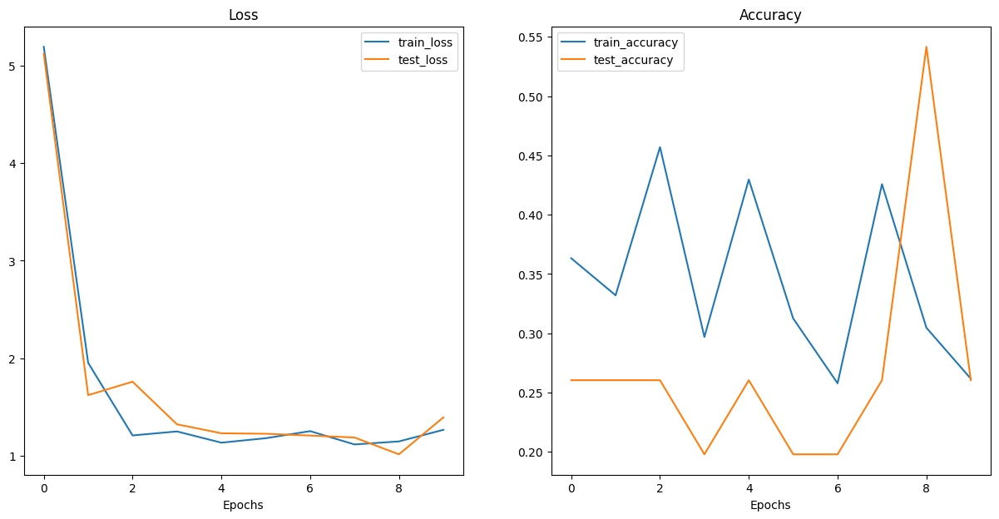

In [151]:
# Plot the model's loss curves
plot_loss_curves(results)

The current loss curves exhibit significant fluctuation, suggesting that while the loss is heading in the right direction, the accuracy metrics aren't promising. This indicates severe **underfitting** in our model.

The disparity between our results and those in the original ViT paper can be attributed to differences in data volume and training regimes. The original ViT architecture demonstrates superior performance on various image classification benchmarks, achieving state-of-the-art results at its release. However, our outcomes are suboptimal, primarily due to the **scale** of data and training duration.

The ViT paper utilizes substantially larger datasets and extended training schedules (refer to Table 3). Although we could augment our dataset with the entire 'food-101' dataset, create new DataLoaders and implement various regularization techniques, we propose transitioning to **Transfer Learning Feature Extraction**. This approach mitigates **overfitting** by leveraging a pretrained model. Given our less-than-optimal results from training a ViT model from scratch, the advantages of transfer learning become evident.

We will employ the pretrained ViT-Base with a patch size of 16 from 'torchvision.models', adapting it to our project requirements by configuring it as a feature extractor for transfer learning:




#### Harnessing Transfer Learning: Pretrained ViT Model Application (same amount of data)

##### Pretrained ViT Model Procurement

In [152]:
# Get the pretrained 'vit_b_16' model's weights
pretrained_vit_weights = torchvision.models.ViT_B_16_Weights.DEFAULT

# Set up the pretrained ViT model
pretrained_vit = torchvision.models.vit_b_16(weights=pretrained_vit_weights).to(device)

# Freeze the base parameters of the pretrained ViT model (for Feature Extraction)
for parameter in pretrained_vit.parameters():
    parameter.requires_grad = False

# Set the random seeds
set_seeds()

# Update the classifier head to suit to out problem
pretrained_vit.heads = nn.Linear(in_features=768,
                                 out_features=len(class_names)).to(device)


Downloading: "https://download.pytorch.org/models/vit_b_16-c867db91.pth" to /root/.cache/torch/hub/checkpoints/vit_b_16-c867db91.pth
100%|██████████| 330M/330M [00:05<00:00, 61.8MB/s]


In [153]:
# Display the summary of the pretrained ‘vit’ model
summary(model=pretrained_vit,
        input_size=(32, 3, 224, 224),
        col_names=["input_size", "output_size", "num_params", "trainable"],
        col_width=20,
        row_settings=["var_names"])

Layer (type (var_name))                                      Input Shape          Output Shape         Param #              Trainable
VisionTransformer (VisionTransformer)                        [32, 3, 224, 224]    [32, 3]              768                  Partial
├─Conv2d (conv_proj)                                         [32, 3, 224, 224]    [32, 768, 14, 14]    (590,592)            False
├─Encoder (encoder)                                          [32, 197, 768]       [32, 197, 768]       151,296              False
│    └─Dropout (dropout)                                     [32, 197, 768]       [32, 197, 768]       --                   --
│    └─Sequential (layers)                                   [32, 197, 768]       [32, 197, 768]       --                   False
│    │    └─EncoderBlock (encoder_layer_0)                   [32, 197, 768]       [32, 197, 768]       (7,087,872)          False
│    │    └─EncoderBlock (encoder_layer_1)                   [32, 197, 768]       [32, 

##### Preprocess the Data

Since we have procured the ViT pretrained model from 'torchvision.models', we will utilize the model's 'transforms()' method ("automatic" transform) to transform the image data into tensors and subsequently convert these tensors into DataLoaders. This ensures that the data conforms to the necessary format required by the ViT pretrained model.

 **Important Reminder:** Its crucial to **match** the transformations applied to your custom data with those used during the pretrained model's training to ensure compatibility and optimal performance.

In [154]:
# Get and display the pretrained ViT model's transforms
pretrained_vit_transforms = pretrained_vit_weights.transforms()
print(pretrained_vit_transforms)

ImageClassification(
    crop_size=[224]
    resize_size=[256]
    mean=[0.485, 0.456, 0.406]
    std=[0.229, 0.224, 0.225]
    interpolation=InterpolationMode.BILINEAR
)


In [155]:
# Create and dispaly the training and testing DataLoaders besides to the list of class names
train_dataloader_pretrained, test_dataloader_pretrained, class_names = data_setup.create_dataloaders(train_dir=train_dir,
                                                                                                     test_dir=test_dir,
                                                                                                     transform=pretrained_vit_transforms,
                                                                                                     batch_size=32)
train_dataloader_pretrained, test_dataloader_pretrained, class_names

(<torch.utils.data.dataloader.DataLoader at 0x79d2d5f1d210>,
 ['pizza', 'steak', 'sushi'])

##### Model Training and Evaluation

In [156]:
from going_modular import engine

# Define the optimizer
optimizer = torch.optim.Adam(params=pretrained_vit.parameters(),
                             lr=1e-3)
# Define the loss function
loss_fn = torch.nn.CrossEntropyLoss()

In [157]:
# Set the random seeds
set_seeds()

# Train the classifier head of the pretrained ViT model
pretrained_vit_results = engine.train(model=pretrained_vit,
                                      train_dataloader=train_dataloader_pretrained,
                                      test_dataloader=test_dataloader_pretrained,
                                      optimizer=optimizer,
                                      loss_fn=loss_fn,
                                      epochs=10,
                                      device=device)

  0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 1 | train_loss: 0.7663 | train_acc: 0.7188 | test_loss: 0.5435 | test_acc: 0.8769
Epoch: 2 | train_loss: 0.3436 | train_acc: 0.9453 | test_loss: 0.3257 | test_acc: 0.8977
Epoch: 3 | train_loss: 0.2068 | train_acc: 0.9492 | test_loss: 0.2698 | test_acc: 0.9186
Epoch: 4 | train_loss: 0.1557 | train_acc: 0.9609 | test_loss: 0.2414 | test_acc: 0.9186
Epoch: 5 | train_loss: 0.1244 | train_acc: 0.9727 | test_loss: 0.2271 | test_acc: 0.8977
Epoch: 6 | train_loss: 0.1210 | train_acc: 0.9766 | test_loss: 0.2122 | test_acc: 0.9280
Epoch: 7 | train_loss: 0.0933 | train_acc: 0.9766 | test_loss: 0.2342 | test_acc: 0.8883
Epoch: 8 | train_loss: 0.0793 | train_acc: 0.9844 | test_loss: 0.2268 | test_acc: 0.9081
Epoch: 9 | train_loss: 0.1084 | train_acc: 0.9883 | test_loss: 0.2064 | test_acc: 0.9384
Epoch: 10 | train_loss: 0.0646 | train_acc: 0.9922 | test_loss: 0.1795 | test_acc: 0.9176


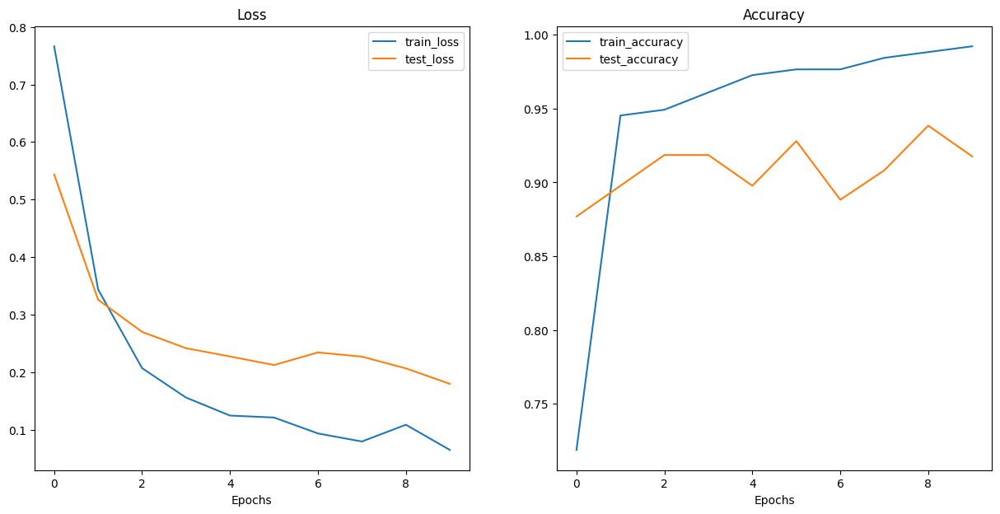

In [158]:
# Plot the model's loss curves
plot_loss_curves(pretrained_vit_results)

The performance of the loss curves is impressive, showcasing the effectiveness of transfer learning!

Note how our custom model, trained from scratch, yielded inferior results compared to the feature extractor model leveraging pretrained ImageNet weights.

##### Model Saving and File (Storage) Size Examination


For deployment considerations, its crucial to know the model's size in megabytes (MB). Given the need for rapid application execution, a smaller model with acceptable performance is typically preferable to a larger model with superior performance. Therefore, we should save the model and review its specifications:

In [159]:
from going_modular import utils

# Save the pretrained ViT model
utils.save_model(model=pretrained_vit,
                 target_dir="models",
                 model_name="pretrained_vit_feature_extractor.pth")

[INFO] Saving model to: models/pretrained_vit_feature_extractor.pth


In [160]:
from pathlib import Path

# Calculate and print the model's size in megabytes
pretrained_vit_model_size = Path("models/pretrained_vit_feature_extractor.pth").stat().st_size // (1024*1024)
print(f"Pretrained ViT feature extractor model size: {pretrained_vit_model_size} MB")

Pretrained ViT feature extractor model size: 327 MB


##### Custom Image Prediction

Let's first download the cusrom image:

In [161]:
# Define the path to the custom image
custom_image_path = Path("data/custom_pizza_picture.jpg")

# Check out if the image already exists. Download it if it doesn't
if not custom_image_path.is_file():
    with open(custom_image_path, "wb") as f:
        request = requests.get("https://github.com/IsraelAzoulay/multi-class-image-classifier-computer-vision/raw/main/data/custom_pizza_picture.jpg")
        print(f"Downloading {custom_image_path}...")
        f.write(request.content)
else:
    print(f"The {custom_image_path} already exists. Skipping download.")

The data/custom_pizza_picture.jpg already exists. Skipping download.


We can now proceed to creating the transfom pipeline for transforming the image and resize it to the dimensions used during model training, and then predict on the custom image and plot it:

In [162]:
# Create the transform pipleine
custom_image_transform = transforms.Compose([
    transforms.Resize((224, 224)),
])

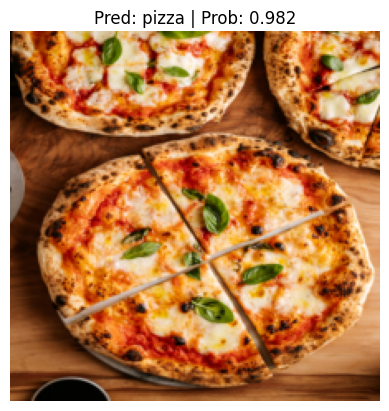

In [163]:
# Predict on the custom image with the pretrained ViT model
pred_and_plot_image(model=pretrained_vit,
                    image_path=custom_image_path,
                    class_names=class_names,
                    transform=custom_image_transform,
                    device=device)

## Model Deployment

**1. Objective:**

The deployed model must achieve both high performance and speed, aiming for real time classification of 3 distinct classes. Our aim is a model with a minimum accuracy of 95%. However, we prioritize speed over marginal gains in accuracy, preferring a model with 90%+ accuracy at 30FPS over one with 95%+ accuracy at 10FPS.

**2. Deployment Metrics:**

We will deploy the project’s model using a Gradio app with the following key performance indicators:
1. **Accuracy:** Achieve at least **95%**.
2. **Speed** Ensure real time inference with a frame rate of **30FPS+**, equating to a prediction latency of less than 0.03 seconds.

**3. Experimental Comparison:**

We will conduct an experiment to compare our top-performing models - EfficientNet-B2 (EffNetB2) and Vision Transformer (ViT) feature extractors. The goal is to determine which model best meets our performance and speed criteria. Previously, we have trained the models on different amounts of data:
- **EffNetB2:** Trained on 20% of the three class subset from the original 'Food101' dataset.
- **ViT:** Trained on 10% of the same subset.

To ensure a fair comparison, we will download the **20%** subset of the dataset and train both the EffNetB2 and ViT feature extractors on it. This will allow us to compare the models trained on identical datasets and select the one that aligns most closely with our deployment objectives.


#### Get the Data (20% of the dataset)

In [164]:
# Download and display the 20% dataset
data_20_percent_path = download_data(source="https://github.com/IsraelAzoulay/multi-class-image-classifier-computer-vision/raw/main/data/20_percent_dataset.zip",
                                     destination="pizza_steak_sushi_20_percent")

data_20_percent_path

The data/pizza_steak_sushi_20_percent directory exists. Skipping download.


PosixPath('data/pizza_steak_sushi_20_percent')

In [165]:
# Define the train and test directory paths
train_dir = data_20_percent_path / "train"
test_dir = data_20_percent_path / "test"

#### Pretrained EffNetB2 Model Procurement

In [166]:
# Get the pretrained 'effnetb2' model's weights
effnetb2_weights = torchvision.models.EfficientNet_B2_Weights.DEFAULT

# Get the pretrained 'effnetb2' model's transforms
effnetb2_transforms = effnetb2_weights.transforms()

# Set up the pretrained 'efficientnet_b2' model
effnetb2 = torchvision.models.efficientnet_b2(weights=effnetb2_weights)

# Freeze the base layers in the 'efficientnet_b2' model (for Feature Extraction)
for param in effnetb2.parameters():
    param.requires_grad = False

# Display the 'efficientnet_b2' model and classifier
effnetb2, effnetb2.classifier

(EfficientNet(
   (features): Sequential(
     (0): Conv2dNormActivation(
       (0): Conv2d(3, 32, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
       (1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
       (2): SiLU(inplace=True)
     )
     (1): Sequential(
       (0): MBConv(
         (block): Sequential(
           (0): Conv2dNormActivation(
             (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), groups=32, bias=False)
             (1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
             (2): SiLU(inplace=True)
           )
           (1): SqueezeExcitation(
             (avgpool): AdaptiveAvgPool2d(output_size=1)
             (fc1): Conv2d(32, 8, kernel_size=(1, 1), stride=(1, 1))
             (fc2): Conv2d(8, 32, kernel_size=(1, 1), stride=(1, 1))
             (activation): SiLU(inplace=True)
             (scale_activation): Sigmoid()
           )
          

To customize the 'effnetb2.classifier' for our specific problem, we need to adjust the 'out_features' parameter to match the number of target classes, which is 3 in this case ('out_features=3'). This modification allows the base model to be tailored to our requirements.

Thus, let's now encapsulate the model creation process within a function to facilitate reuse:




In [167]:
def create_effnetb2_model(num_classes:int=3,
                          seed:int=42):
    """This function creates an EfficientNetB2 feature extractor model and transforms.

    Args:
        num_classes (int, optional): number of classes in the classifier head.
            Defaults to 3.
        seed (int, optional): random seed value. Defaults to 42.

    Returns:
        model (torch.nn.Module): EffNetB2 feature extractor model.
        transforms (torchvision.transforms): EffNetB2 image transforms.
    """
    # Get the pretrained 'effnetb2' model's weights
    weights = torchvision.models.EfficientNet_B2_Weights.DEFAULT
    # Get the pretrained 'effnetb2' model's transforms
    transforms = weights.transforms()
    # Set up the pretrained 'efficientnet_b2' model
    model = torchvision.models.efficientnet_b2(weights=weights)

    # Freeze the base layers in the 'efficientnet_b2' model (for Feature Extraction)
    for param in model.parameters():
        param.requires_grad = False

    # Set the torch manul random seed
    torch.manual_seed(seed)

    # Update the classifier head to suit our problem
    model.classifier = nn.Sequential(
        nn.Dropout(p=0.3, inplace=True),
        nn.Linear(in_features=1408, out_features=num_classes),
    )

    return model, transforms

In [168]:
# Let's test the 'create_effnetb2_model()' function
effnetb2, effnetb2_transforms = create_effnetb2_model(num_classes=3, seed=42)

In [169]:
# Display the summary of the effnetb2 model
summary(effnetb2,
        input_size=(1, 3, 224, 224),
        col_names=["input_size", "output_size", "num_params", "trainable"],
        col_width=20,
        row_settings=["var_names"])

Layer (type (var_name))                                      Input Shape          Output Shape         Param #              Trainable
EfficientNet (EfficientNet)                                  [1, 3, 224, 224]     [1, 3]               --                   Partial
├─Sequential (features)                                      [1, 3, 224, 224]     [1, 1408, 7, 7]      --                   False
│    └─Conv2dNormActivation (0)                              [1, 3, 224, 224]     [1, 32, 112, 112]    --                   False
│    │    └─Conv2d (0)                                       [1, 3, 224, 224]     [1, 32, 112, 112]    (864)                False
│    │    └─BatchNorm2d (1)                                  [1, 32, 112, 112]    [1, 32, 112, 112]    (64)                 False
│    │    └─SiLU (2)                                         [1, 32, 112, 112]    [1, 32, 112, 112]    --                   --
│    └─Sequential (1)                                        [1, 32, 112, 112]    [1, 1

### Preprocess the Data (for the EffNetB2 Model)

In [170]:
from going_modular import data_setup

# Create the training and testing DataLoaders besides to the list of class names
train_dataloader_effnetb2, test_dataloader_effnetb2, class_names = data_setup.create_dataloaders(train_dir=train_dir,
                                                                                                 test_dir=test_dir,
                                                                                                 transform=effnetb2_transforms,
                                                                                                 batch_size=32)

### Training, Evaluating, and Saving the EffNetB2 Feature Extractor Model

In [171]:
from going_modular import engine

# Define the optimizer
optimizer = torch.optim.Adam(params=effnetb2.parameters(),
                             lr=1e-3)
# Define the loss function
loss_fn = torch.nn.CrossEntropyLoss()

In [172]:
# Set the random seeds
set_seeds()

# Train the 'effnetb2' model
effnetb2_results = engine.train(model=effnetb2,
                                train_dataloader=train_dataloader_effnetb2,
                                test_dataloader=test_dataloader_effnetb2,
                                epochs=10,
                                optimizer=optimizer,
                                loss_fn=loss_fn,
                                device=device)

  0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 1 | train_loss: 0.9839 | train_acc: 0.5667 | test_loss: 0.7393 | test_acc: 0.9409
Epoch: 2 | train_loss: 0.7135 | train_acc: 0.8396 | test_loss: 0.5862 | test_acc: 0.9409
Epoch: 3 | train_loss: 0.5874 | train_acc: 0.8958 | test_loss: 0.4891 | test_acc: 0.9563
Epoch: 4 | train_loss: 0.4488 | train_acc: 0.9146 | test_loss: 0.4338 | test_acc: 0.9409
Epoch: 5 | train_loss: 0.4277 | train_acc: 0.9125 | test_loss: 0.3907 | test_acc: 0.9443
Epoch: 6 | train_loss: 0.4392 | train_acc: 0.8896 | test_loss: 0.3525 | test_acc: 0.9688
Epoch: 7 | train_loss: 0.4246 | train_acc: 0.8771 | test_loss: 0.3263 | test_acc: 0.9563
Epoch: 8 | train_loss: 0.3885 | train_acc: 0.8979 | test_loss: 0.3465 | test_acc: 0.9443
Epoch: 9 | train_loss: 0.3795 | train_acc: 0.8812 | test_loss: 0.3127 | test_acc: 0.9193
Epoch: 10 | train_loss: 0.3752 | train_acc: 0.8688 | test_loss: 0.2811 | test_acc: 0.9625


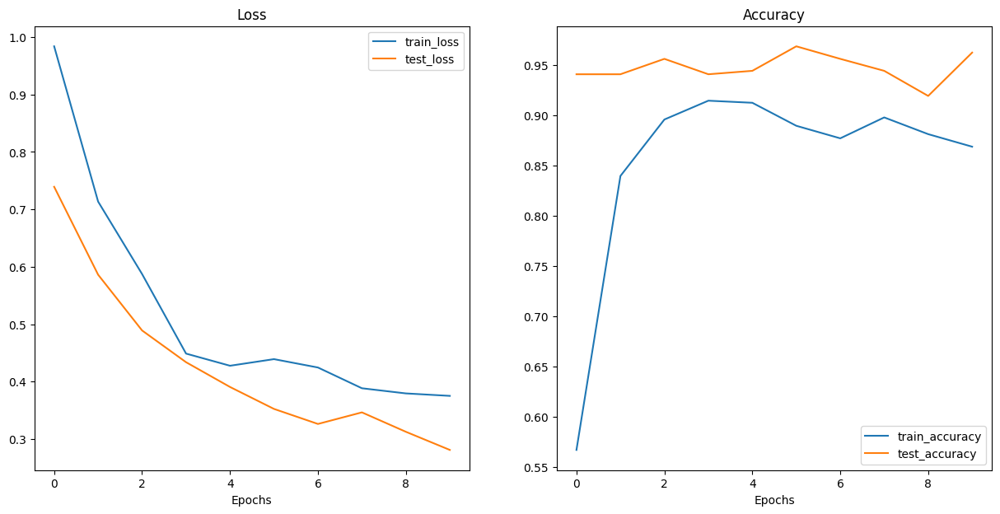

In [173]:
# Display and inspect the model's loss curves
plot_loss_curves(effnetb2_results)

The model demonstrates promising performance! Extending the training duration and incorporating data augmentation techniques could further enhance its robustness and mitigate overfitting.

Let's proceed by saving the current state of the model:

In [174]:
# Save the effnetb2 model
utils.save_model(model=effnetb2,
                 target_dir="models",
                 model_name="pretrained_effnetb2_feature_extractor_20_percent.pth")

[INFO] Saving model to: models/pretrained_effnetb2_feature_extractor_20_percent.pth


### EffNetB2 Model File (Storage) Size Examination

In [175]:
# Claculate and print the effnetb2 model's size in megabytes
pretrained_effnetb2_model_size = Path("models/pretrained_effnetb2_feature_extractor_20_percent.pth").stat().st_size // (1024*1024)
print(f"Pretrained EffNetB2 feature extractor model size: {pretrained_effnetb2_model_size} MB")

Pretrained EffNetB2 feature extractor model size: 29 MB


In [176]:
# Calculate and display the number of parameters in the effnetb2 model
effnetb2_total_params = sum(torch.numel(param) for param in effnetb2.parameters())
effnetb2_total_params

7705221

Let's organize all relevant components into a dictionary to facilitate subsequent comparisons:



In [177]:
# Create a dictionary with effnetb2 model's statistics, and display it
effnetb2_stats = {"test_loss": effnetb2_results["test_loss"][-1],
                  "test_acc": effnetb2_results["test_acc"][-1],
                  "number_of_parameters": effnetb2_total_params,
                  "model_size (MB)": pretrained_effnetb2_model_size}
effnetb2_stats

{'test_loss': 0.28108686208724976,
 'test_acc': 0.9625,
 'number_of_parameters': 7705221,
 'model_size (MB)': 29}

### Pretrained ViT Model Procurement

Note: The output layer of 'torchvision.models.vit_b_16()' is referred to as 'heads', unlike the classifier output layer in the 'EffNetB2 model'.

In [178]:
# Set up the pretrained 'vit_b_16' model
vit = torchvision.models.vit_b_16()

# Dispaly the pretrained 'vit_b_16' model's head
vit.heads

Sequential(
  (head): Linear(in_features=768, out_features=1000, bias=True)
)

Similarly, to adapt the 'vit.heads' layer for our use case, we need to modify the 'out_features' parameter to align with our target classes ('out_features=3').

Let's encapsulate the model creation process within a function to ensure ease of use and repeatability:

In [179]:
def create_vit_model(num_classes:int=3,
                     seed:int=42):
    """This function creates a ViT-B/16 feature extractor model and transforms.

    Args:
        num_classes (int, optional): number of target classes. Defaults to 3.
        seed (int, optional): random seed value for output layer. Defaults to 42.

    Returns:
        model (torch.nn.Module): ViT-B/16 feature extractor model.
        transforms (torchvision.transforms): ViT-B/16 image transforms.
    """
    # Get the pretrained 'vit_b_16' model's weights
    weights = torchvision.models.ViT_B_16_Weights.DEFAULT
    # Get the pretrained 'vit_b_16' model's transforms
    transforms = weights.transforms()
    # Set up the pretrained 'vit_b_16' model
    model = torchvision.models.vit_b_16(weights=weights)

    # Freeze the base layers in the 'vit_b_16' model (for Feature Extraction)
    for param in model.parameters():
        param.requires_grad = False

    # Set the random seeds
    torch.manual_seed(seed)

    # Update the classifier head to suit our problem
    model.heads = nn.Sequential(nn.Linear(in_features=768,
                                          out_features=num_classes))

    return model, transforms

In [180]:
# Let's test the 'create_vit_model()' function by creating a ViT model and transforms
vit, vit_transforms = create_vit_model(num_classes=3, seed=42)

In [181]:
# Display the vit model's summary
summary(vit,
        input_size=(1, 3, 224, 224),
        col_names=["input_size", "output_size", "num_params", "trainable"],
        col_width=20,
        row_settings=["var_names"])

Layer (type (var_name))                                      Input Shape          Output Shape         Param #              Trainable
VisionTransformer (VisionTransformer)                        [1, 3, 224, 224]     [1, 3]               768                  Partial
├─Conv2d (conv_proj)                                         [1, 3, 224, 224]     [1, 768, 14, 14]     (590,592)            False
├─Encoder (encoder)                                          [1, 197, 768]        [1, 197, 768]        151,296              False
│    └─Dropout (dropout)                                     [1, 197, 768]        [1, 197, 768]        --                   --
│    └─Sequential (layers)                                   [1, 197, 768]        [1, 197, 768]        --                   False
│    │    └─EncoderBlock (encoder_layer_0)                   [1, 197, 768]        [1, 197, 768]        (7,087,872)          False
│    │    └─EncoderBlock (encoder_layer_1)                   [1, 197, 768]        [1, 1

### Preprocess the Data (for the ViT Model)

In [182]:
# Create the training and testing DataLoaders besides to the list of class names
train_dataloader_vit, test_dataloader_vit, class_names = data_setup.create_dataloaders(train_dir=train_dir,
                                                                                       test_dir=test_dir,
                                                                                       transform=vit_transforms,
                                                                                       batch_size=32)

### Training, Evaluating, and Saving the ViT Feature Extractor Model

In [183]:
# Define the optimizer
optimizer = torch.optim.Adam(params=vit.parameters(),
                             lr=1e-3)
# Define the loss function
loss_fn = torch.nn.CrossEntropyLoss()

In [184]:
# Set the random seeds
set_seeds()

# Train the ViT model
vit_results = engine.train(model=vit,
                           train_dataloader=train_dataloader_vit,
                           test_dataloader=test_dataloader_vit,
                           epochs=10,
                           optimizer=optimizer,
                           loss_fn=loss_fn,
                           device=device)

  0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 1 | train_loss: 0.7020 | train_acc: 0.7521 | test_loss: 0.2714 | test_acc: 0.9381
Epoch: 2 | train_loss: 0.2532 | train_acc: 0.9062 | test_loss: 0.1672 | test_acc: 0.9602
Epoch: 3 | train_loss: 0.1764 | train_acc: 0.9542 | test_loss: 0.1273 | test_acc: 0.9693
Epoch: 4 | train_loss: 0.1276 | train_acc: 0.9625 | test_loss: 0.1074 | test_acc: 0.9722
Epoch: 5 | train_loss: 0.1159 | train_acc: 0.9646 | test_loss: 0.0953 | test_acc: 0.9784
Epoch: 6 | train_loss: 0.1274 | train_acc: 0.9375 | test_loss: 0.0832 | test_acc: 0.9722
Epoch: 7 | train_loss: 0.0897 | train_acc: 0.9771 | test_loss: 0.0845 | test_acc: 0.9784
Epoch: 8 | train_loss: 0.0919 | train_acc: 0.9812 | test_loss: 0.0764 | test_acc: 0.9722
Epoch: 9 | train_loss: 0.0922 | train_acc: 0.9792 | test_loss: 0.0734 | test_acc: 0.9784
Epoch: 10 | train_loss: 0.0658 | train_acc: 0.9833 | test_loss: 0.0644 | test_acc: 0.9847


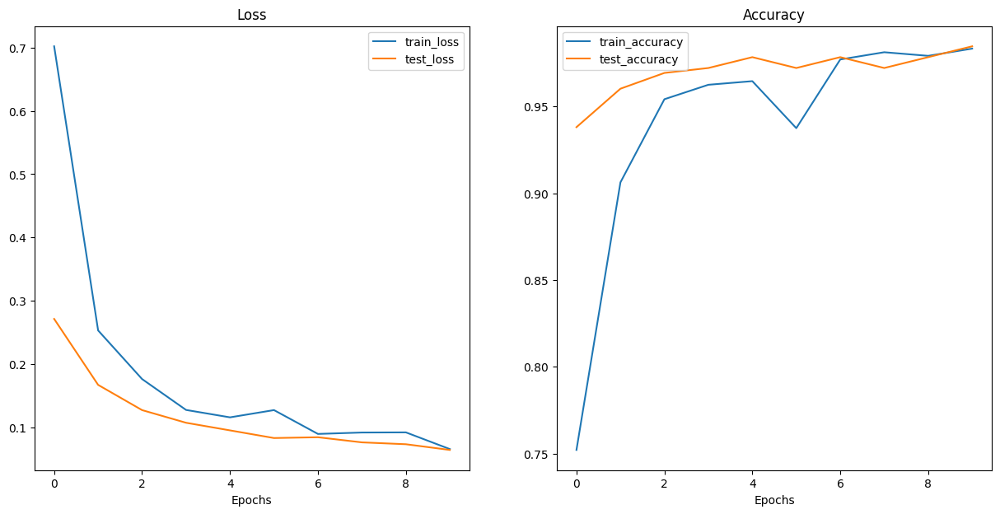

In [185]:
# Display and inspect the model's loss curves
plot_loss_curves(vit_results)

The loss curves are indicative of effective training. As with the 'EffNetB2' model, extending the training period and employing data augmentation could improve the 'ViT' model's performance by reducing the risk of **overfitting**.

Let's now proceed to saving the model:

In [186]:
# Save the ViT model
utils.save_model(model=vit,
                 target_dir="models",
                 model_name="pretrained_vit_feature_extractor_20_percent.pth")

[INFO] Saving model to: models/pretrained_vit_feature_extractor_20_percent.pth


### ViT Model File (Storage) Size Examination

In [187]:
# Claculate and print the ViT model's size in megabytes
pretrained_vit_model_size = Path("models/pretrained_vit_feature_extractor_20_percent.pth").stat().st_size // (1024*1024)
print(f"Pretrained ViT feature extractor model size: {pretrained_vit_model_size} MB")

Pretrained ViT feature extractor model size: 327 MB


In [188]:
# Calculate and display the number of parameters in the ViT model
vit_total_params = sum(torch.numel(param) for param in vit.parameters())
vit_total_params

85800963

In [189]:
# Create a dictionary with ViT model's statistics, and display it
vit_stats = {"test_loss": vit_results["test_loss"][-1],
             "test_acc": vit_results["test_acc"][-1],
             "number_of_parameters": vit_total_params,
             "model_size (MB)": pretrained_vit_model_size}
vit_stats

{'test_loss': 0.06443451717495918,
 'test_acc': 0.984659090909091,
 'number_of_parameters': 85800963,
 'model_size (MB)': 327}

### Executing, Timing and Comparing Predictions with Trained Models

When deploying the model, predictions will typically be made on one image at a time, such as when a user takes a photo and requests a prediction. Therefore, we'll time predictions **individually** rather than in batches.

To facilitate predictions across all test set images, let's first compile a list of all test image paths:

In [190]:
# Retrieve all the test data paths
print(f"Finding all filepaths ending with '.jpg' in directory: {test_dir}")
test_data_paths = list(Path(test_dir).glob("*/*.jpg"))
test_data_paths[:5]

Finding all filepaths ending with '.jpg' in directory: data/pizza_steak_sushi_20_percent/test


[PosixPath('data/pizza_steak_sushi_20_percent/test/sushi/511818.jpg'),
 PosixPath('data/pizza_steak_sushi_20_percent/test/sushi/2743100.jpg'),
 PosixPath('data/pizza_steak_sushi_20_percent/test/sushi/167716.jpg'),
 PosixPath('data/pizza_steak_sushi_20_percent/test/sushi/3886015.jpg'),
 PosixPath('data/pizza_steak_sushi_20_percent/test/sushi/128616.jpg')]

We will create a function named 'pred_and_store()' to iterate over each image in the test dataset individually, perform predictions and time each prediction. The results will be stored in a list of dictionaries, where each dictionary corresponds to a single prediction:


In [191]:
def pred_and_store(paths: List[pathlib.Path],
                   model: torch.nn.Module,
                   transform: torchvision.transforms,
                   class_names: List[str],
                   device: str = "cuda" if torch.cuda.is_available() else "cpu") -> List[Dict]:
    # Define an empty list for storing the prediction dictionaires
    pred_list = []

    # Loop through the target paths
    for path in tqdm(paths):
        # Define an empty dictionary for storing prediction info for each sample
        pred_dict = {}

        # Retrieve the sample path
        pred_dict["image_path"] = path
        # Retrieve the ground truth class name
        class_name = path.parent.stem
        pred_dict["class_name"] = class_name

        # Begin the prediction's timer
        start_time = timer()

        # Opening the image
        img = Image.open(path)

        # Apply the needed transform on the image, add a batch dimension and set it on the target device
        transformed_image = transform(img).unsqueeze(0).to(device)

        # Set the model on the device
        model.to(device)

        # Set the model in evaluation mode
        model.eval()

        # Activate the infernece mode
        with torch.inference_mode():
            # Pass the transformed image to the model to predict on it
            pred_logit = model(transformed_image)
            # Transform the logits (model's output) to prediction probabilities
            pred_prob = torch.softmax(pred_logit, dim=1)
            # Transform the prediction probabilities to prediction label
            pred_label = torch.argmax(pred_prob, dim=1)
            # Set the prediction class to be on CPU
            pred_class = class_names[pred_label.cpu()]

            # Make sure the dictionary cintent is on the CPU since its required for inspecting predictions later on
            pred_dict["pred_prob"] = round(pred_prob.unsqueeze(0).max().cpu().item(), 4)
            pred_dict["pred_class"] = pred_class

            # End the prediction's timer and calculate the time per prediction
            end_time = timer()
            pred_dict["time_for_pred"] = round(end_time-start_time, 4)

        # Check out whether or not the prediction matches to the true label
        pred_dict["correct"] = class_name == pred_class

        # Adding the dictionary to the list of preds
        pred_list.append(pred_dict)

    return pred_list

##### Executing and Timing Predictions with the EffNetB2 Model

In [192]:
# Making and timing predictions cross test dataset with the EffNetB2 Model
effnetb2_test_pred_dicts = pred_and_store(paths=test_data_paths,
                                          model=effnetb2,
                                          transform=effnetb2_transforms,
                                          class_names=class_names,
                                          device="cpu")

# Display the first 5 prediction dictionaries
effnetb2_test_pred_dicts[:5]

  0%|          | 0/150 [00:00<?, ?it/s]

[{'image_path': PosixPath('data/pizza_steak_sushi_20_percent/test/sushi/511818.jpg'),
  'class_name': 'sushi',
  'pred_prob': 0.6069,
  'pred_class': 'sushi',
  'time_for_pred': 0.1377,
  'correct': True},
 {'image_path': PosixPath('data/pizza_steak_sushi_20_percent/test/sushi/2743100.jpg'),
  'class_name': 'sushi',
  'pred_prob': 0.9171,
  'pred_class': 'sushi',
  'time_for_pred': 0.0999,
  'correct': True},
 {'image_path': PosixPath('data/pizza_steak_sushi_20_percent/test/sushi/167716.jpg'),
  'class_name': 'sushi',
  'pred_prob': 0.4836,
  'pred_class': 'sushi',
  'time_for_pred': 0.084,
  'correct': True},
 {'image_path': PosixPath('data/pizza_steak_sushi_20_percent/test/sushi/3886015.jpg'),
  'class_name': 'sushi',
  'pred_prob': 0.9504,
  'pred_class': 'sushi',
  'time_for_pred': 0.0817,
  'correct': True},
 {'image_path': PosixPath('data/pizza_steak_sushi_20_percent/test/sushi/128616.jpg'),
  'class_name': 'sushi',
  'pred_prob': 0.9492,
  'pred_class': 'sushi',
  'time_for_pred

In [193]:
# Transforming the test predictions dictionary into a Pandas DataFrame
effnetb2_test_pred_df = pd.DataFrame(effnetb2_test_pred_dicts)

# Display the first 5 rows of the dataframe
effnetb2_test_pred_df.head()

,image_path,class_name,pred_prob,pred_class,time_for_pred,correct
0,data/pizza_steak_sushi_20_percent/test/sushi/5...,sushi,0.6069,sushi,0.1377,True
1,data/pizza_steak_sushi_20_percent/test/sushi/2...,sushi,0.9171,sushi,0.0999,True
2,data/pizza_steak_sushi_20_percent/test/sushi/1...,sushi,0.4836,sushi,0.0840,True
3,data/pizza_steak_sushi_20_percent/test/sushi/3...,sushi,0.9504,sushi,0.0817,True
4,data/pizza_steak_sushi_20_percent/test/sushi/1...,sushi,0.9492,sushi,0.0821,True


In [194]:
# Check out and display the number of correct predictions
effnetb2_test_pred_df.correct.value_counts()

correct
True     144
False      6
Name: count, dtype: int64

In [195]:
# Calculate and display the average time per prediction
effnetb2_average_time_per_pred = round(effnetb2_test_pred_df.time_for_pred.mean(), 4)
print(f"EffNetB2 average time per prediction: {effnetb2_average_time_per_pred} seconds")

EffNetB2 average time per prediction: 0.0957 seconds


In [196]:
# Adding the EffNetB2 average prediction time to the stats dictionary
effnetb2_stats["time_per_pred_cpu"] = effnetb2_average_time_per_pred

# Display the updated EffNetB2 stats dictionary
effnetb2_stats

{'test_loss': 0.28108686208724976,
 'test_acc': 0.9625,
 'number_of_parameters': 7705221,
 'model_size (MB)': 29,
 'time_per_pred_cpu': 0.0957}

##### Executing and Timing Predictions with the ViT Model

In [197]:
# Making and timing predictions cross test dataset with the ViT Model
vit_test_pred_dicts = pred_and_store(paths=test_data_paths,
                                     model=vit,
                                     transform=vit_transforms,
                                     class_names=class_names,
                                     device="cpu")
# Display the first 5 prediction dictionaries
vit_test_pred_dicts[:5]

  0%|          | 0/150 [00:00<?, ?it/s]

[{'image_path': PosixPath('data/pizza_steak_sushi_20_percent/test/sushi/511818.jpg'),
  'class_name': 'sushi',
  'pred_prob': 0.9895,
  'pred_class': 'sushi',
  'time_for_pred': 0.5448,
  'correct': True},
 {'image_path': PosixPath('data/pizza_steak_sushi_20_percent/test/sushi/2743100.jpg'),
  'class_name': 'sushi',
  'pred_prob': 0.9963,
  'pred_class': 'sushi',
  'time_for_pred': 0.387,
  'correct': True},
 {'image_path': PosixPath('data/pizza_steak_sushi_20_percent/test/sushi/167716.jpg'),
  'class_name': 'sushi',
  'pred_prob': 0.6123,
  'pred_class': 'sushi',
  'time_for_pred': 0.3766,
  'correct': True},
 {'image_path': PosixPath('data/pizza_steak_sushi_20_percent/test/sushi/3886015.jpg'),
  'class_name': 'sushi',
  'pred_prob': 0.9441,
  'pred_class': 'sushi',
  'time_for_pred': 0.3779,
  'correct': True},
 {'image_path': PosixPath('data/pizza_steak_sushi_20_percent/test/sushi/128616.jpg'),
  'class_name': 'sushi',
  'pred_prob': 0.9876,
  'pred_class': 'sushi',
  'time_for_pred

In [198]:
# Transforming the test predictions dictionary into a Pandas DataFrame
vit_test_pred_df = pd.DataFrame(vit_test_pred_dicts)

# Display the first 5 rows of the dataframe
vit_test_pred_df.head()

,image_path,class_name,pred_prob,pred_class,time_for_pred,correct
0,data/pizza_steak_sushi_20_percent/test/sushi/5...,sushi,0.9895,sushi,0.5448,True
1,data/pizza_steak_sushi_20_percent/test/sushi/2...,sushi,0.9963,sushi,0.3870,True
2,data/pizza_steak_sushi_20_percent/test/sushi/1...,sushi,0.6123,sushi,0.3766,True
3,data/pizza_steak_sushi_20_percent/test/sushi/3...,sushi,0.9441,sushi,0.3779,True
4,data/pizza_steak_sushi_20_percent/test/sushi/1...,sushi,0.9876,sushi,0.3773,True


In [199]:
# Check out and display the number of correct predictions
vit_test_pred_df.correct.value_counts()

correct
True     148
False      2
Name: count, dtype: int64

In [200]:
# Calculate and display the average time per prediction
vit_average_time_per_pred = round(vit_test_pred_df.time_for_pred.mean(), 4)
print(f"ViT average time per prediction: {vit_average_time_per_pred} seconds")

ViT average time per prediction: 0.4145 seconds


In [201]:
# Adding the ViT average prediction time to the stats dictionary
vit_stats["time_per_pred_cpu"] = vit_average_time_per_pred

# Display the updated ViT stats dictionary
vit_stats

{'test_loss': 0.06443451717495918,
 'test_acc': 0.984659090909091,
 'number_of_parameters': 85800963,
 'model_size (MB)': 327,
 'time_per_pred_cpu': 0.4145}

#### Comparing Models Performance, Prediction Durations and Sizes

In [202]:
# Transform the effnetb2 and ViT stat dictionaries into 1 Pandas DataFrame
df = pd.DataFrame([effnetb2_stats, vit_stats])

# Adding a column for displaying the models names
df["model"] = ["EffNetB2", "ViT"]

# Convert the accuracy to percentages
df["test_acc"] = round(df["test_acc"] * 100, 2)

# Display the dataframe
df

,test_loss,test_acc,number_of_parameters,model_size (MB),time_per_pred_cpu,model
0,0.281087,96.25,7705221,29,0.0957,EffNetB2
1,0.064435,98.47,85800963,327,0.4145,ViT


While the models have similar overall test accuracy, we need to evaluate their performance across other metrics to determine the best option:



In [203]:
# Compare the ViT to the EffNetB2 model across different characteristics. Dividing the ViT statistics by the EffNetB2 statistics
pd.DataFrame(data=(df.set_index("model").loc["ViT"] / df.set_index("model").loc["EffNetB2"]),
             columns=["ViT to EffNetB2 ratios"]).T

,test_loss,test_acc,number_of_parameters,model_size (MB),time_per_pred_cpu
ViT to EffNetB2 ratios,0.229233,1.023065,11.135432,11.275862,4.331243


The Vision Transformer (ViT) model surpasses the EfficientNetB2 (EffNetB2) model in performance metrics such as test loss and test accuracy. However, this superior performance comes with tradeoffs:
- Significantly more parameters
- Larger model size
- Longer prediction time per image

The conclusion is that although ViT excels in accuracy and loss metrics, EffNetB2 is faster and more compact. The decision hinges on whether these tradeoffs are acceptable. For our use case of deploying the model to a smaller device such as a mobile phone, the **EffNetB2 model is preferable due to its faster predictions and smaller size**, despite a slight reduction in performance.

#### Depicting the Performance-Speed Balance (Tradeoff)


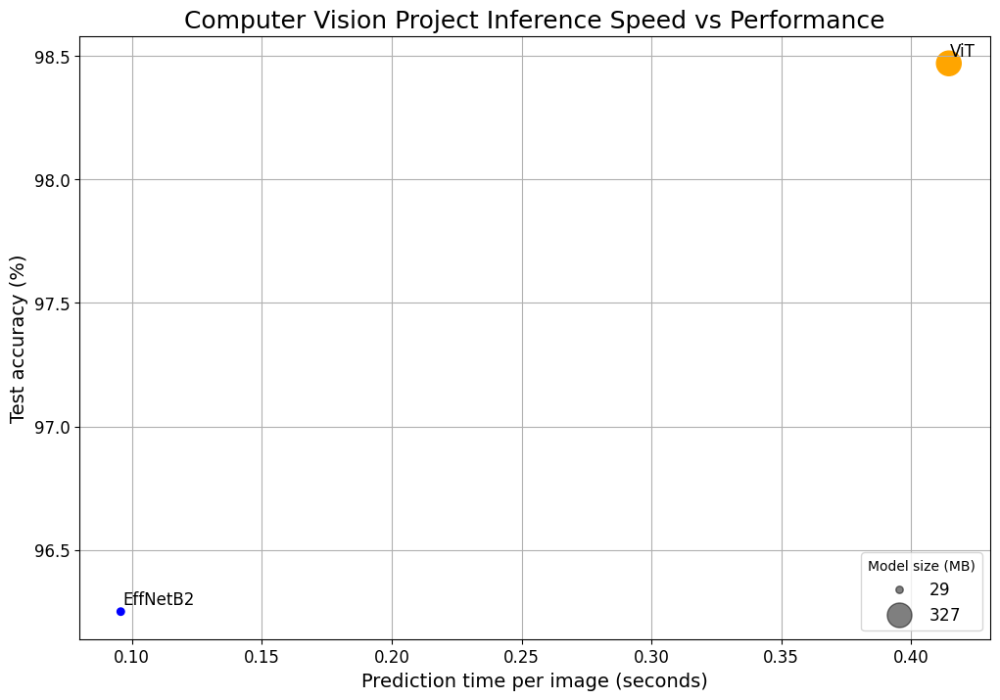

In [204]:
import os

# Create a plot from the model comparison DataFrame
fig, ax = plt.subplots(figsize=(12, 8))
scatter = ax.scatter(data=df,
                     x="time_per_pred_cpu",
                     y="test_acc",
                     c=["blue", "orange"],
                     s="model_size (MB)")

# Adding titles, labels and a customized fontsize to the plot
ax.set_title("Computer Vision Project Inference Speed vs Performance", fontsize=18)
ax.set_xlabel("Prediction time per image (seconds)", fontsize=14)
ax.set_ylabel("Test accuracy (%)", fontsize=14)
ax.tick_params(axis='both', labelsize=12)
ax.grid(True)

# Annotating with the models names
for index, row in df.iterrows():
    ax.annotate(text=row["model"],
                xy=(row["time_per_pred_cpu"]+0.0006, row["test_acc"]+0.03),
                size=12)

# Create the legend
handles, labels = scatter.legend_elements(prop="sizes", alpha=0.5)
model_size_legend = ax.legend(handles,
                              labels,
                              loc="lower right",
                              title="Model size (MB)",
                              fontsize=12)

# Saving and showing the figure
os.makedirs("images", exist_ok=True)
plt.savefig("images/computer-vision-project-inference-speed-vs-performance.jpg")
plt.show()

The plot illustrates the tradeoff between speed and performance. Larger models like ViT generally have higher latency due to their size and complexity. Although advancements in research aim to optimize larger models for faster performance, its crucial to consider the deployment environment.

In our scenario, where **speed** is prioritized and performance differences are minimal, the EffNetB2 model is the better choice for deployment due to its faster inference and smaller footprint.


### Deploying the Optimal Model Using Gradio

In [205]:
# Import Gradio. Install it if doesn't exists, and print its current version
try:
    import gradio as gr
except:
    !pip -q install gradio
    import gradio as gr

print(f"Gradio version: {gr.__version__}")

  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 50.4/50.4 kB 4.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 12.4/12.4 MB 88.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 318.2/318.2 kB 27.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 75.6/75.6 kB 7.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 77.9/77.9 kB 7.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 141.1/141.1 kB 12.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 10.1/10.1 MB 101.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 62.8/62.8 kB 5.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 92.2/92.2 kB 8.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 58.3/58.3 kB 4.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 71.9/71.9 kB 6.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 129.9/129.9 kB 11.4 MB/s eta 0:00:00
   ━━━━━━

In order to create the project demo with 'Gradio' we have to develop a function named 'predict()' that processes a **single image**, as opposed to a list of images, unlike the previously created 'pred_and_store()' function. This function should preprocess the image, make a prediction using the 'EfficientNetB2' (EffNetB2) model, and return both the prediction label and the prediction probability.

First and foremost, let's ensure that the EffNetB2 model operates on the CPU since we're sticking with CPU-only predictions (although adjustments can be made for GPU utilization if available):


In [206]:
# Set the EffNetB2 model on the CPU
effnetb2.to("cpu")

# Checking out the device
next(iter(effnetb2.parameters())).device

device(type='cpu')

In [207]:
def predict(img) -> Tuple[Dict, float]:
    """This function transforms and performs a prediction on an image, and returns
    the prediction and time taken.

    Returns: the prediction dictionary and prediction time.
    """
    # Begin the prediction's timer
    start_time = timer()

    # Apply the transform on the target image, and add a batch dimension
    img = effnetb2_transforms(img).unsqueeze(0)

    # Set the model in evaluation mode
    effnetb2.eval()

    # Activate the inference mode
    with torch.inference_mode():
        # Pass the transformed image through the model, and transform the prediction logits into prediction probabilities
        pred_probs = torch.softmax(effnetb2(img), dim=1)

    # Creating a prediction label and prediction probability dictionary for each prediction class
    pred_labels_and_probs = {class_names[i]: float(pred_probs[0][i]) for i in range(len(class_names))}

    # Calculate the prediction time
    pred_time = round(timer() - start_time, 5)

    return pred_labels_and_probs, pred_time

Validating the 'predict()' function by executing a prediction on a randomly selected image from the test set to confirm its accuracy and functionality:

In [208]:
# Retrieve the list of all the test image filepaths
test_data_paths = list(Path(test_dir).glob("*/*.jpg"))

# Randomly select a test image path
random_image_path = random.sample(test_data_paths, k=1)[0]

# Open the target image
image = Image.open(random_image_path)
print(f"Predicting on image at path: {random_image_path}\n")

# Predict on the target image, and print the prediction label and probability dictionary as well as the prediction time
pred_dict, pred_time = predict(img=image)
print(f"Prediction label and probability dictionary: \n{pred_dict}")
print(f"Prediction time: {pred_time} seconds")

Predicting on image at path: data/pizza_steak_sushi_20_percent/test/steak/2756200.jpg

Prediction label and probability dictionary: 
{'pizza': 0.036674614995718, 'steak': 0.9252777695655823, 'sushi': 0.038047581911087036}
Prediction time: 0.15412 seconds


Let's construct a list of examples, formatted as a **list of lists**, containing random file paths to test images. This is necessary because Gradio's Interface class accepts an optional parameter examples in the format of 'gr.Interface(examples=List[Any])':

In [211]:
# Create a list of example inputs for the Gradio demo
example_list = [[str(filepath)] for filepath in random.sample(test_data_paths, k=3)]

# Dispay the list of example
example_list

[['data/pizza_steak_sushi_20_percent/test/steak/3100563.jpg'],
 ['data/pizza_steak_sushi_20_percent/test/sushi/2743100.jpg'],
 ['data/pizza_steak_sushi_20_percent/test/sushi/301603.jpg']]

We can now proceed to creating the Gradio interface using the prepared components and examples:

In [212]:
# Define the title
title = "DishVision - Multi Class Food Image Classifier"
# Define the description
description = "An EfficientNetB2-based transfer learning model for feature extraction in computer vision, designed to classify images into three distinct food categories."
# Define the article
article = "Computer Vision Project"

# Create the Gradio demo
demo = gr.Interface(fn=predict,
                    inputs=gr.Image(type="pil"),
                    outputs=[gr.Label(num_top_classes=3, label="Predictions"),
                             gr.Number(label="Prediction time (s)")],
                    examples=example_list,
                    title=title,
                    description=description,
                    article=article)

# Launching the Gradio demo
demo.launch(debug=False,
            share=True)

Colab notebook detected. To show errors in colab notebook, set debug=True in launch()
Running on public URL: https://81f7f1fdaa849222f9.gradio.live

This share link expires in 72 hours. For free permanent hosting and GPU upgrades, run `gradio deploy` from Terminal to deploy to Spaces (https://huggingface.co/spaces)


**Note:** The Gradio demo link is temporary and expires after 72 hours. To ensure the project demo remains accessible, let's package it into an app and upload it to 'Hugging Face Spaces' for permanent hosting (in the following section).

### Deploying the Optimal Model on Hugging Face Spaces

To upload the demo Gradio app to Hugging Face Spaces, it is essential to organize all related files into a single directory. For instance, use the path 'demos/computer_vision_project/' to maintain a straightforward and coherent file structure.

Therefore, let's begin by creating the demos folder:



In [213]:
import shutil

# Define the mini computer vision project demo path
project_demo_path = Path("demos/computer_vision_project/")

# Removing all the files that might already exist there, and creating a new directory
if project_demo_path.exists():
    shutil.rmtree(project_demo_path)
    project_demo_path.mkdir(parents=True,
                                 exist_ok=True)
else:
    # If the file doesn't exist, create it anyway
    project_demo_path.mkdir(parents=True,
                                    exist_ok=True)

# Display the folder's content
!ls demos/computer_vision_project/

With the directory in place to store the project's demo files, we can proceed to add relevant examples to it:

In [214]:
# Define the "examples" directory
project_examples_path = project_demo_path / "examples"
project_examples_path.mkdir(parents=True, exist_ok=True)

# Collect 3 random image paths from the test dataset
project_examples = [
    Path('data/pizza_steak_sushi_20_percent/test/sushi/592799.jpg'),
    Path('data/pizza_steak_sushi_20_percent/test/steak/3622237.jpg'),
    Path('data/pizza_steak_sushi_20_percent/test/pizza/2582289.jpg')
]

# Copy the 3 random images to the "examples" directory
for example in project_examples:
    if not example.is_file():
        print(f"File not found: {example}")
    else:
        destination = project_examples_path / example.name
        print(f"Copying {example} to {destination}")
        shutil.copy2(src=example, dst=destination)

Copying data/pizza_steak_sushi_20_percent/test/sushi/592799.jpg to demos/computer_vision_project/examples/592799.jpg
Copying data/pizza_steak_sushi_20_percent/test/steak/3622237.jpg to demos/computer_vision_project/examples/3622237.jpg
Copying data/pizza_steak_sushi_20_percent/test/pizza/2582289.jpg to demos/computer_vision_project/examples/2582289.jpg


In [215]:
# Let's verify that the "examples" are present by retrieving the "example" filepaths in a list of lists and displying it
example_list = [["examples/" + example] for example in os.listdir(project_examples_path)]
example_list

[['examples/3622237.jpg'], ['examples/592799.jpg'], ['examples/2582289.jpg']]

The project’s EffNetB2 feature extractor model, previously saved under 'models/pretrained_effnetb2_feature_extractor_20_percent.pth', should be moved to avoid duplicating saved model files.

Hence, let's transfer this model to the 'demos/computer_vision_project' directory:

In [216]:
# Define a source path for the target model
effnetb2_project_model_path = "models/pretrained_effnetb2_feature_extractor_20_percent.pth"

# Define a destination path for the target model
effnetb2_project_model_destination = project_demo_path / effnetb2_project_model_path.split("/")[1]

# Trying to move the file
try:
    print(f"Attempting to move {effnetb2_project_model_path} to {effnetb2_project_model_destination}")

    # Moving the model
    shutil.move(src=effnetb2_project_model_path,
                dst=effnetb2_project_model_destination)

    print(f"Model move complete.")

# If the model has already been moved, then check if it exists
except:
    print(f"No model found at {effnetb2_project_model_path}, perhaps its already been moved.")
    print(f"Model exists at {effnetb2_project_model_destination}: {effnetb2_project_model_destination.exists()}")

Attempting to move models/pretrained_effnetb2_feature_extractor_20_percent.pth to demos/computer_vision_project/pretrained_effnetb2_feature_extractor_20_percent.pth
Model move complete.


We would like to convert the EffNetB2 model into a Python script named 'model.py'. Thus, let's copy and paste the 'create_effnetb2_model()' function we have created earlier, along with the necessary imports, into this script, which initializes the EffNetB2 model, and use the '%%writefile demos/computer_vision_project/model.py' command to save the script:




In [217]:
%%writefile demos/computer_vision_project/model.py
import torch
import torchvision
from torch import nn


def create_effnetb2_model(num_classes:int=3,
                          seed:int=42):
    """This function creates an EfficientNetB2 feature extractor model and transforms.

    Args:
        num_classes (int, optional): number of classes in the classifier head.
            Defaults to 3.
        seed (int, optional): random seed value. Defaults to 42.

    Returns:
        model (torch.nn.Module): EffNetB2 feature extractor model.
        transforms (torchvision.transforms): EffNetB2 image transforms.
    """
    # Get the pretrained 'efficientnet_b2' model's weights
    weights = torchvision.models.EfficientNet_B2_Weights.DEFAULT
    # Get the pretrained 'efficientnet_b2' model's transforms
    transforms = weights.transforms()
    # Set up the pretrained 'efficientnet_b2' model
    model = torchvision.models.efficientnet_b2(weights=weights)

    # Freeze the base layers in the 'efficientnet_b2' model (for Feature Extraction)
    for param in model.parameters():
        param.requires_grad = False

    # Set the torch manual seed
    torch.manual_seed(seed)

    # Update the classifier head to suit to our problem
    model.classifier = nn.Sequential(
        nn.Dropout(p=0.3, inplace=True),
        nn.Linear(in_features=1408, out_features=num_classes),
    )

    return model, transforms

Writing demos/computer_vision_project/model.py


With the 'model.py' script and the path to the saved model’s 'state_dict', the next step is to create the 'app.py' script. This script will integrate all components to build the Gradio demo:


In [221]:
%%writefile demos/computer_vision_project/app.py
import gradio as gr
import os
import torch
from model import create_effnetb2_model
from timeit import default_timer as timer
from typing import Tuple, Dict


# Define the class names
class_names = ["pizza", "steak", "sushi"]

# Create the pretrained EffNetB2 model
effnetb2, effnetb2_transforms = create_effnetb2_model(
    num_classes=3,
)

# Load to the CPU the EffNetB2 model's saved weights
effnetb2.load_state_dict(
    torch.load(
        f="pretrained_effnetb2_feature_extractor_20_percent.pth",
        map_location=torch.device("cpu"),
    )
)


def predict(img) -> Tuple[Dict, float]:
    """This function transforms and performs a prediction on an image, and returns
    the prediction and time taken.

    Returns: the prediction dictionary and prediction time.
    """
    # Begin the prediction's timer
    start_time = timer()

    # Transform the target image with the pretrained EffNetB2 model's transforms, and add a batch dimension
    img = effnetb2_transforms(img).unsqueeze(0)

    # Set the model to evaluation model
    effnetb2.eval()

    # Activate the inference mode
    with torch.inference_mode():
        # Pass the transformed image through the model, and transform the prediction logits (the model's outputs) into prediction probabilities
        pred_probs = torch.softmax(effnetb2(img), dim=1)

    # Create a prediction label and prediction probability dictionary for each prediction class
    pred_labels_and_probs = {class_names[i]: float(pred_probs[0][i]) for i in range(len(class_names))}

    # Calculating the prediction's time
    pred_time = round(timer() - start_time, 5)

    return pred_labels_and_probs, pred_time


# Define the title
title = "DishVision - Multi Class Food Image Classifier"
# Define the description
description = "An EfficientNetB2-based transfer learning model for feature extraction in computer vision, designed to classify images into three distinct food categories."
# Define the article
article = "Computer Vision Project"

# Create the "examples" list from "examples/" directory
example_list = [["examples/" + example] for example in os.listdir("examples")]

# Create the Gradio deom interface
demo = gr.Interface(fn=predict,
                    inputs=gr.Image(type="pil"),
                    outputs=[gr.Label(num_top_classes=3, label="Predictions"),
                             gr.Number(label="Prediction time (s)")],
                    examples=example_list,
                    title=title,
                    description=description,
                    article=article)

demo.launch(share=True)

Writing demos/computer_vision_project/app.py


The final file required for this computer vision project app is 'requirements.txt', which lists all dependencies necessary for the demo. When deploying the app to Hugging Face Spaces, this file will be used to automatically install the specified dependencies.

Let's create this file to ensure all requirements are met:

In [222]:
%%writefile demos/computer_vision_project/requirements.txt
torch==2.0.1
torchvision==0.15.2
gradio==4.38.1
numpy<2.0.0

Writing demos/computer_vision_project/requirements.txt


Downloading the computer vision project app files from Google Colab:

In [223]:
# Zip the "computer_vision_project" folder, and exclude unnecessarily files
!cd demos/computer_vision_project && zip -r ../computer_vision_project.zip * -x "*.pyc" "*.ipynb" "*__pycache__*" "*ipynb_checkpoints*"

# Downloading the zipped mini computer vision project app
try:
    from google.colab import files
    files.download("demos/computer_vision_project.zip")
except:
    print("Not running in Google Colab, can't use google.colab.files.download(). Please download manually.")

  adding: app.py (deflated 58%)
  adding: examples/ (stored 0%)
  adding: examples/3622237.jpg (deflated 0%)
  adding: examples/592799.jpg (deflated 1%)
  adding: examples/2582289.jpg (deflated 17%)
  adding: model.py (deflated 58%)
  adding: pretrained_effnetb2_feature_extractor_20_percent.pth (deflated 8%)
  adding: requirements.txt (deflated 8%)


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Finally, uploading the organized project directory to Hugging Face Spaces to deploy the demo app:

In [1]:
from IPython.display import display, HTML

# Define the link to the Hugging Face Space
link = "https://huggingface.co/spaces/IsraelAzoulay/DishVision"

# Display the clickable link in the Colab notebook
display(HTML(f'<a href="{link}" target="_blank">Click here to access the DishVision Gradio App</a>'))

## Conclusion

**Achieving a Robust Deep Learning Computer Vision PyTorch Model:**

Through rigorous experimentation and leveraging the power of transfer learning, a robust deep learning computer vision model in PyTorch for food image classification of three classes was developed, achieving an impressive **96+%** accuracy. This accomplishment underscores the effectiveness of transfer learning with pre-trained models in enhancing model performance, even with limited data and training time. Furthermore, the methodology can be easily scaled up to handle more classes and even more extensive datasets, demonstrating its scalability and adaptability to larger and more complex tasks.


**Key Takeaways:**

**1. Dataset Preparation and Utilization:**

In different modeling experiments, varying amounts of the original dataset were used. The dataset was initially preprocessed in a separate notebook titled 'Structuring_the_Food101_Dataset'. This systematic preparation ensured that experiments were conducted on well-structured data, allowing exploration of the effects of data volume on model performance.

**2. Preprocessing the Data:**

The preprocessing step is crucial in any machine learning pipeline, especially for image data. In this notebook, the 'ImageFolder' class was utilized for efficient data loading and custom datasets for tailored data handling. Transforms were employed for effective image preprocessing, ensuring compatibility with the models. Notably, 'transforms.TrivialAugmentWide()' was used for the TinyVGG architecture to apply data augmentation, although it did not significantly enhance model performance in this case. Data augmentation remains a powerful technique to improve model generalization by increasing training data variability.

**3. Modularity and Helper Functions:**

The importance of modularizing code into Python scripts and utilizing helper functions was emphasized. This approach enhances code readability, maintainability, and reusability across different projects. By creating separate scripts for data loading, model building, training, and evaluation, best practices in software engineering were followed, making the project more scalable and easier to manage.

**4. Replicating the TinyVGG Class:**

The TinyVGG class architecture was replicated, providing a baseline model. Despite its simplicity and modest performance, it served as a valuable tool for understanding convolutional neural networks (CNNs) and gaining insights into model architecture and performance tuning.

**5. Vision Transformer (ViT) Implementations - Machine Learning Research Paper Replication:**

Vision Transformer (ViT) models were explored, replicating their architecture manually and using PyTorch’s built-in functions. Despite the implementation resulting in underfitting, the original ViT architecture demonstrates superior performance on various image classification benchmarks. The disparity in results is attributed to differences in data volume and training regimes. Our outcomes were suboptimal due to the limited scale of data and shorter training duration.

**6. Transfer Learning and Feature Extraction:**

The power of transfer learning feature extraction was harnessed using three advanced models - EfficientNetB0, EfficientNetB2, and the ViT Computer Vision Transformer. Transfer learning significantly boosted the model's performance by leveraging pre-trained weights from extensive datasets, demonstrating its efficiency and practicality in real world applications.

**7. Evaluation and Monitoring:**

Throughout all steps, thorough evaluations were conducted using the modular scripts and performance was visually monitored with TensorBoard. This continuous evaluation allowed tracking of progress, diagnosis of issues, and informed adjustments to improve model accuracy and efficiency.

**8. Model Storage Size and Deployment Considerations:**

Examining model storage size is critical for deployment. Models' performance and speed were evaluated to balance accuracy and computational efficiency. Optimizing models for both performance and deployment feasibility is essential, especially in resource-constrained environments where speed and storage are limiting factors.

**9. Model Deployment with Gradio and Hugging Face Spaces:**

The use of Gradio and Hugging Face Spaces for model deployment was demonstrated. These platforms provide user-friendly interfaces and seamless integration for deploying machine learning models. Gradio facilitates the quick creation of interactive web interfaces, while Hugging Face Spaces offers a collaborative environment for hosting and managing models, enhancing deployment and continuous improvement.

---

**Final Thoughts:**

This notebook encapsulates a comprehensive journey through various stages of a machine learning pipeline, from data preprocessing and model training to deployment. By following a modular approach and leveraging advanced techniques such as transfer learning and vision transformers, the importance of flexibility, efficiency, and scalability in machine learning projects is illustrated. These practices are essential for building robust, high performance models ready for real world applications. The approach can be easily scaled up to handle larger and more complex datasets, further showcasing its adaptability and potential for broader applications.

